# CAMELS Multifield Dataset

In this project you will analyse simulated datasets from the Cosmology and Astrophysics with MachinE Learning Simulations (CAMELS) Multifield Dataset, CMD, to attempt to determine the fundamental parameters of the universe.

The CAMELS CMD simualted dataset is enormous so in this project we will only be using one small corner of the simulated data. You can find more details on the overall [CAMELS Multifield Dataset in their paper on arxiv](https://arxiv.org/abs/2109.10915).


## Cosmological parameters

Each map in the dataset comes from a simulation which is controlled by six parameters. Two of these are interesting cosmological parameters that we want to determine, whilst the other four parameters are effective parameters that we are less interested in but might need to consider to determine the interesting cosmological parameters.

| Variable      | Description |
| ----------- | ----------- |
| $\Omega_m$      | This is a cosmological parameter that represents the fraction of matter in the Universe.   |
| $\sigma_8$      | his is a cosmological parameter that controls the smoothness of the distribution of matter in the Universe  |
| $A_{SN1}$ & $A_{SN2}$     | These are two astrophysical parameters that controls two properties of supernova feedback  |
| $A_{AGN1}$ & $A_{AGN2}$     | These are two astrophysical parameters that control two properties of black-hole feedback|

## Types of 2D-Map

The simulated datasets are for a large number of astrophysical fields including

| Field   | Prefix   |
| ----------- | ---- |
| Gas density     | Mgas |
| Gas velocity    | Vgas |
| Gas temperature | T |
| Gas metallicity    | Z |
| Neutral hydrogen density    | HI |
| Electron number density    | ne |
| Magnetic fields   | B |
| Magnesium over Iron   | MgFe |
| Dark matter density  | Mcdm |
| Dark matter velocity  | Vcdm |
| Stellar mass density | Mstar |  
| Total matter density | Mtot |

There are several different types of datasets avalible deriving from different simulations and with different ways of varying the astrophysical parameters. In this miniproject we will confine ourselves to look only at the IllustrisTNG simulation where a single astrophysical parameter is varied at a time.

## Machine learning tasks

1. Train a machine learning algorithm to predict the cosmological parameters from a single map
2. Train a machine learning algorithm to predict the cosmological parameters from multiple maps (e.g. of different fields at the same time)


# PROJECT START

# 1. PREPROCESSING

## 1.1 Getting the data and investigating

In [3]:
# All the libraries needed
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm #Needed for plotting things on log scale
import scipy.ndimage

# TensorFlow and tf.keras
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models

# sklean for some preprocessing 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [4]:
# Getting the data
# import the urllib library
import urllib.request
import os


# Saving the names of all the different maps needed
labelFile='params_1P_IllustrisTNG.txt'
firstFile='Maps_B_IllustrisTNG_1P_z=0.00.npy'
File2='Maps_HI_IllustrisTNG_1P_z=0.00.npy'
File3='Maps_Mcdm_IllustrisTNG_1P_z=0.00.npy'
File4='Maps_Mgas_IllustrisTNG_1P_z=0.00.npy'
File5='Maps_MgFe_IllustrisTNG_1P_z=0.00.npy'
File6='Maps_Mstar_IllustrisTNG_1P_z=0.00.npy'
File7='Maps_Mtot_IllustrisTNG_1P_z=0.00.npy'
File8='Maps_ne_IllustrisTNG_1P_z=0.00.npy'
File9='Maps_T_IllustrisTNG_1P_z=0.00.npy'
File10='Maps_Vcdm_IllustrisTNG_1P_z=0.00.npy'
File11='Maps_Vgas_IllustrisTNG_1P_z=0.00.npy'
File12='Maps_Z_IllustrisTNG_1P_z=0.00.npy'
File13='Maps_P_IllustrisTNG_1P_z=0.00.npy'

def getFile(fileName):
    # Copy a network object to a local file

    urllib.request.urlretrieve('https://users.flatironinstitute.org/~fvillaescusa/priv/DEPnzxoWlaTQ6CjrXqsm0vYi8L7Jy/CMD/2D_maps/data/'+fileName, fileName)

if not os.path.isfile(firstFile):
    getFile(firstFile)

if not os.path.isfile(labelFile):
    getFile(labelFile)

In [5]:
# Loading all the data into numpy arrays
params=np.loadtxt(labelFile) # Simulation parameters
bMap=np.load(firstFile) 
HIMap=np.load(File2) 
McdmMap=np.load(File3)
MgasMap=np.load(File4)
MgFeMap=np.load(File5)
MstarMap=np.load(File6)
MtotMap=np.load(File7)
neMap=np.load(File8)
TMap=np.load(File9)
VcdmMap=np.load(File10)
VgasMap=np.load(File11)
ZMap=np.load(File12)
PMap=np.load(File13)

In [6]:
print(f'SHAPES OF MAPS:\nMagnetic Fields: {bMap.shape}\nNeutral Hydrogen density: {HIMap.shape}\nDark Matter Density: {McdmMap.shape}\nGas Density: {MgasMap.shape}\nMagnesium over Iron: {MgFeMap.shape}\nStellar Mass Density: {MstarMap.shape}\nTotal matter density: {MtotMap.shape}\nElectron Number Density: {neMap.shape}\nGas Temperature: {TMap.shape}\nDark Matter velocity: {VcdmMap.shape}\nGas Velocity: {VgasMap.shape}\nGas Metallicity: {ZMap.shape}\nGas Pressure: {PMap.shape}')

SHAPES OF MAPS:
Magnetic Fields: (990, 256, 256)
Neutral Hydrogen density: (990, 256, 256)
Dark Matter Density: (990, 256, 256)
Gas Density: (990, 256, 256)
Magnesium over Iron: (990, 256, 256)
Stellar Mass Density: (2100, 256, 256)
Total matter density: (990, 256, 256)
Electron Number Density: (990, 256, 256)
Gas Temperature: (990, 256, 256)
Dark Matter velocity: (990, 256, 256)
Gas Velocity: (990, 256, 256)
Gas Metallicity: (990, 256, 256)
Gas Pressure: (2100, 256, 256)


uh oh, Stellar mass density and gas pressure seem to have many more simulations than the other 11. For now let's discard these and focus on the other maps

params.shape (66, 6)
bMap.shape (990, 256, 256)
Maps per paramater line 15
Maxiumum Value 2.011384e-06
Minimum Value 1.8111102e-15


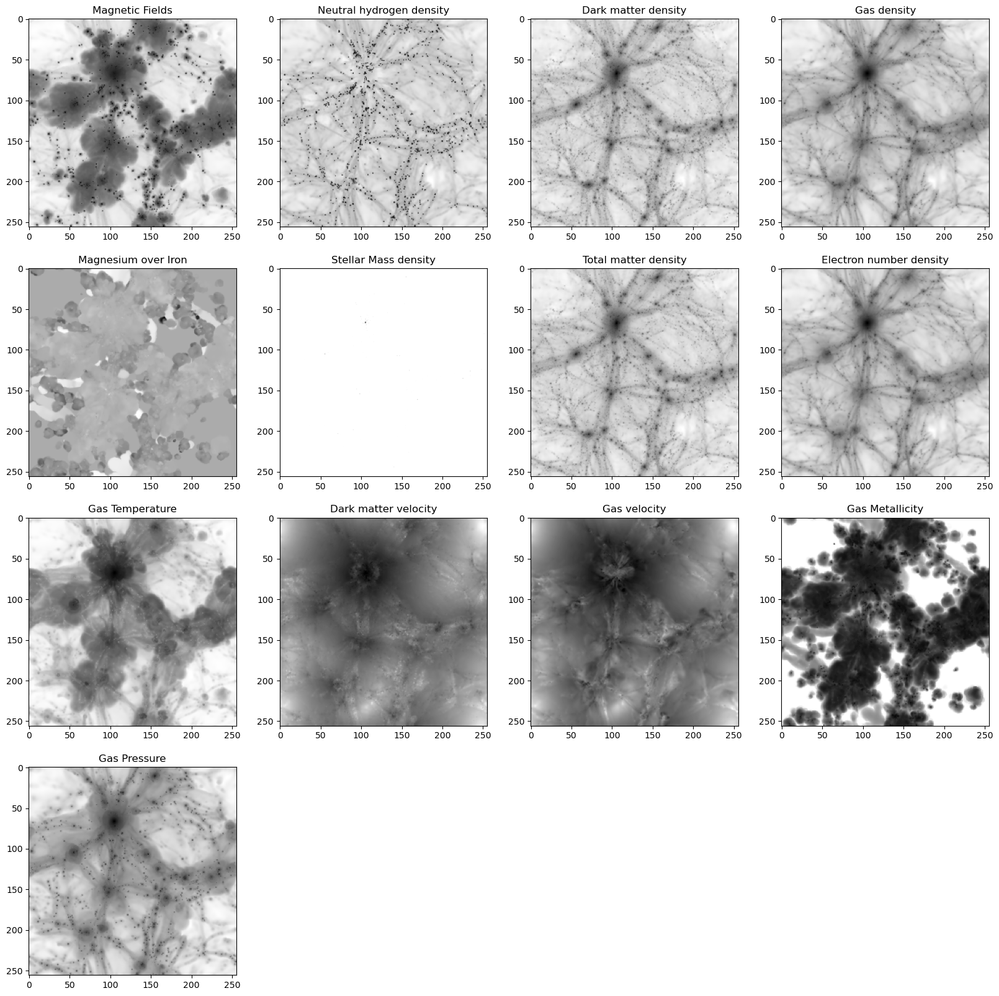

In [7]:
# Checking the shape of arrays and plotting an image from the same simulation
print("params.shape",params.shape)
print("bMap.shape",bMap.shape)
print("Maps per paramater line",bMap.shape[0]//params.shape[0])
print("Maxiumum Value",np.max(bMap[0]))
print("Minimum Value",np.min(bMap[0]))

def plot_images_one_sim(sim):
    fig, ax = plt.subplots(4,4, figsize = (20,20))

    ax[0,0].imshow(np.log10(bMap[sim]),cmap="binary")
    ax[0,0].set_title("Magnetic Fields")

    ax[0,1].imshow(np.log10(HIMap[sim]),cmap="binary")
    ax[0,1].set_title("Neutral hydrogen density")

    ax[0,2].imshow(np.log10(McdmMap[sim]),cmap="binary")
    ax[0,2].set_title("Dark matter density")

    ax[0,3].imshow(np.log10(MgasMap[sim]),cmap="binary")
    ax[0,3].set_title("Gas density")

    ax[1,0].imshow(np.log10(MgFeMap[sim]),cmap="binary")
    ax[1,0].set_title("Magnesium over Iron")

    ax[1,1].imshow(MstarMap[sim],cmap="binary")
    ax[1,1].set_title("Stellar Mass density")

    ax[1,2].imshow(np.log10(MtotMap[sim]),cmap="binary")
    ax[1,2].set_title("Total matter density")

    ax[1,3].imshow(np.log10(neMap[sim]),cmap="binary")
    ax[1,3].set_title("Electron number density")

    ax[2,0].imshow(np.log10(TMap[sim]),cmap="binary")
    ax[2,0].set_title("Gas Temperature")

    ax[2,1].imshow(np.log10(VcdmMap[sim]),cmap="binary")
    ax[2,1].set_title("Dark matter velocity")

    ax[2,2].imshow(np.log10(VgasMap[sim]),cmap="binary")
    ax[2,2].set_title("Gas velocity")

    ax[2,3].imshow(np.log10(ZMap[sim]),cmap="binary")
    ax[2,3].set_title("Gas Metallicity")

    ax[3,0].imshow(np.log10(PMap[sim]),cmap="binary")
    ax[3,0].set_title("Gas Pressure")

    fig.delaxes(ax[3, 1])
    fig.delaxes(ax[3, 2])
    fig.delaxes(ax[3, 3])

    plt.constrained_layout = True
    plt.savefig('All maps simulation 400')

plot_images_one_sim(400)

We can see that a lot of the maps share a similar spacial form as expected as a lot of the fields will have interdependencies. e.g total matter density and dark matter density are almost idential. We can see that the stellar mass density is very very faint, which may be as expected as stellar mass in the universe is small compared to e.g dark matter mass, however it still has dark spots that allign with the dark spots of the other maps. 

The only map that seems a bit out of place/ different is the Magnesium over Iron. This may lead to some interesting results.

In [281]:
# Combining all the maps that we want to use into one array - this will be used for looping over when testing on one field at a time.
# this will be of shape (11,990,256,256)
maps = np.array((bMap,HIMap,McdmMap,MgasMap,MgFeMap,MtotMap,neMap,TMap,VcdmMap,VgasMap,ZMap))

KeyboardInterrupt: 

In [11]:
maps.shape

(11, 990, 256, 256)

In [9]:
map_names = ['Magnetic Fields', 'Neutral Hydrogen Density', 'Dark Matter Density', 'Gas Density', 'Magnesium over Iron',
            'Total Matter Density', 'Electron Number Density', 'Gas Temperature', 'Dark Matter Velocity', 'Gas Velocity','Gas Metallicity']

In [10]:
# Combining all the maps that I want to use in the trainng - this will be used for training on all 11 maps
# this will be of shape (990,256,256,11)
combined_array = np.stack(maps, axis=-1)

In [12]:
# Checking that the shape of the big array that I am using is correct (number of images, width, height, number of maps)
combined_array.shape

(990, 256, 256, 11)

We have 66 different simulations in the IP suite, each with 15 different snapshots, hence we have 66*15 = 990 different maps.

The 15 snapshots from each simulation are split into 3 different dimesions, with 5 slices from each dimensions.

## 1.2 Data formatting and preprocessing

A conv2D layer takes inputs in the shape: (batch_size, height, width, channels)
So the input data will should have shape (number of training images, 256, 256, number of maps used) - this is how we reshaped the data above For using one map, the number of channels will be 1. 

In [16]:
# Let's define a function to smooth out our 2D grids to help the model learn general shapes, but not precise details.
# For this let's use scipy.ndimage.Gaussian_filter

# https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.gaussian_filter.html 
def smooth_data(grids, smoothing):
    '''
    This is a function which takes in a set of maps, and applies a gaussian filter to them to effectively blur the images. 
    This may help with model learning

    Args: 
        grids: a numpy array of the maps that we want to add the gaussian filter to
        smoothing: a float of the standard deviation of the Gaussian kernel
        
    Returns: 
        the maps inputted with a Gaussian filter applied
    '''
    smooth_grids = np.zeros(grids.shape)
    for i in range(grids.shape[0]):
        smooth_grids[i] = scipy.ndimage.gaussian_filter(grids[i], smoothing, mode = 'wrap')

    return smooth_grids

# Normalising Data
# the sklearn Standard Scaler normalises the data to have a mean of 0 and variance of 1
def normalise_data(data):
    '''
    This is a function which takes in a numpy array of maps, and normalises the data to a standard normal

    Args: 
        data: a numpy array of the maps that we wish to normalise

    Returns:
        the maps inputted but now standardised to a Standard Normal 
    '''
    scaler = StandardScaler()

    # Reshape data to 2D for scaling as StandardScaler takes 2D inputs only
    data_2D = data.reshape(data.shape[0], -1)  # Reshape to (990, 256*256*1)
    data_scaled = scaler.fit_transform(data_2D)

    # Reshape back to the original shape
    data = data_scaled.reshape(data.shape)  # Reshape back to (990, 256, 256, 1)

    return data

# Now let's add some noise to the images.

def add_noise(data, sigma):
    '''
    This is a function which adds noise from a normal distribution to the maps inputted

    Args: 
        data: a numpy array of the maps that we want to add noise to
        sigma: the standard deviation of the normal distribution that we are sampling the noise from

    Returns:
        The inputted maps but with noise added
    '''
    noise_matrix = np.random.normal(0,sigma,data.shape)
    return noise_matrix + data

Our lables currently have a batch size of 66 as they correspond to the 66 different simulations, however we have 15 images from each simulation, so our data is $66*15 = 990$ images long. So we need to extend this label list so that it matches the length of the data array.

In [17]:
# The np.repeat function repeats an element of an array after themselves 
# This is more efficient than a nested python list 

def extend_labels(labels):
    '''
    This is a function which extends the parameters list so that it matches the length of the data

    Args: 
        labels: A numpy array of the parameters for all the simulations

    Returns: 
        A numpy array of the parameters but extened to match the length of the data array
    '''
    return np.repeat(labels, 15, axis=0)

We now need to split our data into a training, validation, and testing set. We shall split the data into a training and testing set, and then later split the training data into a validation set during the training process as this is easy to do in the keras pipeline. We want the validation set to be representative of the testing data, so for now we will use a 60-20-20 split. So the training data will have 594 images, and the validaiton and the testing data will have 198 images each. This may be changed later to allow for more training data if needs be.

We also need to shuffle our data so that the model doesn't only train on a a certain number of simulations (as each simulation has 15 different snapshots in a row), and so that it doesn't learn any patterns from the order of the data. This is easy to do using scikit learn test_train_split() which has a shuffle function built in. Hence we can do these 2 steps in one go

In [18]:
def format_data(grids,parameters, smooth = False, sigma_smooth = 0, noise = False, 
                sigma_noise = 0, normalise = True, test_size = 0.25, random_state = 42):
    '''
    This is a function which formats the data how we wish by controlling certain parameters

    Args: 
        grids: A numpy array of the maps that we want to format
        parameters: A numpy array of the parameters (labels) that correspond to the maps
        smooth: A boolean which signals if we want to smooth the maps
        sigma_smooth: A float which gives the standard deviation of the Gaussian filter for smoothing
        noise: A boolean which signals if we want to add noise to the maps
        sigma_noise: A float which gives the standard deviation of the standard normal that we are sampling noise from
        normalise: A boolean which signals if we want to normalise the maps
        test_size: A float representing the amount of data out of 1 that we want in our testing data set
        random_state: An integer used in training for reproducibility when using random processes

    Returns:
        X_train: A numpy array containing the maps for training the model 
        X_test: A numpy array containing the maps for testing the model 
        y_train: A numpy array containing the parameters for training the model 
        y_test: A numpy array containing the parameters for testing the model 
    '''
    # Normalising the data
    if normalise:
        grids = normalise_data(grids)

    # Smoothing the data
    if smooth: 
        grids = smooth_data(grids, sigma_smooth)

    # Adding noise to the data
    if noise:
        grids = add_noise(grids, sigma_noise)

    labels = extend_labels(parameters)

    X_train, X_test, y_train, y_test = train_test_split(grids,labels, test_size=test_size, shuffle = True)

    # Checking shapes of our arrays (used for development):
    #print(f'Shape of training data: {X_train.shape}')
    #print(f'Shape of testing data: {X_test.shape}')
    #print(f'Shape of training labels: {y_train.shape}')
    #print(f'Shape of testing labels: {y_test.shape}')

    return X_train, X_test, y_train, y_test

# 2. MODEL ARCHITECTURES AND TRAINING/TESTING FUNCTIONS

## 2.1 MODEL DEFINITIONS

Now that we have defined all the functions we want for formatting and preprocessing our data, lets create function for model training, testing, and evaluating. 

Let's begin with defining the differnt model architectues that we want to try

### DATA AUGMENTATION

As our dataset is not that large, we shold apply some data augmentation so help the model generalise better. We want to make sure that we conserve the physics with these transformations (i.e we shouldn't change the values or transform in a way that does not make sense in the context of these maps). Taking this into account, I will try just horizontal and vertical mirroring. 

In [19]:
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal_and_vertical")])

### DENSE LAYERS MODEL

From the problem definition and data format (grids of 'images'), a dense network does not initally seem like the most optimal architecture to use, but I shall try and use its results as a comparison.

In [20]:
def create_dense_model(input_shape):
    '''
    This is a function which creates a specifc keras model using the keras sequential API. 

    Args: 
        input_shape: a tuple of the shape of the input maps
    Returns:
        A keras model with the specific architecture given
    '''
    dense_model = keras.Sequential([

        # Our input is a batch of 256 x 256 pixel images
        keras.layers.Input(shape = input_shape),
        
        keras.layers.Flatten(),
        
        keras.layers.Dense(64),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Dense(64),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Dense(64),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Dense(6)
        ])
    return dense_model

### MODEL A -  Conv2D + leakyReLU

In [21]:
def create_modelA(input_shape):
    '''
    This is a function which creates a specifc keras model using the keras sequential API. 

    Args: 
        input_shape: a tuple of the shape of the input maps
    Returns:
        A keras model with the specific architecture given
    '''
    modelA = keras.Sequential([

        # Our input is a batch of 256 x 256 pixel images
        keras.layers.Input(shape = input_shape),
        #data_augmentation,
        
        keras.layers.Conv2D(16, (4,4), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
    
        keras.layers.Conv2D(32, (4,4), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(64, (4,4), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(128, (4,4), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Flatten(),
        keras.layers.Dense(6, activation= 'softplus')
        ])
    return modelA

### MODEL B - Conv2D + LeakyReLu + Dropout

In [22]:
def create_modelB(input_shape):
    '''
    This is a function which creates a specifc keras model using the keras sequential API. 

    Args: 
        input_shape: a tuple of the shape of the input maps
    Returns:
        A keras model with the specific architecture given
    '''

    modelB = keras.Sequential([
        # Input layer
        keras.layers.Input(shape=input_shape),
        data_augmentation,
        
        # First Conv Block
        keras.layers.Conv2D(16, (4,4), padding='valid', strides=2),
        keras.layers.LeakyReLU(0.2),
    
        # Second Conv Block
        keras.layers.Conv2D(32, (4,4), padding='valid', strides=2),
        keras.layers.LeakyReLU(0.2),
        keras.layers.Dropout(0.2),  # Dropout added here

        # Third Conv Block
        keras.layers.Conv2D(64, (4,4), padding='valid', strides=2),
        keras.layers.LeakyReLU(0.2),
        keras.layers.Dropout(0.3),  # Dropout added here

        # Fourth Conv Block
        keras.layers.Conv2D(128, (4,4), padding='valid', strides=2),
        keras.layers.LeakyReLU(0.2),
        keras.layers.Dropout(0.4),  # Dropout added here

        # Flatten and Fully Connected Layer
        keras.layers.Flatten(),
        keras.layers.Dense(6, activation='softplus')
    ])

    return modelB

### MODEL C - Conv2D + MaxPooling + LeakyRelu

In [23]:
def create_modelC(input_shape):
    '''
    This is a function which creates a specifc keras model using the keras sequential API. 

    Args: 
        input_shape: a tuple of the shape of the input maps
    Returns:
        A keras model with the specific architecture given
    '''
    modelC = keras.Sequential([

        # Our input is a batch of 256 x 256 pixel images
        keras.layers.Input(shape = input_shape),
        data_augmentation,
        
        keras.layers.Conv2D(16, (3,3), padding='valid', strides = 1),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(32, (3,3), padding='valid', strides = 1),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.01),
        
        keras.layers.Conv2D(64, (3,3), padding='valid', strides = 2),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(128, (3,3), padding='valid', strides = 2),
        #keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Flatten(),
        keras.layers.Dense(8),
        keras.layers.Dense(6, activation= 'softplus')
        ])
    return modelC

modelC = create_modelC((256,256,1))
modelC.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential (Sequential)         │ (None, 256, 256, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 254, 254, 16)   │           160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 127, 127, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 127, 127, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 125, 125, 32)   │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 62, 62, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 62, 62, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 30, 30, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 15, 15, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 15, 15, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 7, 7, 128)      │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 7, 7, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 6272)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 8)              │        50,184 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 6)              │            54 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 147,390 (575.74 KB)

 Trainable params: 147,390 (575.74 KB)

 Non-trainable params: 0 (0.00 B)

### MODEL D - Conv2D + LeakyReLU + final Dense 

In [24]:
def create_modelD(input_shape):

    modelD = keras.Sequential([
        keras.Input(shape=input_shape),
        data_augmentation,

        keras.layers.Conv2D(16, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
        
        keras.layers.Conv2D(32, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
        
        keras.layers.Conv2D(64, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
    
        keras.layers.Conv2D(128, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
        
        keras.layers.Flatten(),
        keras.layers.Dense(32),
        keras.layers.LeakyReLU(0.2),
        keras.layers.Dense(6, activation = 'softplus')
    ])
    return modelD

### MODEL E - Conv2D + LeakyReLu - more filters

In [198]:
def create_modelE(input_shape):
    '''
    This is a function which creates a specifc keras model using the keras sequential API. 

    Args: 
        input_shape: a tuple of the shape of the input maps
    Returns:
        A keras model with the specific architecture given
    '''
    modelE = keras.Sequential([

        # Our input is a batch of 256 x 256 pixel images
        keras.layers.Input(shape = input_shape),
        data_augmentation, 
        
        keras.layers.Conv2D(32, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(64, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(128, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(256, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Flatten(),
        keras.layers.Dense(6, activation= 'softplus')
        ])
    return modelE

### MODEL F - Conv2D + LeakyRelu - less filters

In [26]:
def create_modelF(input_shape):

    modelF = keras.Sequential([
        keras.Input(shape=input_shape),
        data_augmentation,

        keras.layers.Conv2D(8, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
        
        keras.layers.Conv2D(16, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
    
        keras.layers.Conv2D(32, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
        
        keras.layers.Flatten(),
        keras.layers.Dense(6, activation = 'softplus')
    ])
    return modelF

### MODEL G - Conv2D + LeakyReLU + final dense - less filters

In [27]:
def create_modelG(input_shape):

    modelG = keras.Sequential([
        keras.Input(shape=input_shape),
        data_augmentation,
        
        keras.layers.Conv2D(8, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
    
        keras.layers.Conv2D(16, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(32, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
        keras.layers.Flatten(),
        
        keras.layers.Dense(32),
        keras.layers.Dense(6, activation = 'softplus')
    ])
    return modelG

### MODEL H

In [28]:
def create_modelH(input_shape):
    # Define the model
    modelH = models.Sequential([
    
    keras.Input(shape=input_shape),
    data_augmentation,
    # First Conv Block with dilation
    layers.Conv2D(8, (3,3), activation='relu', padding='same', dilation_rate=1),
    layers.Conv2D(16, (3,3), activation='relu', padding='same', dilation_rate=2),
    layers.MaxPooling2D((2,2)),

    # Second Conv Block with dilation
    layers.Conv2D(32, (3,3), activation='relu', padding='same', dilation_rate=1),
    layers.MaxPooling2D((2,2)),

    # Flatten and Fully Connected Layers
    layers.Flatten(),
    layers.Dense(16, activation='relu'),
    layers.Dense(8, activation='relu'),

    # Output Layer (6 regression values)
    layers.Dense(6)])  # No activation for regression

    return modelH


### CAMELS MODEL

In [29]:
H = 1
def create_camels_model(input_shape):

    camels_model = keras.Sequential([
        keras.Input(shape=input_shape),
        data_augmentation,

        ############################################################
        keras.layers.Conv2D(2*H, (3,3), padding='valid', strides = 1),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(2*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(2*H, (2,2), padding='same', strides = 2),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        ############################################################
        keras.layers.Conv2D(4*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(4*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(4*H, (2,2), padding='same', strides = 2),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),


        ############################################################
        keras.layers.Conv2D(8*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(8*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(8*H, (2,2), padding='same', strides = 2),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        ############################################################
        keras.layers.Conv2D(16*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(16*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(16*H, (2,2), padding='same', strides = 2),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        ############################################################
        keras.layers.Conv2D(32*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(32*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(32*H, (2,2), padding='same', strides = 2),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        ############################################################
        keras.layers.Conv2D(64*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(64*H, (3,3), padding='valid', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        keras.layers.Conv2D(64*H, (2,2), padding='same', strides = 2),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        ############################################################
        keras.layers.Conv2D(128*H, (4,4), padding='same', strides = 1),
        keras.layers.BatchNormalization(),
        keras.layers.LeakyReLU(0.1),

        ############################################################
        keras.layers.Flatten(),
        keras.layers.Dropout(0.4),
        keras.layers.Dense(12),
        keras.layers.LeakyReLU(0.1),
        keras.layers.Dense(6, activation = 'softplus')
    ])
    return camels_model

In [30]:
camels_model = create_camels_model(input_shape = (256,256,1)) 

In [31]:
camels_model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential (Sequential)         │ (None, 256, 256, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 254, 254, 2)    │            20 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 254, 254, 2)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 252, 252, 2)    │            38 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 252, 252, 2)    │             8 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 252, 252, 2)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 126, 126, 2)    │            18 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 126, 126, 2)    │             8 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 126, 126, 2)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 124, 124, 4)    │            76 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 124, 124, 4)    │            16 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 124, 124, 4)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 122, 122, 4)    │           148 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 122, 122, 4)    │            16 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_8 (LeakyReLU)       │ (None, 122, 122, 4)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 61, 61, 4)      │            68 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 61, 61, 4)      │            16 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_9 (LeakyReLU)       │ (None, 61, 61, 4)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 59, 59, 8)      │           296 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 59, 59, 8)      │            32 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_10 (LeakyReLU)      │ (None, 59, 59, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 57, 57, 8)      │           58

 Total params: 230,770 (901.45 KB)

 Trainable params: 229,762 (897.51 KB)

 Non-trainable params: 1,008 (3.94 KB)

### RESNET MODEL

In [32]:
from tensorflow.keras import layers

#  Define Residual Block
def residual_block(x, filters):
    shortcut = x  # Save input for skip connection

    x = layers.Conv2D(filters, (3,3), padding="same", strides=1)(x)
    x = layers.LeakyReLU(0.1)(x)

    x = layers.Conv2D(filters, (3,3), padding="same", strides=1)(x)

    #  If input and output shapes are different, use 1x1 conv to match dimensions
    if shortcut.shape[-1] != filters:
        shortcut = layers.Conv2D(filters, (1,1), padding="same", strides=1)(shortcut)

    #  Add Skip Connection
    x = layers.Add()([x, shortcut])
    x = layers.LeakyReLU(0.1)(x)  # Activation after skip connection

    return x

#  Define Updated Model with Residual Blocks
def create_modelH(input_shape):
    inputs = keras.Input(shape=input_shape)
    
    x = data_augmentation(inputs)  # Apply data augmentation

    #  Initial Conv Layer
    x = layers.Conv2D(16, (4,4), padding='valid', strides=2)(x)
    x = layers.LeakyReLU(0.1)(x)
    
    #  Residual Blocks
    x = residual_block(x, 32)  # Residual Block 1
    x = layers.Conv2D(32, (4,4), padding='valid', strides=2)(x)
    x = layers.LeakyReLU(0.1)(x)

    x = residual_block(x, 64)  # Residual Block 2
    x = layers.Conv2D(64, (4,4), padding='valid', strides=2)(x)
    x = layers.LeakyReLU(0.1)(x)

    #  Fully Connected Layers
    x = layers.Flatten()(x)
    x = layers.Dense(16, activation='tanh')(x)
    outputs = layers.Dense(6, activation='softplus')(x)

    modelH = keras.Model(inputs, outputs)
    return modelH


In [33]:
def create_ResNet50(input_shape):
    imported_model = keras.applications.ResNet50(
    include_top=False, # this means that we can specify our own input and output layers
    weights=None, # We want to start from a model with random weights
    input_tensor=None,
    input_shape=input_shape, # we need to specify our input shape else it will be set to (224,224,3)
    pooling='avg', # to use maxpooling layers
    name="resnet50")

    # ensures that the ResNet-50 parameters and weights are not trained again to speed up the training process.
    for layer in imported_model.layers:
        layer.trainable=True

    resNet_model = keras.Sequential()

    resNet_model.add(imported_model)
    resNet_model.add(layers.Flatten())
    resNet_model.add(layers.Dense(6, activation='softplus'))

    return resNet_model

## 2.2 FUNCTIONS FOR COMPILING AND TESTING

Now let's define some functions for compiling and testing the models

In [255]:
def compile_fit_model(model,X_train, y_train,validation_split, epochs, verbose, batch_size, weight_param = 0.1):
    '''
    This is a function which compiles and fits a keras model according to specific parameters

    Args:
        model: the model which we want to compile and fit
        X_train: a numpy array of the training maps
        y_train: a numpy array of the training labels (simulation parameters)
        validation_split: The amount of training data to use (the left over will be used as validation data)
        epochs: the number of epochs that we want to train the model for
        verbose: A boolean signifiying if we want to show the training and validation losses at each epoch
        weight_param: A hyperparameter on how much the weighted mse is affected by the standard deviation of each parameter

    Returns:
        history: the loss history during model training
    '''
    
    # Getting the mean and standard deviation for each parameter
    param_means = np.mean(params, axis=0) 
    param_std = np.std(params, axis=0)  

    # Define weights as inverse of standard deviation (rarer values get higher weight)
    weights = weight_param / (param_std + 1e-6)  # Avoid division by zero

    print("Computed Weights:", weights)  # Check the computed values
    
    # Define loss function using computed weights
    def dynamic_weighted_mse(y_true, y_pred):
        weights_tensor = tf.constant(weights, dtype=tf.float32)
        error = tf.square(y_true - y_pred)
        weighted_error = weights_tensor * error
        return tf.reduce_mean(weighted_error)

    
    model.compile(optimizer = 'adam', loss = dynamic_weighted_mse, metrics = ['mse', 'mae'])
    #model.compile(optimizer='adam', loss=weighted_mse)
    #model.compile(optimizer = 'adam',loss = tf.keras.losses.Huber(delta=0.5))
    callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=4 ,restore_best_weights=True)
    lr_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)

    #model.summary()
    history = model.fit(x=X_train[:validation_split], y=y_train[:validation_split], epochs = epochs, validation_data = (
            X_train[validation_split:], y_train[validation_split:]), verbose = verbose, callbacks=[callback,lr_callback], batch_size = batch_size)
    return history

    
def predict(model,X_test):
    '''
    This is a function which uses a trained model to predict on some data

    Args: 
        model: the trained Keras model
        X_test: a numpy array of the testing data that we want the model to predict from

    Returns:
        the model predictions on the data that we passed in (X_test)
    '''
    predictions = model.predict(X_test)

    return predictions

In [325]:
def plot_predictions(predictions, y_test, figure_save, image_name):
    '''
    This is a function which plots the true vs predicted data for all 6 parameters that we want to predict.

    Args: 
        predictions: a numpy array of the predictions of the test data using the trained the model.
        y_test: a numpy array of the true values of the parameters 
        figure_save: a boolean which signals if we want to save a png copy of the graphs
        image_name: a string of the name of the image if we save it

    Returns:
        -
    '''
    fig,ax=plt.subplots(2,3, figsize = (18,10))

    ax[0,0].set_ylim([-0.05, 0.7])
    ax[0,0].scatter([x for x in range(len(predictions))],[x[0] for x in y_test] , label = 'True')
    ax[0,0].scatter([x for x in range(len(predictions))],[x[0] for x in predictions], label = 'Predicted')
    ax[0,0].set_title('True vs Predicted: Omega_m')
    ax[0,0].legend()

    ax[0,1].set_ylim([0.55, 1.2])
    ax[0,1].scatter([x for x in range(len(predictions))],[x[1] for x in y_test] , label = 'True')
    ax[0,1].scatter([x for x in range(len(predictions))],[x[1] for x in predictions], label = 'Predicted')
    ax[0,1].set_title('True vs Predicted: Sigma_8')
    ax[0,1].legend()

    ax[0,2].set_ylim([0.20, 4.2])
    ax[0,2].scatter([x for x in range(len(predictions))],[x[2] for x in y_test] , label = 'True')
    ax[0,2].scatter([x for x in range(len(predictions))],[x[2] for x in predictions], label = 'Predicted')
    ax[0,2].set_title('True vs Predicted: A_SN1')
    ax[0,2].legend()

    ax[1,0].set_ylim([0.45, 2.2])
    ax[1,0].scatter([x for x in range(len(predictions))],[x[3] for x in y_test] , label = 'True')
    ax[1,0].scatter([x for x in range(len(predictions))],[x[3] for x in predictions], label = 'Predicted')
    ax[1,0].set_title('True vs Predicted: A_SN2')
    ax[1,0].legend()

    ax[1,1].set_ylim([0.20, 4.2])
    ax[1,1].scatter([x for x in range(len(predictions))],[x[4] for x in y_test] , label = 'True')
    ax[1,1].scatter([x for x in range(len(predictions))],[x[4] for x in predictions], label = 'Predicted')
    ax[1,1].set_title('True vs Predicted: A_GN1')
    ax[1,1].legend()

    ax[1,2].set_ylim([0.45, 2.2])
    ax[1,2].scatter([x for x in range(len(predictions))],[x[5] for x in y_test] , label = 'True')
    ax[1,2].scatter([x for x in range(len(predictions))],[x[5] for x in predictions], label = 'Predicted')
    ax[1,2].set_title('True vs Predicted: A_GN2')
    ax[1,2].legend()

    if figure_save:
        plt.savefig(image_name)
        
    plt.show()

    


In [256]:
def run_all(model, grids, parameters,batch_size,image_name='', epochs = 15,smooth = False, 
            sigma_smooth = 0, noise = False, sigma_noise = 0,
            normalise = True, test_size = 0.20,
            validation_split = 594, verbose = True,
            figure_save=False):

    '''
    This is a function which runs the entire pipeline of data formatting, model creation, fitting, 
    and predicting data according to parameters specified.

    Args: 
        model: The keras model that we will train and use to predict parameters
        grids: The image data to be used for training and testing
        parameters: The labels for the image data used for training and testing
        batch_size: The batch size to use during training
        image_name: A string for saving the predictions
        epochs: The number of epochs to train for
        smooth: A boolean indicating if we are using Gaussian smoothing in the data preprocessing 
        sigma_smooth: The standard deviation of the Gaussian for smoothing
        noise: A boolean indicating if we are adding noise in the data preprocessing
        normalize: A boolean indicating if we are normalising the data in data preprocessing
        test_size: A float the indicate the size of the test data set that we want (as a percentage of the total data)
        validation_split: An integer indicating the number of samples we want in the training set
        verbose: A boolean indicating if we want to see the training and validation losses at every epoch of training
        figure_save: A boolean indicating if we want to save predictions plotted as an image

    Returns: 
        predictions: The predicted parameters of the model on the test data set
        history: The training metrics (loss/val_loss/mae/val_mae/mse/val_mse) 

    '''
    
    X_train, X_test, y_train, y_test = format_data(grids,parameters, smooth, sigma_smooth, noise,
                                                sigma_noise, normalise, test_size)

    history = compile_fit_model(model,X_train, y_train, validation_split, epochs, verbose, batch_size)

    print(f"\nTest Loss: {model.evaluate(X_test,y_test)}")

    predictions = predict(model,X_test)

    plot_predictions(predictions, y_test, figure_save,image_name)

    return predictions, history

# ----------------------------------------------------------------------------

# TESTING START

# 3. Running tests to find the best model

We have defined a lot of different model architectures. Let's test them to try find what works best for this project. 

## 3.1 Finding the best model over all fields

As a starting point, let's define a function which tests a model over all 11 maps individually, and look at their average validation loss, and plot the predictions to see how well the model is doing with parameter values away from the most common value. We will look at the models predictions on the validation set (as we want the test set to be saved for just the final evaluation).

In [229]:
def test_models(model_func, input_shape, weight_param = 0.13):
    '''
    This is a function which creates, trains, and tests (on validation data) a specific model architecture on all 11 fields at a time.

    Args:
        model_func: a function which returns a keras model architecture
        input_shape: the shape of the input data that is passed to model_func to create the model

    Returns:
        total_val_loss: A list of the validation losses from each field (used for comparison of models)
    '''
    total_val_loss = []
    for i in range (len(map_names)):
        field = maps[i]
        print(f'Map training on: {map_names[i]}')

        # Creating the datasets
        X_train, X_test, y_train, y_test = format_data(grids = field,parameters = params, smooth = False, sigma_smooth = 0, noise = False, 
                sigma_noise = 0, normalise = True, test_size = 0.20)

        # Creating and compiling a new model everytime - we don't want to train the same model again!
        model = model_func(input_shape)
        history = compile_fit_model(model,X_train, y_train, validation_split = 594, epochs = 20, verbose = True, weight_param = weight_param)

        # Getting hte validation loss to compare at the end
        val_loss = history.history['val_mse']
        total_val_loss.append(val_loss)

        # Getting and plotting the predictions
        predictions = predict(model,X_train[594:])
        plot_predictions(predictions, y_train[594:], figure_save = False,image_name = '')        

    return total_val_loss

### DENSE MODEL

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 106.1484 - mae: 5.4601 - mse: 88.8969 - val_loss: 43.5539 - val_mae: 3.8528 - val_mse: 39.3878 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 67.4469 - mae: 4.2209 - mse: 58.0156 - val_loss: 20.9338 - val_mae: 2.5960 - val_mse: 22.3462 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 27.3232 - mae: 2.7808 - mse: 28.5141 - val_loss: 13.4177 - val_mae: 1.7486 - val_mse: 9.9071 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 14.1552 - mae: 1.8231 - mse: 13.2635 - val_loss: 7.5055 - val_mae: 1.3838 - val_mse: 7.4467 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 7.4406 - mae: 1.3646 - mse: 7.0004 - val_loss: 1.7637 - val_mae: 0.8540 - val_mse: 1.9747 - learning_rate:

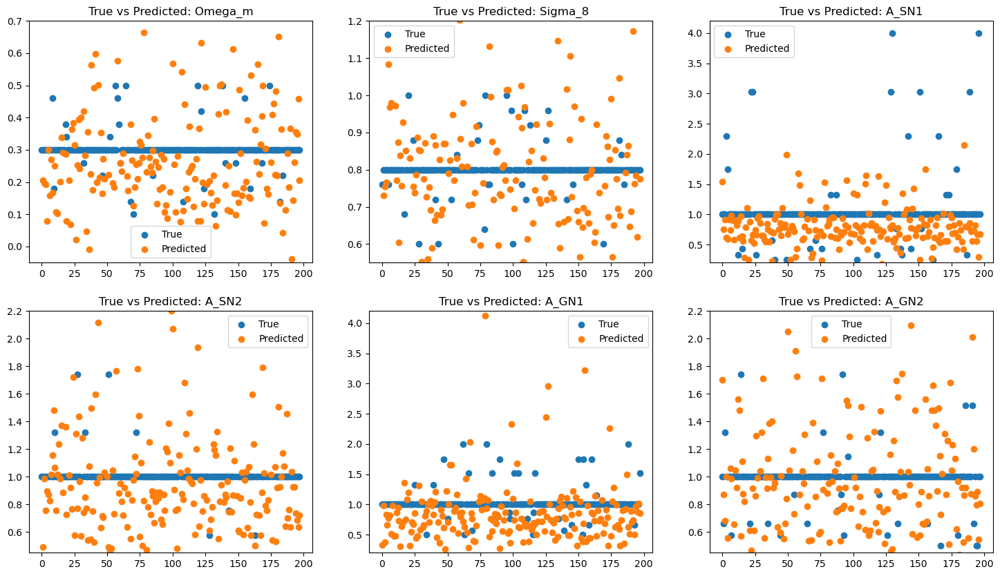

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 14ms/step - loss: 135.3629 - mae: 4.7124 - mse: 97.6599 - val_loss: 66.6549 - val_mae: 4.3392 - val_mse: 80.8951 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 101.5783 - mae: 4.4788 - mse: 104.3209 - val_loss: 48.7871 - val_mae: 2.9072 - val_mse: 40.8692 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 52.5813 - mae: 2.7940 - mse: 39.4263 - val_loss: 26.2680 - val_mae: 2.4901 - val_mse: 36.6813 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 47.1560 - mae: 2.0235 - mse: 37.9368 - val_loss: 12.0010 - val_mae: 1.6789 - val_mse: 13.8534 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 14ms/step - loss: 4.4470 - mae: 1.0686 - mse: 4.5322 - val_loss: 17.7398 - val_mae: 1.6234 - val_mse: 12.8496 

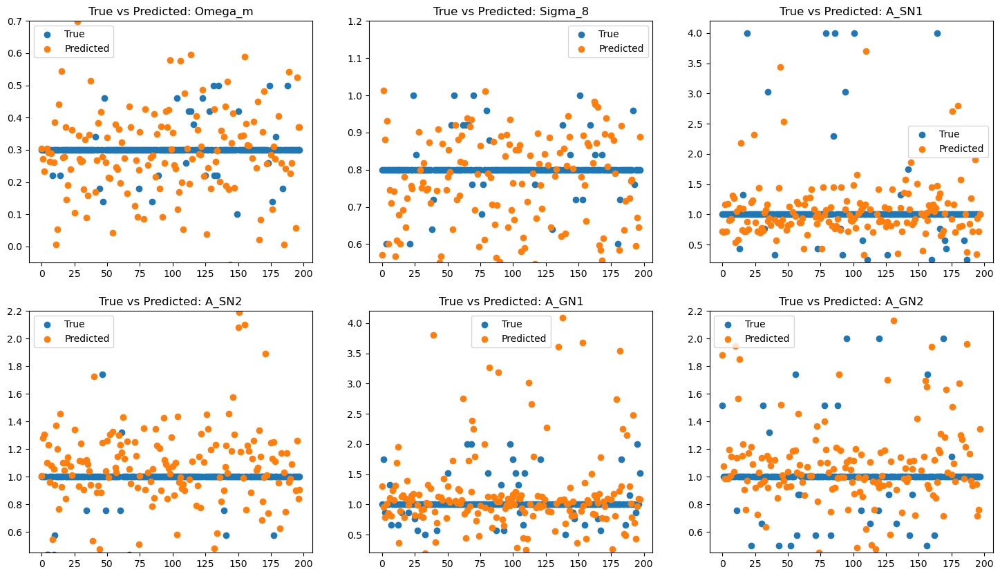

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 306.3301 - mae: 10.1810 - mse: 285.3623 - val_loss: 122.3645 - val_mae: 7.8529 - val_mse: 120.7884 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 141.2422 - mae: 7.2294 - mse: 154.7955 - val_loss: 36.7175 - val_mae: 3.5117 - val_mse: 35.2118 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 54.8507 - mae: 3.8044 - mse: 46.9071 - val_loss: 27.7283 - val_mae: 3.1482 - val_mse: 27.4746 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 29.9735 - mae: 2.6082 - mse: 27.4565 - val_loss: 4.9275 - val_mae: 1.3852 - val_mse: 5.1372 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 4.5859 - mae: 1.2604 - mse: 4.8381 - val_loss: 4.3025 - val_mae: 1.1225 - val_mse: 3.9465 - lea

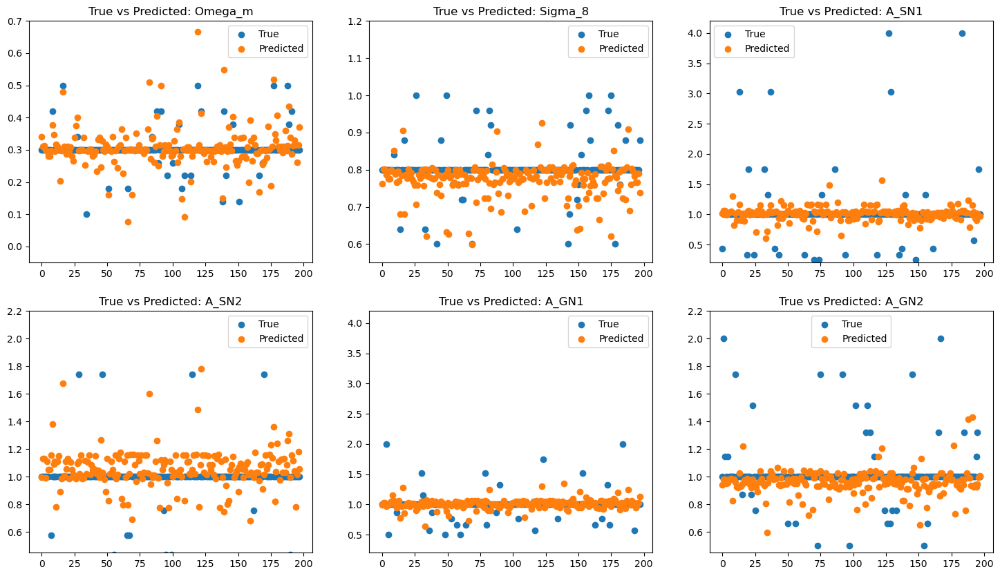

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 486.9860 - mae: 11.2643 - mse: 387.2946 - val_loss: 58.3790 - val_mae: 4.5811 - val_mse: 45.5563 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 52.2857 - mae: 4.8209 - mse: 55.0705 - val_loss: 34.1119 - val_mae: 4.3310 - val_mse: 35.6083 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 21.9091 - mae: 3.2528 - mse: 22.6443 - val_loss: 10.5511 - val_mae: 2.4461 - val_mse: 11.2751 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 24.3544 - mae: 2.9779 - mse: 23.9982 - val_loss: 18.4491 - val_mae: 2.6872 - val_mse: 14.8628 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 15ms/step - loss: 8.0720 - mae: 1.9616 - mse: 8.7029 - val_loss: 3.3368 - val_mae: 1.3243 - val_mse: 3.4277 - learning_rate

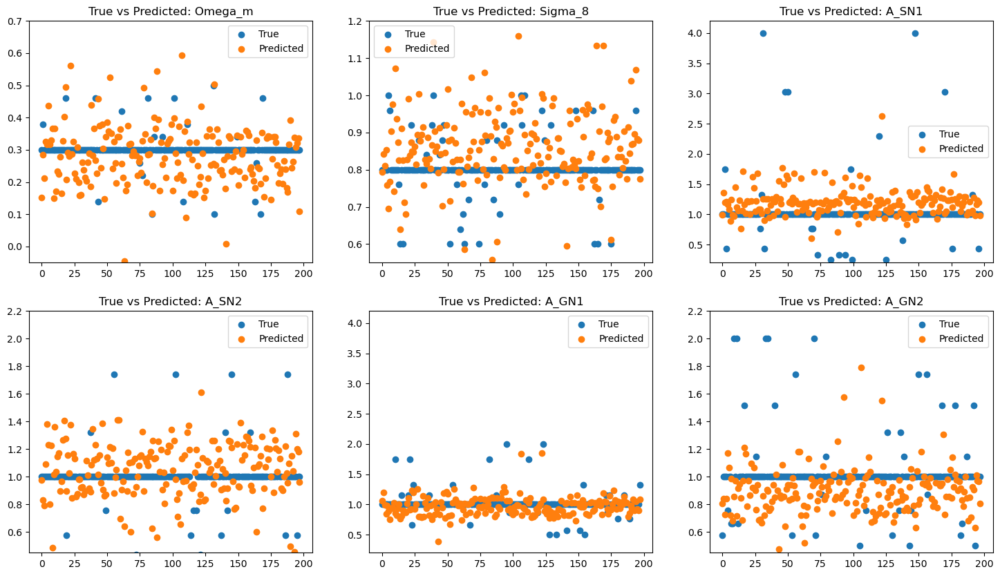

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 14ms/step - loss: 102.6839 - mae: 6.9054 - mse: 96.5096 - val_loss: 13.4976 - val_mae: 2.7808 - val_mse: 14.5787 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 17.2238 - mae: 3.2728 - mse: 19.7765 - val_loss: 3.1130 - val_mae: 1.5312 - val_mse: 4.1045 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 5.2576 - mae: 1.7733 - mse: 6.1521 - val_loss: 1.5942 - val_mae: 1.0878 - val_mse: 2.0428 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 2.1835 - mae: 1.1649 - mse: 2.6722 - val_loss: 0.6275 - val_mae: 0.6546 - val_mse: 0.8086 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.6648 - mae: 0.6390 - mse: 0.7985 - val_loss: 0.3325 - val_mae: 0.4529 - val_mse: 0.4381 - learning_rate: 0.

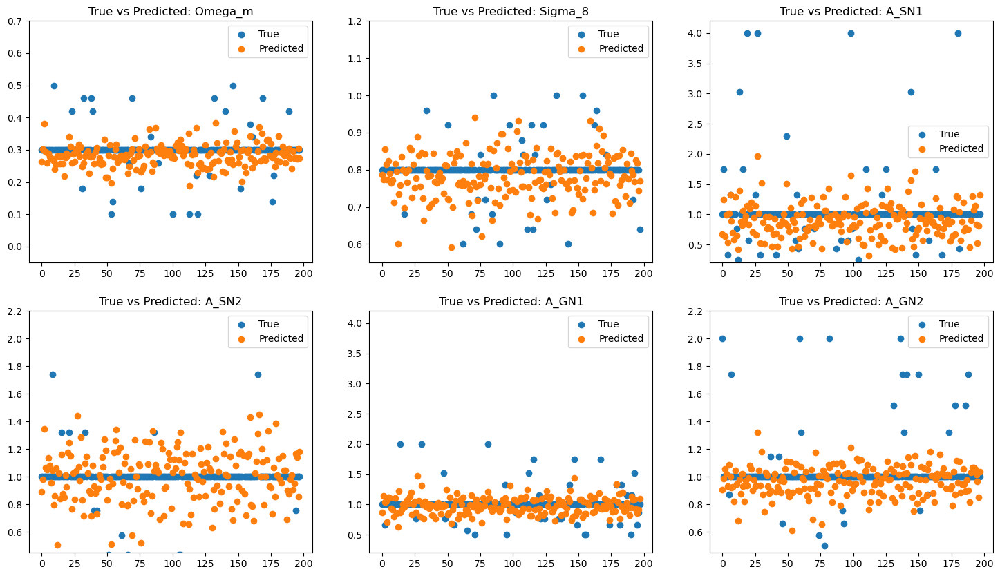

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 438.1476 - mae: 10.8853 - mse: 330.1584 - val_loss: 160.6564 - val_mae: 7.1254 - val_mse: 138.7483 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 184.6669 - mae: 6.7402 - mse: 129.7053 - val_loss: 30.3326 - val_mae: 3.0477 - val_mse: 25.0439 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 48.0220 - mae: 3.4518 - mse: 35.1622 - val_loss: 35.2239 - val_mae: 3.3232 - val_mse: 24.6891 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 24.1015 - mae: 2.5838 - mse: 17.1059 - val_loss: 22.9109 - val_mae: 2.4745 - val_mse: 17.2376 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 24.8959 - mae: 2.4044 - mse: 18.3182 - val_loss: 12.2094 - val_mae: 1.3087 - val_mse: 6.3856

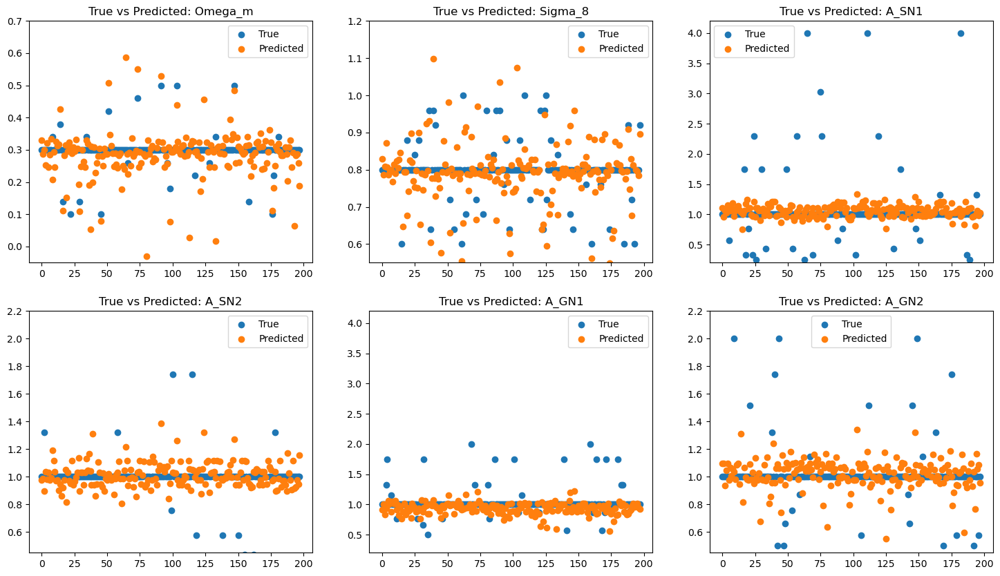

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 12ms/step - loss: 397.9243 - mae: 9.8660 - mse: 293.0481 - val_loss: 16.9309 - val_mae: 3.4509 - val_mse: 22.5664 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 15.0286 - mae: 2.7418 - mse: 17.2374 - val_loss: 9.2540 - val_mae: 2.1139 - val_mse: 11.6983 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 7.6177 - mae: 1.8979 - mse: 9.0728 - val_loss: 14.2662 - val_mae: 2.2208 - val_mse: 21.5189 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 4.7365 - mae: 1.3153 - mse: 5.3300 - val_loss: 2.1106 - val_mae: 0.9757 - val_mse: 2.3603 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 0.9505 - mae: 0.7694 - mse: 1.2874 - val_loss: 0.8597 - val_mae: 0.6300 - val_mse: 1.0889 - learning_

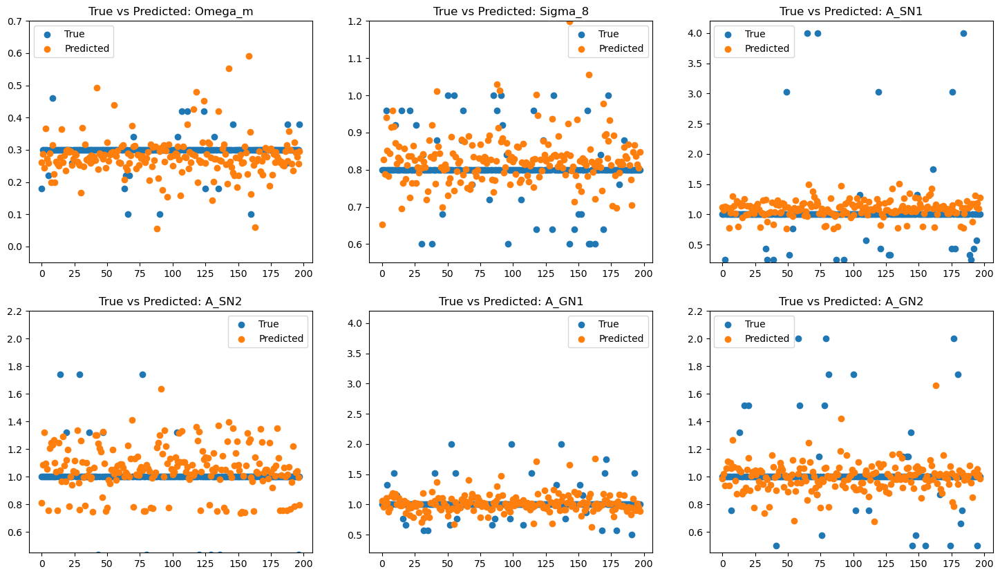

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 376.3931 - mae: 11.0035 - mse: 310.6674 - val_loss: 52.5283 - val_mae: 4.8019 - val_mse: 52.9873 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 42.2809 - mae: 4.2404 - mse: 43.7225 - val_loss: 15.7764 - val_mae: 2.7381 - val_mse: 15.8039 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 24.1492 - mae: 2.7242 - mse: 22.2385 - val_loss: 6.9303 - val_mae: 1.5115 - val_mse: 6.1593 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 6.1621 - mae: 1.4730 - mse: 5.7857 - val_loss: 2.3504 - val_mae: 1.0910 - val_mse: 2.7556 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 15ms/step - loss: 2.9770 - mae: 1.0316 - mse: 3.0084 - val_loss: 3.6179 - val_mae: 1.1026 - val_mse: 2.9896 - learning_rate: 

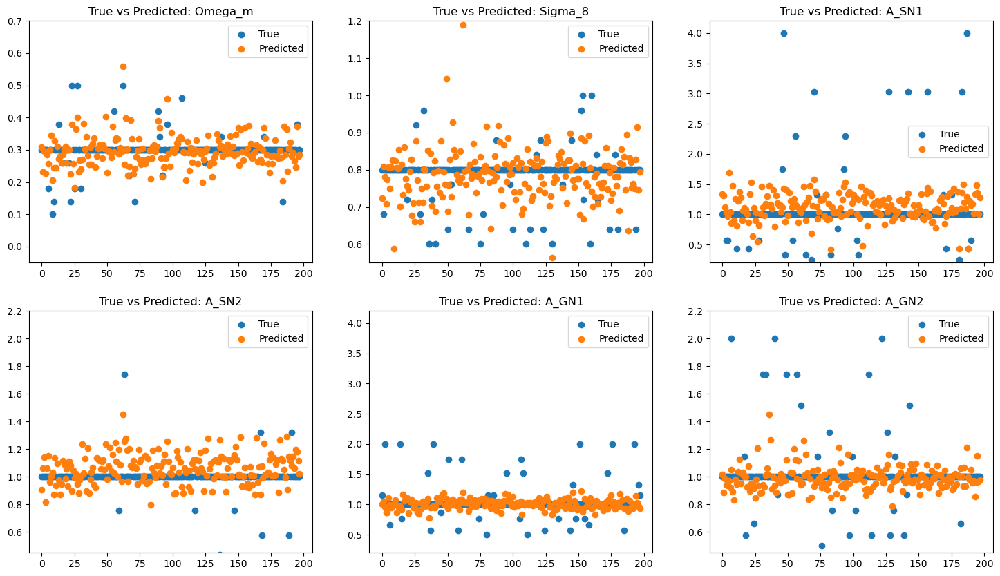

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 14ms/step - loss: 564.7094 - mae: 13.7726 - mse: 427.1188 - val_loss: 36.3083 - val_mae: 3.6800 - val_mse: 33.2467 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 46.6620 - mae: 4.6838 - mse: 46.0568 - val_loss: 69.8108 - val_mae: 5.5228 - val_mse: 60.6671 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 55.5146 - mae: 4.5879 - mse: 60.1959 - val_loss: 13.7619 - val_mae: 2.2132 - val_mse: 12.6829 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 6.2980 - mae: 1.7933 - mse: 7.4864 - val_loss: 1.6610 - val_mae: 1.0442 - val_mse: 2.6574 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 2.5604 - mae: 1.1397 - mse: 3.3686 - val_loss: 2.2946 - val_mae: 0.9584 - val_mse: 2.7396 - learning

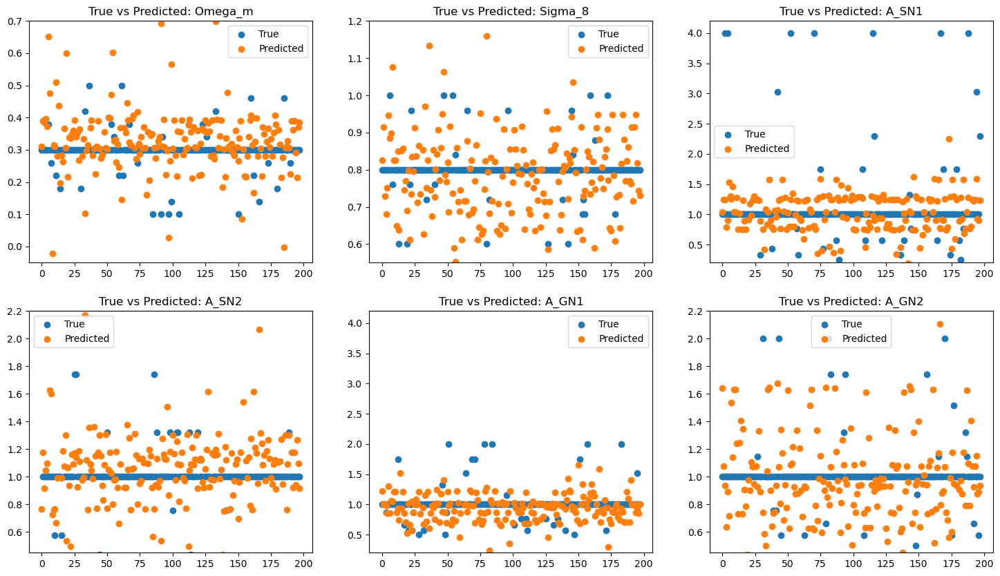

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 14ms/step - loss: 517.1860 - mae: 13.7518 - mse: 425.1560 - val_loss: 77.4942 - val_mae: 6.0214 - val_mse: 67.8356 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 41.9008 - mae: 4.3261 - mse: 38.4275 - val_loss: 7.5945 - val_mae: 2.2490 - val_mse: 9.2503 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 11.1685 - mae: 2.4353 - mse: 12.6223 - val_loss: 3.7679 - val_mae: 1.5244 - val_mse: 4.6071 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 7.8948 - mae: 1.9930 - mse: 9.1892 - val_loss: 8.5387 - val_mae: 2.1051 - val_mse: 8.0628 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 12.0487 - mae: 2.4217 - mse: 12.8086 - val_loss: 5.7357 - val_mae: 1.7235 - val_mse: 5.8284 - learning_rate: 0.0

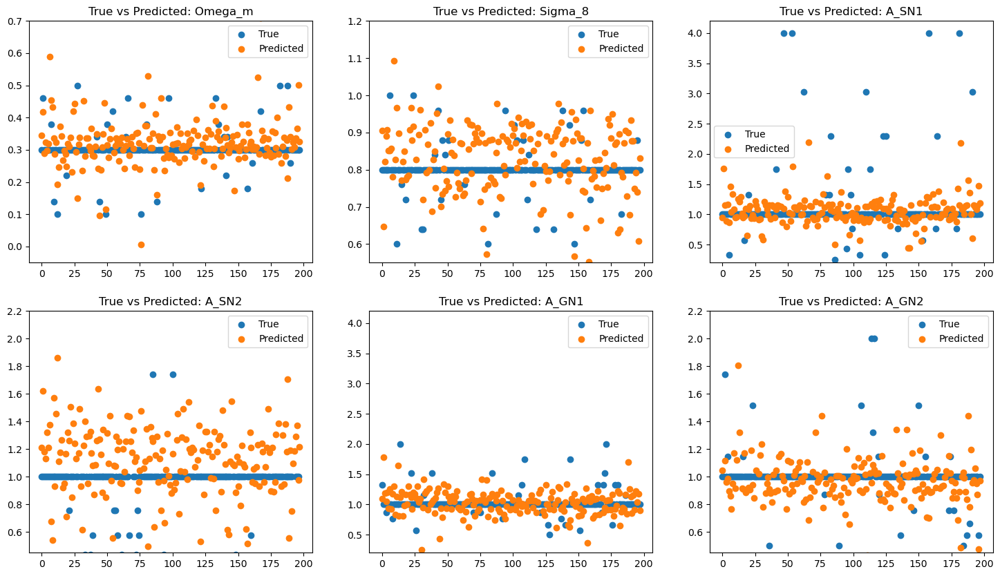

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 426.6538 - mae: 10.0193 - mse: 305.4070 - val_loss: 69.5131 - val_mae: 5.5715 - val_mse: 65.6197 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 85.1189 - mae: 5.9547 - mse: 91.3405 - val_loss: 36.9289 - val_mae: 3.3848 - val_mse: 32.3605 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 38.7492 - mae: 3.6763 - mse: 36.0458 - val_loss: 13.8588 - val_mae: 2.5828 - val_mse: 14.4566 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 22.2727 - mae: 2.9695 - mse: 21.6324 - val_loss: 6.8659 - val_mae: 1.9828 - val_mse: 7.4762 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 14.4974 - mae: 2.2896 - mse: 15.7937 - val_loss: 7.4601 - val_mae: 1.7311 - val_mse: 9.7522 - learning_

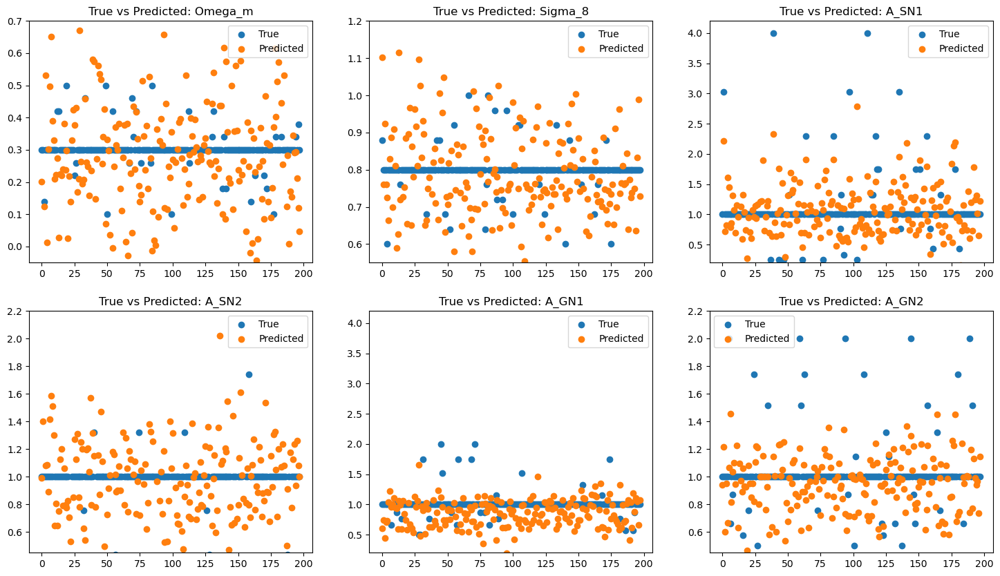

In [228]:
dense_model_loss = test_models(create_dense_model, (256,256,1))

### Model A

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0498 - mae: 0.1667 - mse: 0.1371 - val_loss: 0.0362 - val_mae: 0.1390 - val_mse: 0.0999 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0329 - mae: 0.1279 - mse: 0.0987 - val_loss: 0.0378 - val_mae: 0.1618 - val_mse: 0.1063 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0298 - mae: 0.1313 - mse: 0.0864 - val_loss: 0.0358 - val_mae: 0.1432 - val_mse: 0.1052 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0326 - mae: 0.1395 - mse: 0.0943 - val_loss: 0.0325 - val_mae: 0.1073 - val_mse: 0.0945 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0280 - mae: 0.1232 - mse: 0.0780 - val_loss: 0.0336 - val_mae: 0.1294 - val_mse: 0.0892 - learning_rate: 0.0010
Epoch 6/20


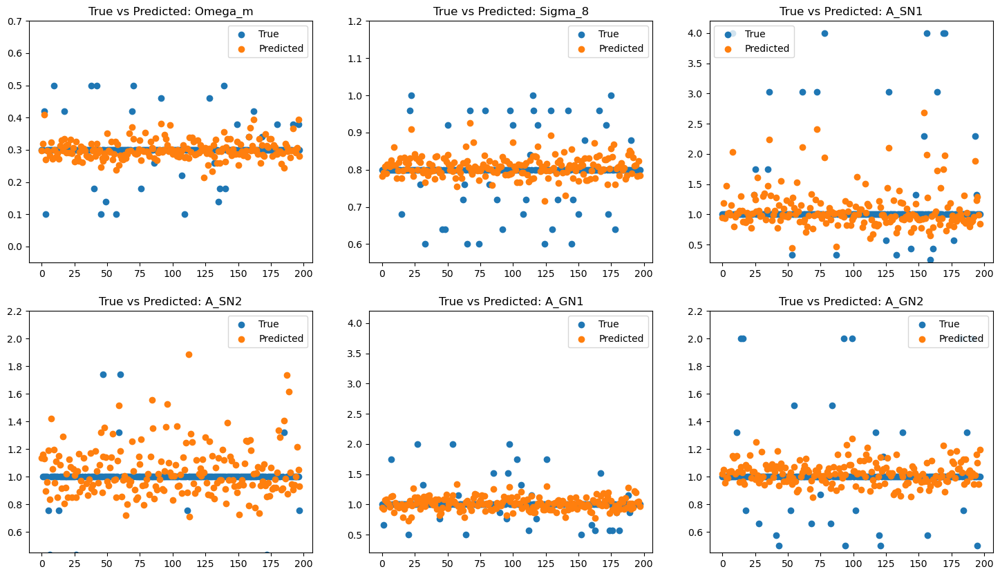

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0593 - mae: 0.1683 - mse: 0.1457 - val_loss: 0.0267 - val_mae: 0.1040 - val_mse: 0.0759 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0400 - mae: 0.1355 - mse: 0.1290 - val_loss: 0.0266 - val_mae: 0.1021 - val_mse: 0.0743 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0353 - mae: 0.1256 - mse: 0.1075 - val_loss: 0.0294 - val_mae: 0.1438 - val_mse: 0.0818 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0305 - mae: 0.1250 - mse: 0.0892 - val_loss: 0.0289 - val_mae: 0.1290 - val_mse: 0.0773 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0202 - mae: 0.1036 - mse: 0.0585 - val_loss: 0.0263 - val_mae: 0.1147 - val_mse: 0.0745 - learning_rate: 5.000

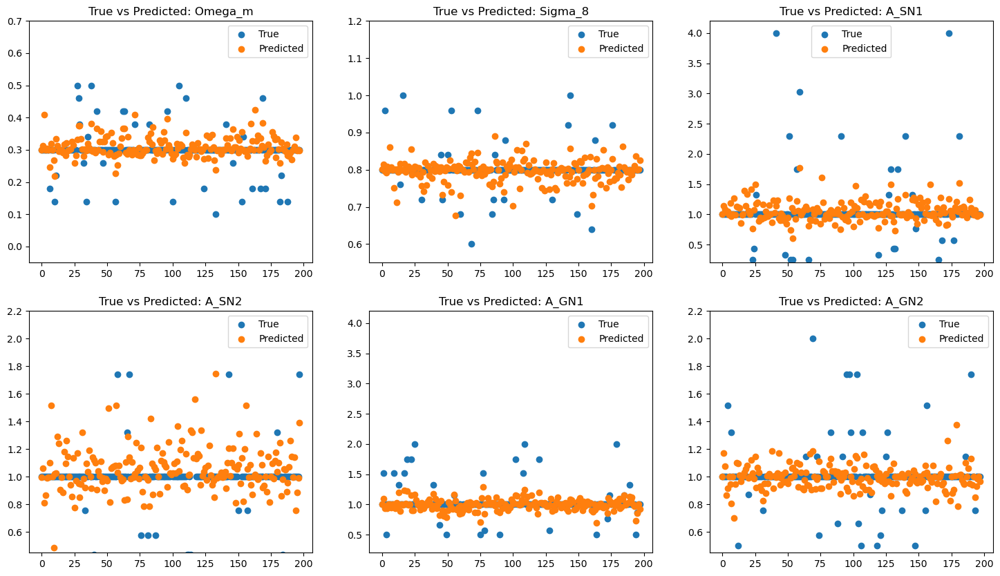

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0409 - mae: 0.1467 - mse: 0.1060 - val_loss: 0.0328 - val_mae: 0.1221 - val_mse: 0.1001 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0271 - mae: 0.1074 - mse: 0.0783 - val_loss: 0.0322 - val_mae: 0.1025 - val_mse: 0.1002 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0292 - mae: 0.1125 - mse: 0.0887 - val_loss: 0.0335 - val_mae: 0.1365 - val_mse: 0.1003 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0318 - mae: 0.1132 - mse: 0.0924 - val_loss: 0.0325 - val_mae: 0.1047 - val_mse: 0.0985 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0259 - mae: 0.0984 - mse: 0.0734 - val_loss: 0.0317 - val_mae: 0.1193 - val_mse: 0.0982 - learning_rate: 5.0000e-04
Epo

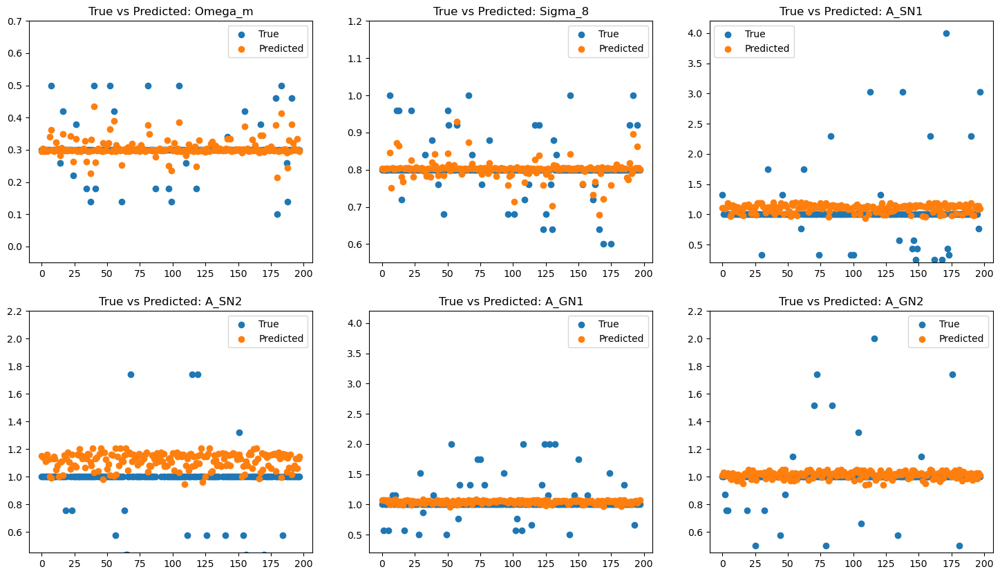

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0379 - mae: 0.1368 - mse: 0.0965 - val_loss: 0.0354 - val_mae: 0.1100 - val_mse: 0.1060 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0306 - mae: 0.1157 - mse: 0.0907 - val_loss: 0.0354 - val_mae: 0.1250 - val_mse: 0.1064 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0305 - mae: 0.1187 - mse: 0.0919 - val_loss: 0.0348 - val_mae: 0.1106 - val_mse: 0.1048 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0329 - mae: 0.1201 - mse: 0.0988 - val_loss: 0.0359 - val_mae: 0.1187 - val_mse: 0.1081 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0337 - mae: 0.1180 - mse: 0.1042 - val_loss: 0.0340 - val_mae: 0.1238 - val_mse: 0.1022 - learning_rate: 0.0010
Epoch 6/20
594/

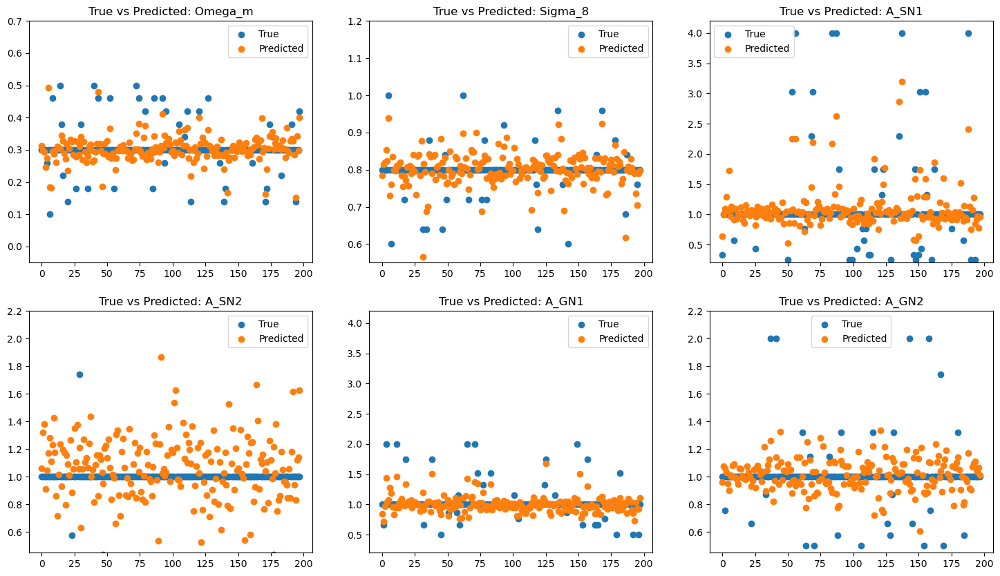

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0356 - mae: 0.1363 - mse: 0.0915 - val_loss: 0.0357 - val_mae: 0.1418 - val_mse: 0.1091 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0295 - mae: 0.1187 - mse: 0.0859 - val_loss: 0.0329 - val_mae: 0.1227 - val_mse: 0.0954 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0278 - mae: 0.1303 - mse: 0.0770 - val_loss: 0.0369 - val_mae: 0.1568 - val_mse: 0.0991 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0208 - mae: 0.1127 - mse: 0.0563 - val_loss: 0.0349 - val_mae: 0.1425 - val_mse: 0.0984 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0154 - mae: 0.0981 - mse: 0.0391 - val_loss: 0.0317 - val_mae: 0.1268 - val_mse: 0.0941 - learning_rate: 5.0000e-04
Epo

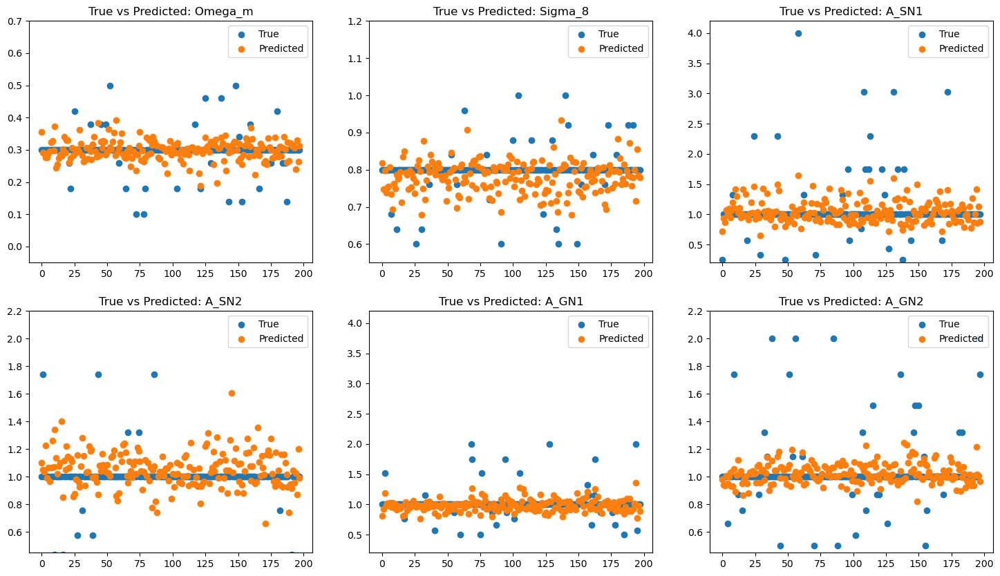

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0350 - mae: 0.1368 - mse: 0.0891 - val_loss: 0.0427 - val_mae: 0.1546 - val_mse: 0.1356 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0318 - mae: 0.1171 - mse: 0.0987 - val_loss: 0.0407 - val_mae: 0.1318 - val_mse: 0.1336 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0344 - mae: 0.1176 - mse: 0.1033 - val_loss: 0.0406 - val_mae: 0.1345 - val_mse: 0.1333 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0321 - mae: 0.1176 - mse: 0.0940 - val_loss: 0.0399 - val_mae: 0.1213 - val_mse: 0.1323 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0341 - mae: 0.1201 - mse: 0.1044 - val_loss: 0.0395 - val_mae: 0.1250 - val_mse: 0.1313 - learning_rate: 0.0010
Epoch 

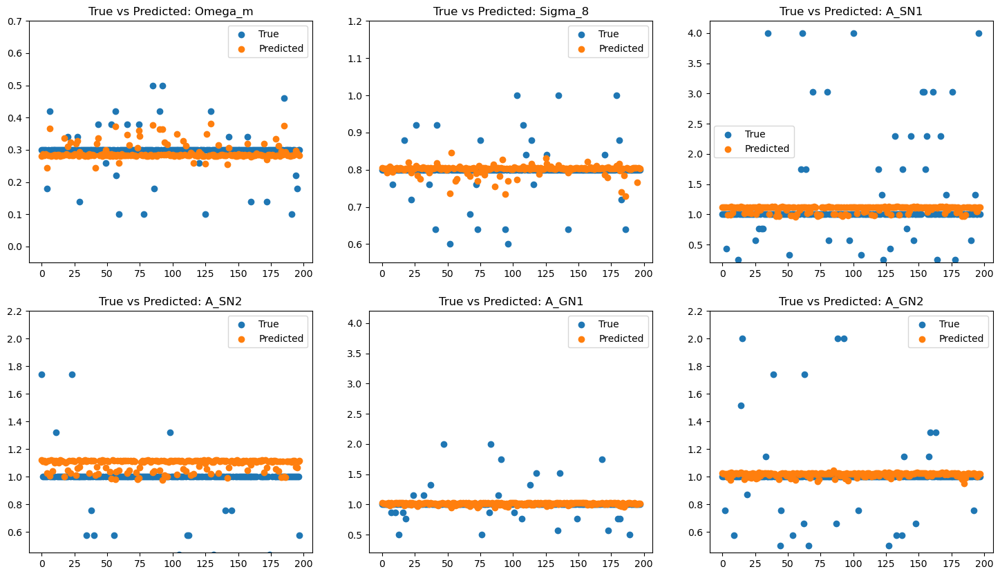

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0385 - mae: 0.1358 - mse: 0.1042 - val_loss: 0.0346 - val_mae: 0.1473 - val_mse: 0.1028 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0349 - mae: 0.1256 - mse: 0.0998 - val_loss: 0.0335 - val_mae: 0.1021 - val_mse: 0.0994 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0306 - mae: 0.1156 - mse: 0.0926 - val_loss: 0.0322 - val_mae: 0.0962 - val_mse: 0.0954 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0301 - mae: 0.1093 - mse: 0.0865 - val_loss: 0.0337 - val_mae: 0.0950 - val_mse: 0.0996 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0281 - mae: 0.1005 - mse: 0.0789 - val_loss: 0.0310 - val_mae: 0.1206 - val_mse: 0.0874 - learning_rate: 0.0010
Epo

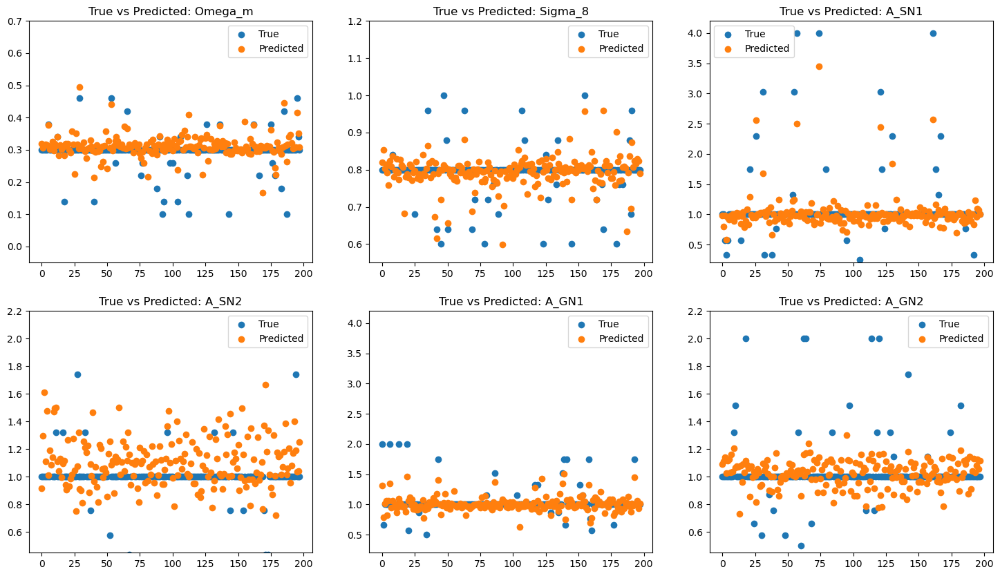

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0474 - mae: 0.1584 - mse: 0.1245 - val_loss: 0.0319 - val_mae: 0.1046 - val_mse: 0.0951 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0334 - mae: 0.1192 - mse: 0.1039 - val_loss: 0.0324 - val_mae: 0.1472 - val_mse: 0.0965 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0330 - mae: 0.1324 - mse: 0.1022 - val_loss: 0.0335 - val_mae: 0.1524 - val_mse: 0.0961 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0248 - mae: 0.1207 - mse: 0.0715 - val_loss: 0.0304 - val_mae: 0.1323 - val_mse: 0.0904 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0196 - mae: 0.1091 - mse: 0.0584 - val_loss: 0.0307 - val_mae: 0.1306 - val_mse: 0.0884 - learning_rate: 5.0000e-04
Epo

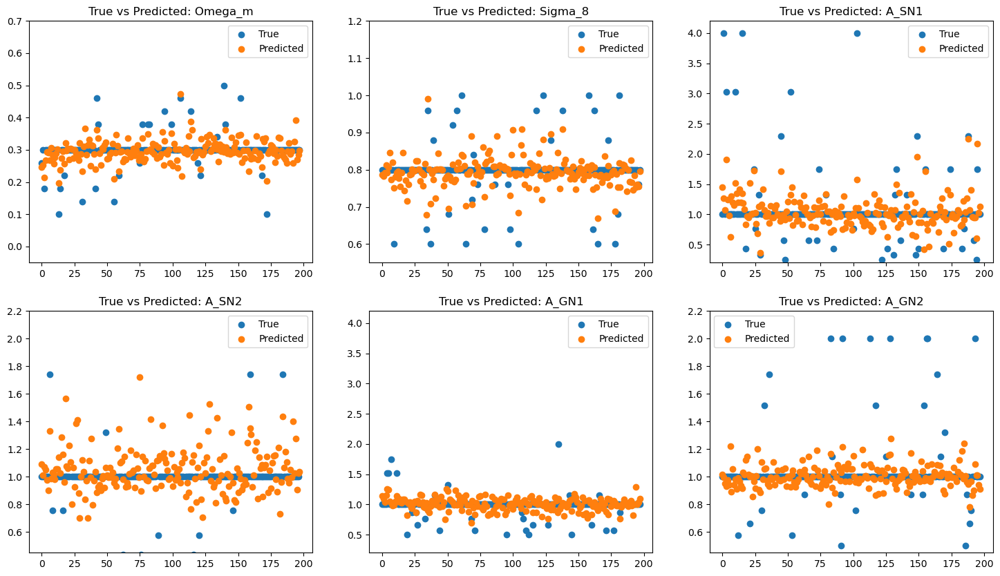

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0403 - mae: 0.1460 - mse: 0.1089 - val_loss: 0.0371 - val_mae: 0.1143 - val_mse: 0.1076 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0371 - mae: 0.1232 - mse: 0.1168 - val_loss: 0.0366 - val_mae: 0.0952 - val_mse: 0.1098 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0340 - mae: 0.1161 - mse: 0.1031 - val_loss: 0.0360 - val_mae: 0.1090 - val_mse: 0.1073 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0312 - mae: 0.1126 - mse: 0.0872 - val_loss: 0.0372 - val_mae: 0.1205 - val_mse: 0.1116 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0297 - mae: 0.1039 - mse: 0.0849 - val_loss: 0.0360 - val_mae: 0.1313 - val_mse: 0.1082 - learning_rate: 0.0010
Epoch 

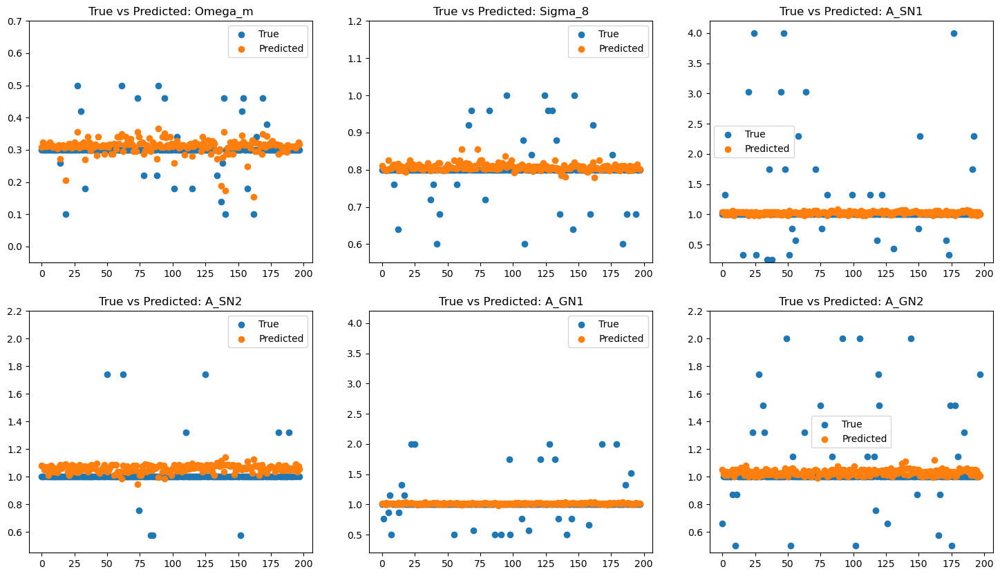

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0403 - mae: 0.1487 - mse: 0.1052 - val_loss: 0.0285 - val_mae: 0.1409 - val_mse: 0.0774 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0383 - mae: 0.1324 - mse: 0.1201 - val_loss: 0.0261 - val_mae: 0.0899 - val_mse: 0.0716 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0752 - mae: 0.1729 - mse: 0.1684 - val_loss: 0.6566 - val_mae: 0.8738 - val_mse: 0.9080 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.6822 - mae: 0.8918 - mse: 0.9976 - val_loss: 0.6566 - val_mae: 0.8738 - val_mse: 0.9080 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 0.6660 - mae: 0.8787 - mse: 0.9544 - val_loss: 0.6566 - val_mae: 0.8738 - val_mse: 0.9080 - learning_rate: 5.0000e-04
Epoch 6/20

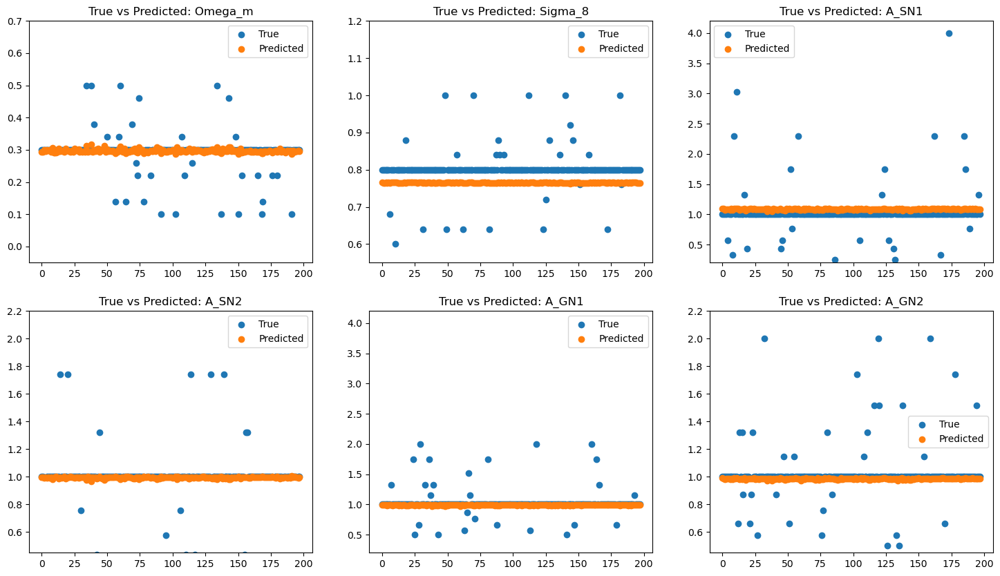

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0415 - mae: 0.1448 - mse: 0.1162 - val_loss: 0.0333 - val_mae: 0.1152 - val_mse: 0.0988 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0271 - mae: 0.1231 - mse: 0.0807 - val_loss: 0.0348 - val_mae: 0.1298 - val_mse: 0.0975 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0227 - mae: 0.1120 - mse: 0.0652 - val_loss: 0.0319 - val_mae: 0.1501 - val_mse: 0.0885 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0236 - mae: 0.1176 - mse: 0.0687 - val_loss: 0.0319 - val_mae: 0.1489 - val_mse: 0.0894 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0189 - mae: 0.1127 - mse: 0.0523 - val_loss: 0.0377 - val_mae: 0.1866 - val_mse: 0.1076 - learning_rate: 0.0010
Epoch 6/20


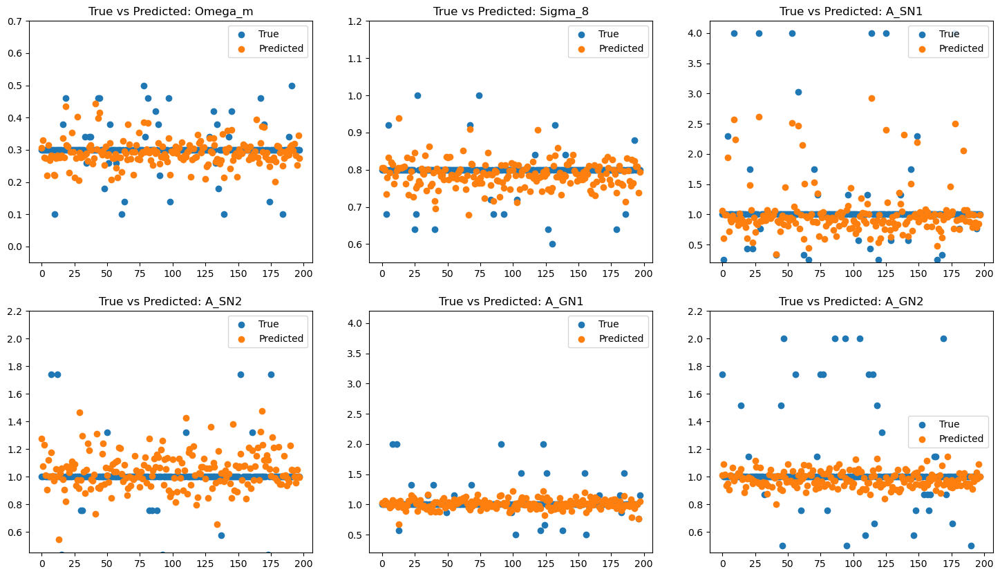

In [230]:
modelA_loss = test_models(create_modelA, (256,256,1), weight_param = 0.13)

### Model B

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 0.0489 - mae: 0.1710 - mse: 0.1248 - val_loss: 0.0401 - val_mae: 0.1237 - val_mse: 0.1266 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0334 - mae: 0.1287 - mse: 0.0919 - val_loss: 0.0393 - val_mae: 0.1378 - val_mse: 0.1229 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0324 - mae: 0.1285 - mse: 0.0856 - val_loss: 0.0408 - val_mae: 0.1600 - val_mse: 0.1286 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0323 - mae: 0.1351 - mse: 0.0886 - val_loss: 0.0417 - val_mae: 0.1439 - val_mse: 0.1328 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0318 - mae: 0.1203 - mse: 0.0914 - val_loss: 0.0392 - val_mae: 0.1184 - val_mse: 0.1258 - learning_rate: 5.0000e-04
Epoch 6

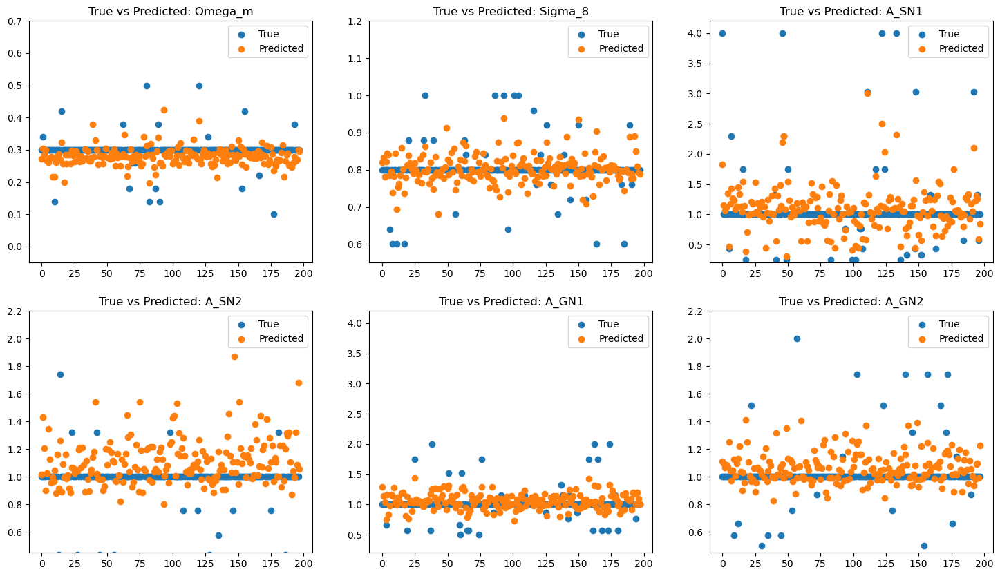

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.0545 - mae: 0.1705 - mse: 0.1360 - val_loss: 0.0365 - val_mae: 0.1807 - val_mse: 0.1045 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0383 - mae: 0.1440 - mse: 0.1057 - val_loss: 0.0304 - val_mae: 0.1169 - val_mse: 0.0870 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0328 - mae: 0.1232 - mse: 0.0939 - val_loss: 0.0311 - val_mae: 0.1362 - val_mse: 0.0900 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0331 - mae: 0.1239 - mse: 0.0952 - val_loss: 0.0329 - val_mae: 0.1545 - val_mse: 0.0972 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0297 - mae: 0.1175 - mse: 0.0876 - val_loss: 0.0300 - val_mae: 0.0968 - val_mse: 0.0868 - learning_rate: 5.0000e-0

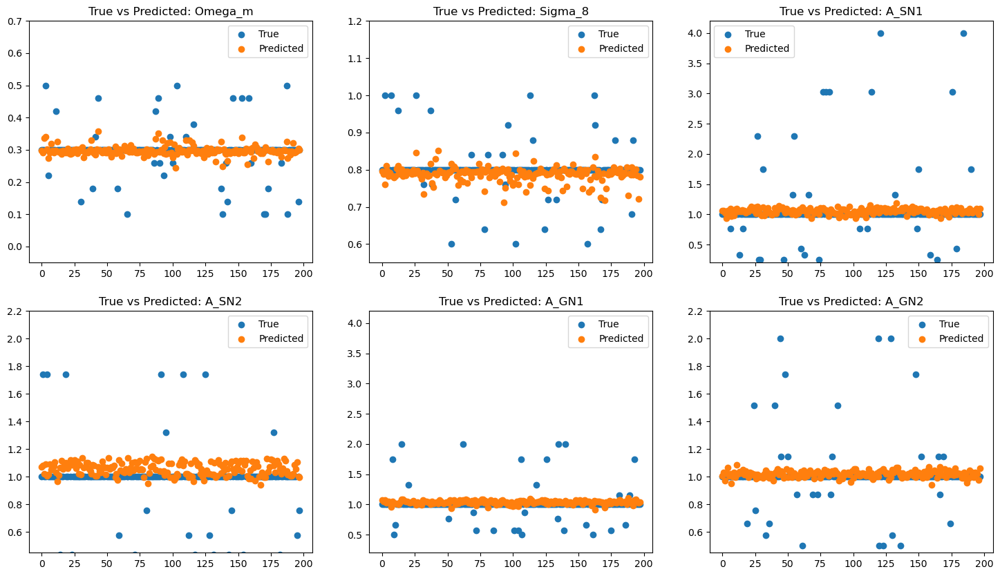

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 0.0466 - mae: 0.1593 - mse: 0.1168 - val_loss: 0.0438 - val_mae: 0.1399 - val_mse: 0.1390 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0322 - mae: 0.1218 - mse: 0.0927 - val_loss: 0.0418 - val_mae: 0.1456 - val_mse: 0.1296 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0281 - mae: 0.1112 - mse: 0.0815 - val_loss: 0.0397 - val_mae: 0.1360 - val_mse: 0.1279 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0285 - mae: 0.1145 - mse: 0.0781 - val_loss: 0.0449 - val_mae: 0.1564 - val_mse: 0.1357 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0299 - mae: 0.1204 - mse: 0.0819 - val_loss: 0.0423 - val_mae: 0.1625 - val_mse: 0.1303 - learning_rate: 0.0010
Epoch 6

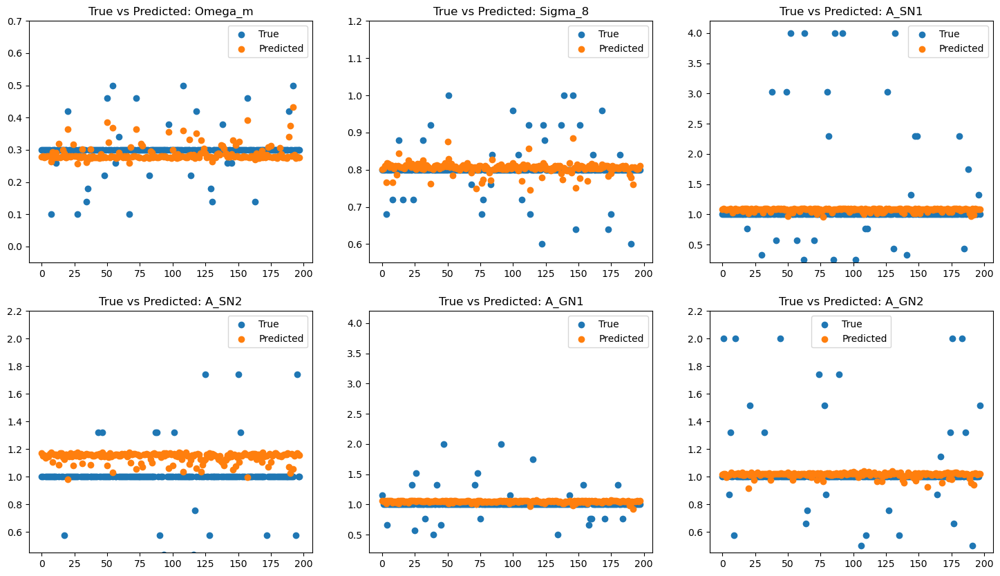

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.0481 - mae: 0.1671 - mse: 0.1238 - val_loss: 0.0314 - val_mae: 0.1116 - val_mse: 0.0916 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0373 - mae: 0.1329 - mse: 0.1099 - val_loss: 0.0310 - val_mae: 0.1167 - val_mse: 0.0924 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0340 - mae: 0.1235 - mse: 0.0998 - val_loss: 0.0380 - val_mae: 0.1740 - val_mse: 0.1200 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0335 - mae: 0.1296 - mse: 0.0914 - val_loss: 0.0304 - val_mae: 0.1105 - val_mse: 0.0902 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0343 - mae: 0.1248 - mse: 0.0908 - val_loss: 0.0428 - val_mae: 0.1776 - val_mse: 0.1302 - learning_rate: 0.0010
Epoch 6/20
594/

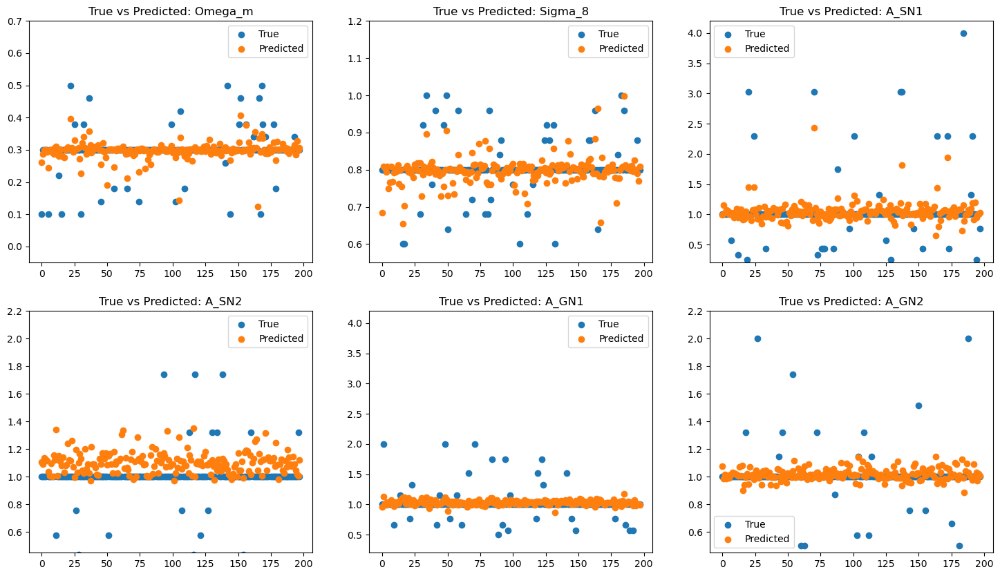

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 0.0431 - mae: 0.1518 - mse: 0.1097 - val_loss: 0.0320 - val_mae: 0.1173 - val_mse: 0.0883 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0390 - mae: 0.1497 - mse: 0.1158 - val_loss: 0.0327 - val_mae: 0.1246 - val_mse: 0.0898 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0263 - mae: 0.1244 - mse: 0.0714 - val_loss: 0.0475 - val_mae: 0.2166 - val_mse: 0.1190 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0264 - mae: 0.1346 - mse: 0.0661 - val_loss: 0.0309 - val_mae: 0.1236 - val_mse: 0.0830 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0247 - mae: 0.1314 - mse: 0.0637 - val_loss: 0.0311 - val_mae: 0.1331 - val_mse: 0.0876 - learning_rate: 5.0000e-04

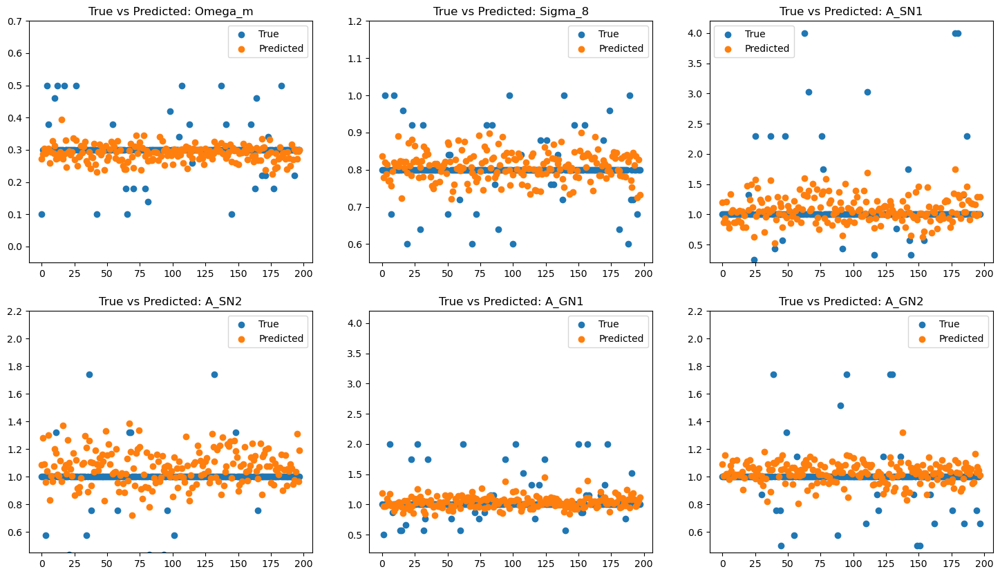

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.0429 - mae: 0.1550 - mse: 0.1086 - val_loss: 0.0384 - val_mae: 0.1435 - val_mse: 0.1188 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0312 - mae: 0.1183 - mse: 0.0874 - val_loss: 0.0360 - val_mae: 0.1068 - val_mse: 0.1176 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0266 - mae: 0.1095 - mse: 0.0724 - val_loss: 0.0391 - val_mae: 0.1429 - val_mse: 0.1268 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0369 - mae: 0.1364 - mse: 0.1081 - val_loss: 0.0376 - val_mae: 0.1298 - val_mse: 0.1220 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0284 - mae: 0.1111 - mse: 0.0806 - val_loss: 0.0359 - val_mae: 0.1086 - val_mse: 0.1170 - learning_rate: 5.0000e-04
Ep

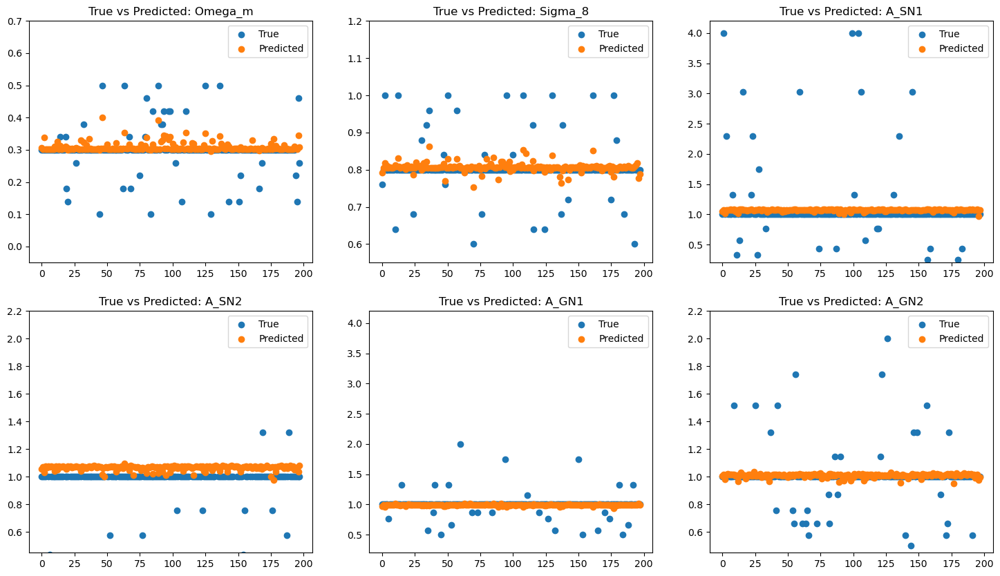

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 0.0432 - mae: 0.1524 - mse: 0.1110 - val_loss: 0.0339 - val_mae: 0.1088 - val_mse: 0.0936 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0343 - mae: 0.1297 - mse: 0.1043 - val_loss: 0.0385 - val_mae: 0.1715 - val_mse: 0.1012 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0318 - mae: 0.1277 - mse: 0.0922 - val_loss: 0.0333 - val_mae: 0.1066 - val_mse: 0.0922 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0411 - mae: 0.1468 - mse: 0.1246 - val_loss: 0.0330 - val_mae: 0.1176 - val_mse: 0.0936 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0481 - mae: 0.1662 - mse: 0.1460 - val_loss: 0.0349 - val_mae: 0.1453 - val_mse: 0.0941 - learning_rate: 0.0010
Epo

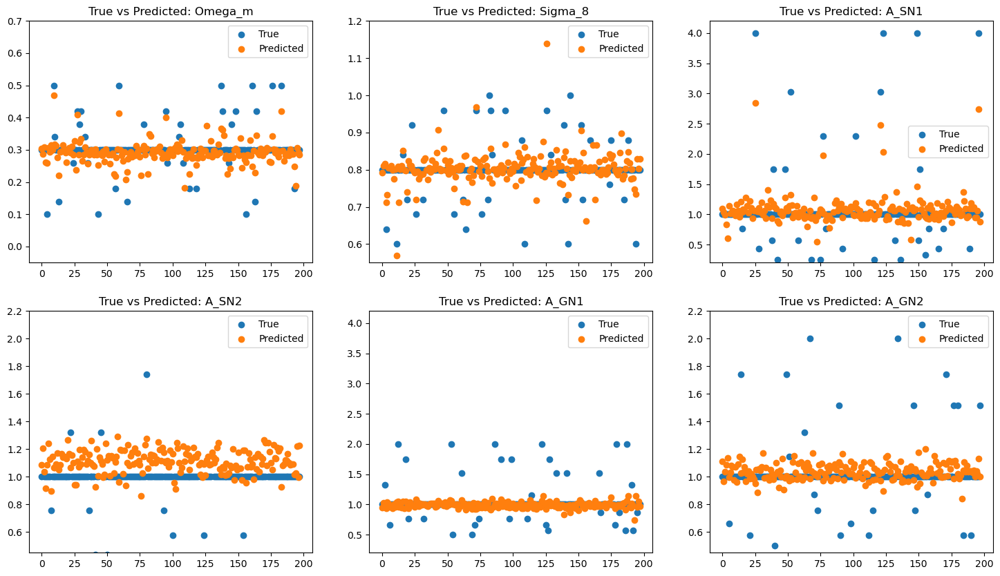

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.0452 - mae: 0.1541 - mse: 0.1177 - val_loss: 0.0325 - val_mae: 0.1280 - val_mse: 0.0987 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0313 - mae: 0.1211 - mse: 0.0873 - val_loss: 0.0338 - val_mae: 0.1485 - val_mse: 0.0992 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0350 - mae: 0.1357 - mse: 0.1061 - val_loss: 0.0425 - val_mae: 0.1723 - val_mse: 0.1161 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0392 - mae: 0.1456 - mse: 0.1123 - val_loss: 0.0320 - val_mae: 0.1106 - val_mse: 0.0966 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0280 - mae: 0.1135 - mse: 0.0811 - val_loss: 0.0307 - val_mae: 0.1297 - val_mse: 0.0940 - learning_rate: 5.0000e-04
Epo

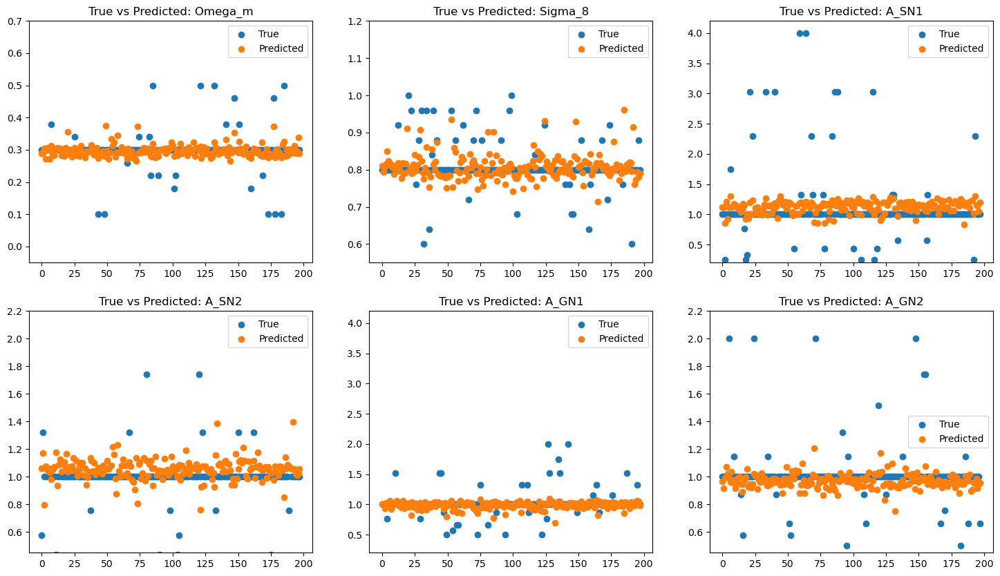

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.0460 - mae: 0.1579 - mse: 0.1090 - val_loss: 0.0420 - val_mae: 0.1165 - val_mse: 0.1295 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0379 - mae: 0.1299 - mse: 0.1138 - val_loss: 0.0408 - val_mae: 0.1332 - val_mse: 0.1253 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 3.0696 - mae: 0.6139 - mse: 2.0506 - val_loss: 0.6779 - val_mae: 0.8878 - val_mse: 0.9915 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.6582 - mae: 0.8713 - mse: 0.9147 - val_loss: 0.6779 - val_mae: 0.8878 - val_mse: 0.9915 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.6689 - mae: 0.8844 - mse: 0.9604 - val_loss: 0.6779 - val_mae: 0.8878 - val_mse: 0.9915 - learning_rate: 5.0000e-04
Ep

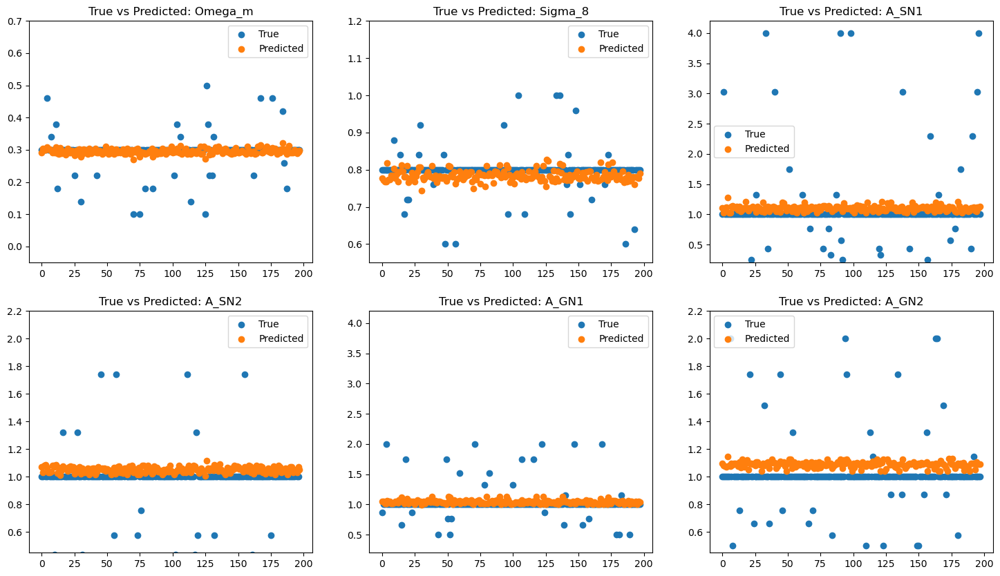

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.0431 - mae: 0.1486 - mse: 0.1056 - val_loss: 0.0370 - val_mae: 0.1285 - val_mse: 0.1115 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0337 - mae: 0.1216 - mse: 0.1008 - val_loss: 0.0375 - val_mae: 0.1395 - val_mse: 0.1143 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0291 - mae: 0.1174 - mse: 0.0858 - val_loss: 0.0383 - val_mae: 0.1293 - val_mse: 0.1128 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0259 - mae: 0.1135 - mse: 0.0724 - val_loss: 0.0360 - val_mae: 0.1314 - val_mse: 0.1104 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 0.0245 - mae: 0.1177 - mse: 0.0739 - val_loss: 0.0357 - val_mae: 0.1311 - val_mse: 0.1079 - learning_rate: 5.0000e-04
Epoch 

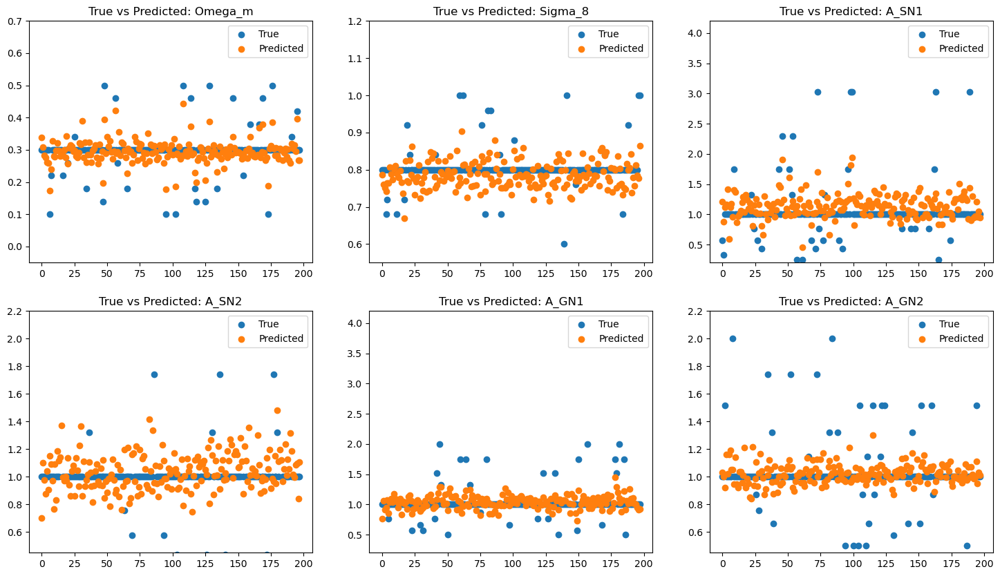

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0472 - mae: 0.1684 - mse: 0.1191 - val_loss: 0.0313 - val_mae: 0.1175 - val_mse: 0.0877 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0333 - mae: 0.1370 - mse: 0.0960 - val_loss: 0.0369 - val_mae: 0.1674 - val_mse: 0.1000 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0358 - mae: 0.1407 - mse: 0.0994 - val_loss: 0.0390 - val_mae: 0.1471 - val_mse: 0.1004 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0375 - mae: 0.1437 - mse: 0.1090 - val_loss: 0.0291 - val_mae: 0.1175 - val_mse: 0.0844 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0259 - mae: 0.1169 - mse: 0.0693 - val_loss: 0.0303 - val_mae: 0.1445 - val_mse: 0.0857 - learning_rate: 5.0000e-04
Epo

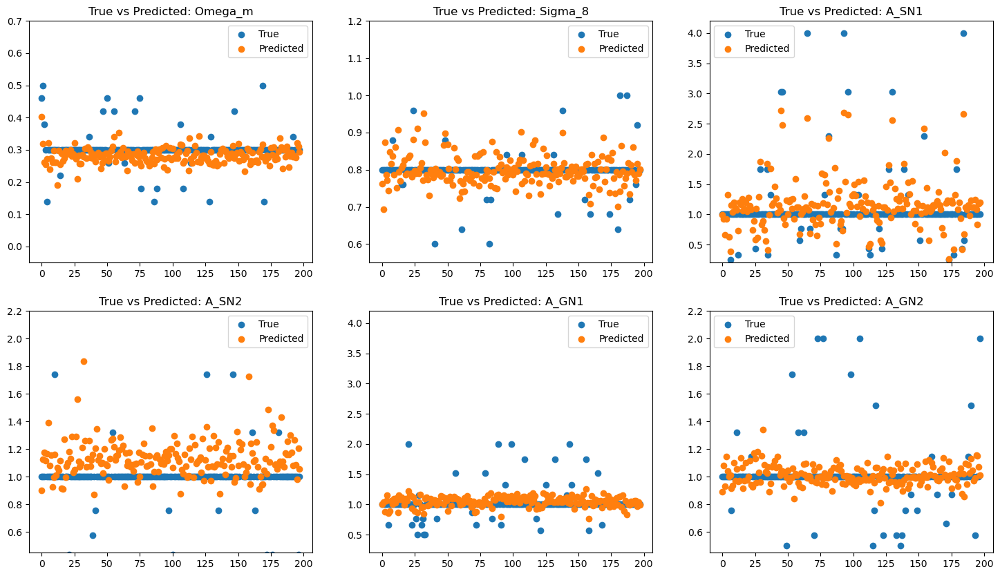

In [231]:
modelB_loss = test_models(create_modelB, (256,256,1))

### Model C

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0653 - mae: 0.1790 - mse: 0.1491 - val_loss: 0.0362 - val_mae: 0.1239 - val_mse: 0.1014 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0313 - mae: 0.1157 - mse: 0.0947 - val_loss: 0.0350 - val_mae: 0.1389 - val_mse: 0.1010 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0337 - mae: 0.1274 - mse: 0.1021 - val_loss: 0.0310 - val_mae: 0.1138 - val_mse: 0.0938 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0317 - mae: 0.1217 - mse: 0.0968 - val_loss: 0.0329 - val_mae: 0.1370 - val_mse: 0.0975 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0293 - mae: 0.1212 - mse: 0.0895 - val_loss: 0.0307 - val_mae: 0.1140 - val_mse: 0.0922 - learning_rate: 0.0010
E

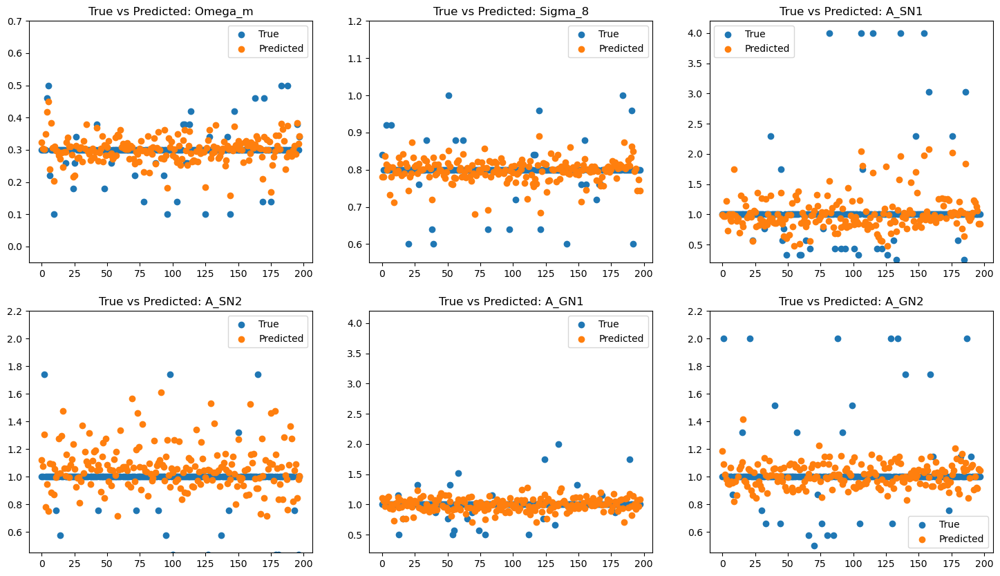

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0894 - mae: 0.2229 - mse: 0.1842 - val_loss: 0.0258 - val_mae: 0.0980 - val_mse: 0.0696 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0328 - mae: 0.1163 - mse: 0.0945 - val_loss: 0.0255 - val_mae: 0.1057 - val_mse: 0.0696 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0338 - mae: 0.1227 - mse: 0.1002 - val_loss: 0.0265 - val_mae: 0.1081 - val_mse: 0.0721 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0310 - mae: 0.1192 - mse: 0.0918 - val_loss: 0.0286 - val_mae: 0.1520 - val_mse: 0.0797 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - loss: 0.0334 - mae: 0.1287 - mse: 0.0992 - val_loss: 0.0251 - val_mae: 0.1046 - val_mse: 0.0683 - learning_rate:

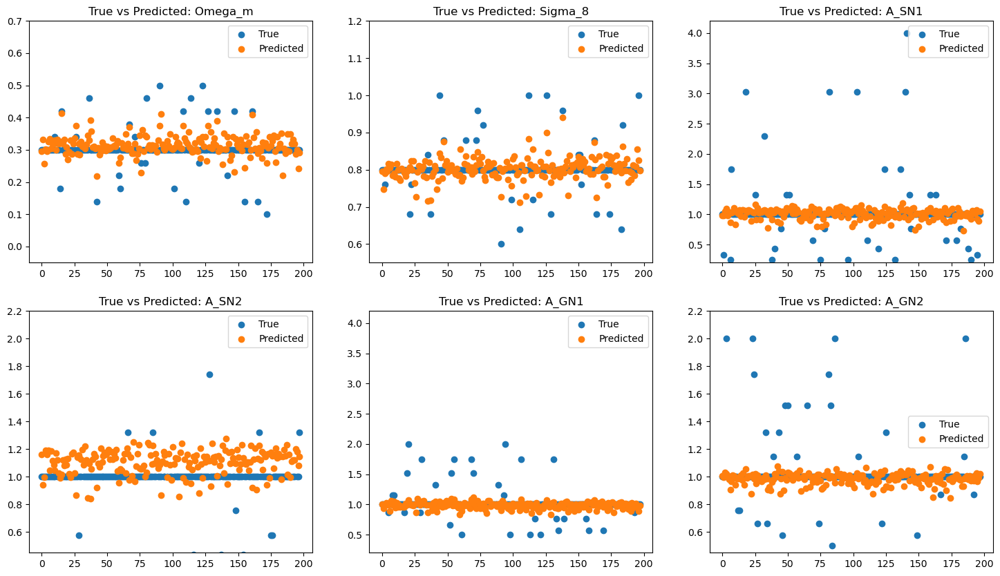

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0611 - mae: 0.1747 - mse: 0.1401 - val_loss: 0.0339 - val_mae: 0.1272 - val_mse: 0.0936 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0326 - mae: 0.1099 - mse: 0.0968 - val_loss: 0.0303 - val_mae: 0.0957 - val_mse: 0.0905 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0314 - mae: 0.1059 - mse: 0.0975 - val_loss: 0.0435 - val_mae: 0.1468 - val_mse: 0.1052 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0322 - mae: 0.1101 - mse: 0.0902 - val_loss: 0.0310 - val_mae: 0.1105 - val_mse: 0.0903 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0270 - mae: 0.0993 - mse: 0.0792 - val_loss: 0.0298 - val_mae: 0.0897 - val_mse: 0.0902 - learning_rate: 5.00

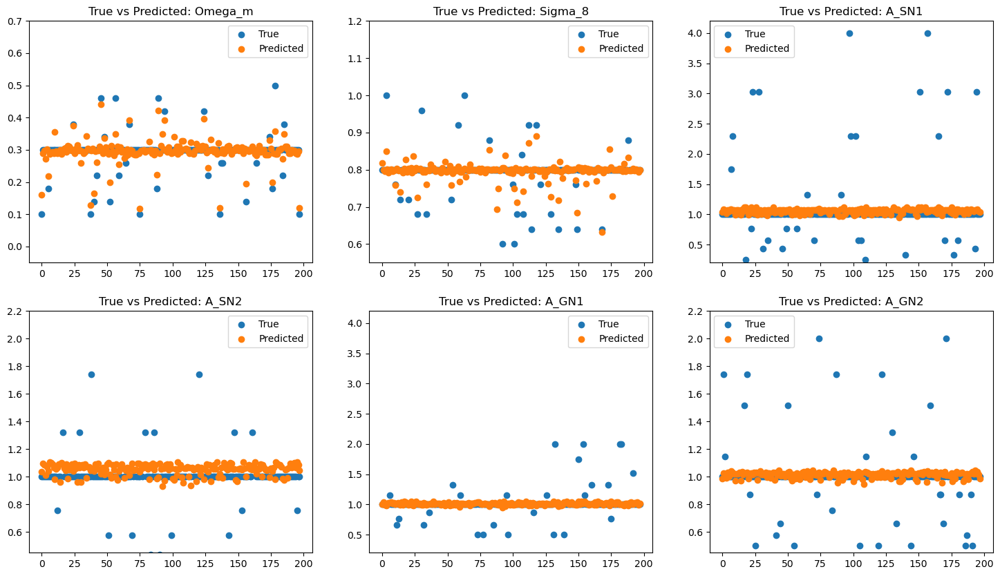

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0541 - mae: 0.1746 - mse: 0.1500 - val_loss: 0.0259 - val_mae: 0.1091 - val_mse: 0.0693 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0377 - mae: 0.1179 - mse: 0.1170 - val_loss: 0.0243 - val_mae: 0.1007 - val_mse: 0.0686 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0367 - mae: 0.1212 - mse: 0.1158 - val_loss: 0.0249 - val_mae: 0.1195 - val_mse: 0.0703 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0350 - mae: 0.1187 - mse: 0.1115 - val_loss: 0.0250 - val_mae: 0.0972 - val_mse: 0.0685 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0302 - mae: 0.1046 - mse: 0.0931 - val_loss: 0.0250 - val_mae: 0.1173 - val_mse: 0.0715 - learning_rate: 5.0000e-04
Ep

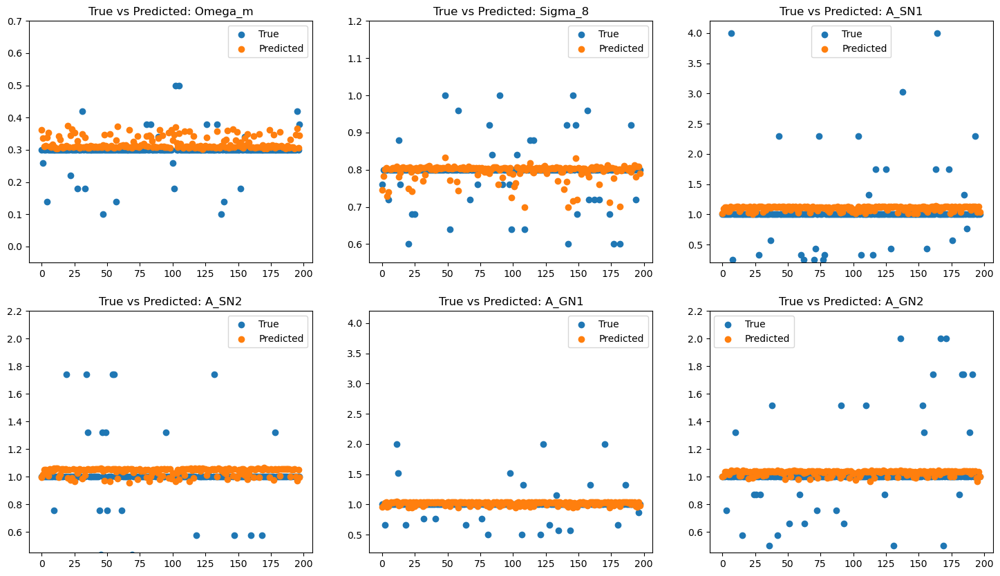

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0407 - mae: 0.1529 - mse: 0.1066 - val_loss: 0.0318 - val_mae: 0.1172 - val_mse: 0.0955 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0334 - mae: 0.1256 - mse: 0.0949 - val_loss: 0.0311 - val_mae: 0.1165 - val_mse: 0.0924 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0307 - mae: 0.1255 - mse: 0.0887 - val_loss: 0.0346 - val_mae: 0.1543 - val_mse: 0.1015 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0248 - mae: 0.1274 - mse: 0.0682 - val_loss: 0.0290 - val_mae: 0.1308 - val_mse: 0.0892 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0199 - mae: 0.1173 - mse: 0.0560 - val_loss: 0.0327 - val_mae: 0.1414 - val_mse: 0.0973 - learning_rate: 0.0010

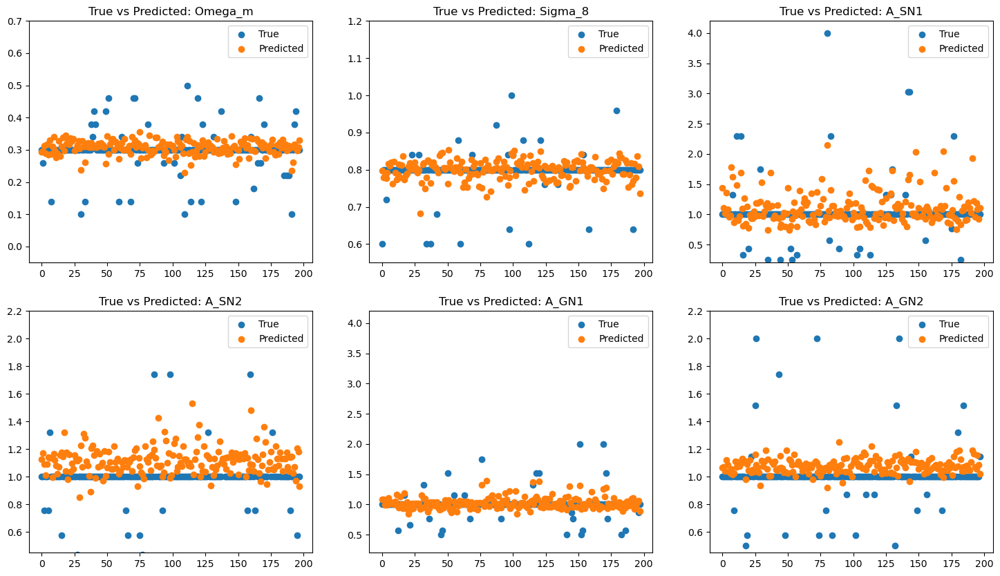

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 16ms/step - loss: 0.0485 - mae: 0.1616 - mse: 0.1212 - val_loss: 0.0379 - val_mae: 0.1156 - val_mse: 0.1171 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0351 - mae: 0.1146 - mse: 0.1065 - val_loss: 0.0378 - val_mae: 0.1099 - val_mse: 0.1177 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0410 - mae: 0.1239 - mse: 0.1340 - val_loss: 0.0369 - val_mae: 0.1220 - val_mse: 0.1154 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0271 - mae: 0.1028 - mse: 0.0799 - val_loss: 0.0375 - val_mae: 0.1517 - val_mse: 0.1164 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0355 - mae: 0.1258 - mse: 0.1102 - val_loss: 0.0368 - val_mae: 0.1165 - val_mse: 0.1155 - learning_rate: 0.0

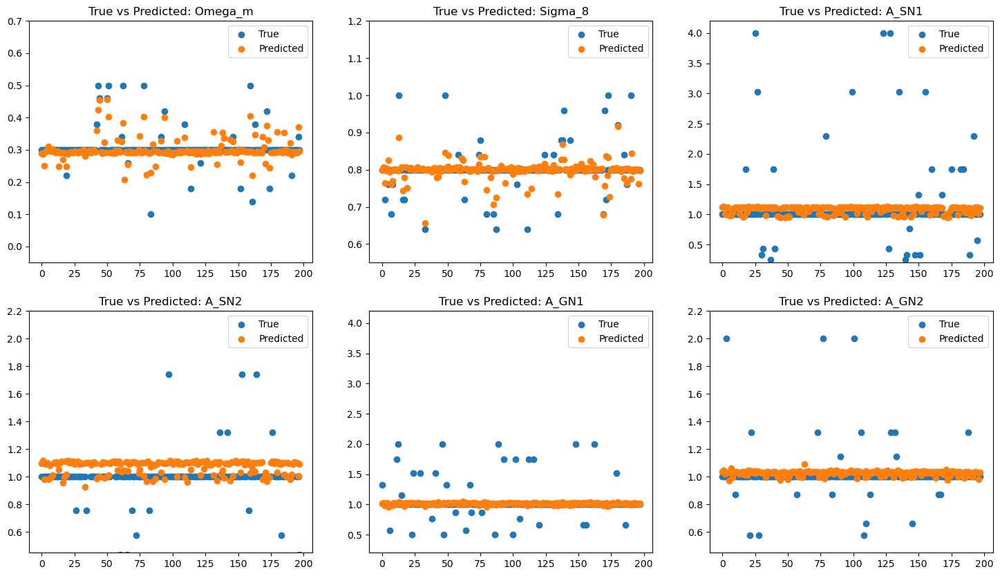

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0387 - mae: 0.1454 - mse: 0.1036 - val_loss: 0.0362 - val_mae: 0.1338 - val_mse: 0.1043 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0306 - mae: 0.1111 - mse: 0.0910 - val_loss: 0.0347 - val_mae: 0.1159 - val_mse: 0.1023 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0347 - mae: 0.1162 - mse: 0.1080 - val_loss: 0.0350 - val_mae: 0.0956 - val_mse: 0.1035 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0263 - mae: 0.0970 - mse: 0.0777 - val_loss: 0.0344 - val_mae: 0.1106 - val_mse: 0.1012 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0293 - mae: 0.1131 - mse: 0.0866 - val_loss: 0.0348 - val_mae: 0.1117 - val_mse: 0.1030 - learning_rate: 0

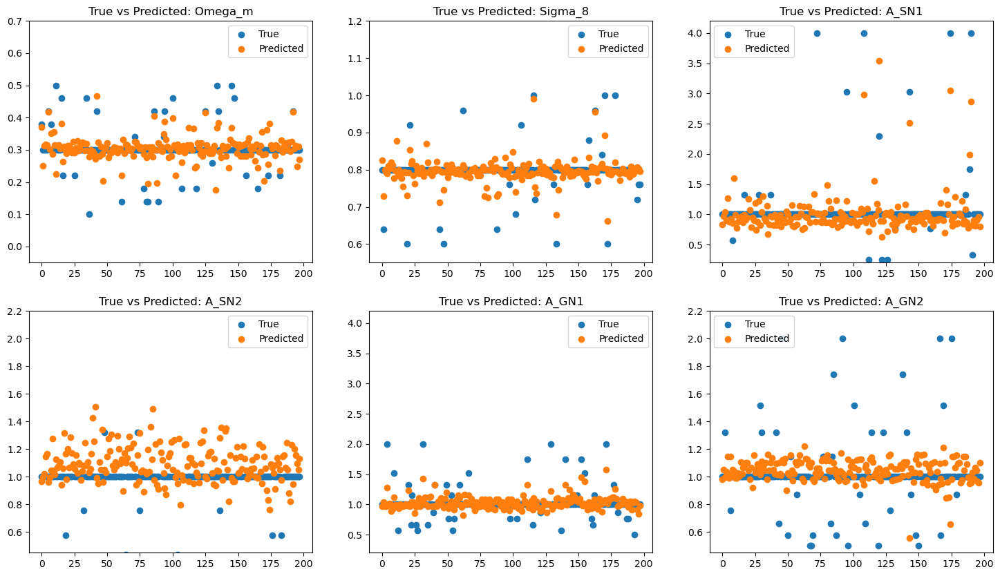

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0505 - mae: 0.1615 - mse: 0.1411 - val_loss: 0.0316 - val_mae: 0.1075 - val_mse: 0.0905 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0355 - mae: 0.1223 - mse: 0.1024 - val_loss: 0.0320 - val_mae: 0.1296 - val_mse: 0.0910 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0301 - mae: 0.1127 - mse: 0.0896 - val_loss: 0.0341 - val_mae: 0.1425 - val_mse: 0.0976 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0358 - mae: 0.1327 - mse: 0.1115 - val_loss: 0.0317 - val_mae: 0.1175 - val_mse: 0.0901 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0312 - mae: 0.1223 - mse: 0.0969 - val_loss: 0.0307 - val_mae: 0.1130 - val_mse: 0.0885 - learning_rate: 5.0000e

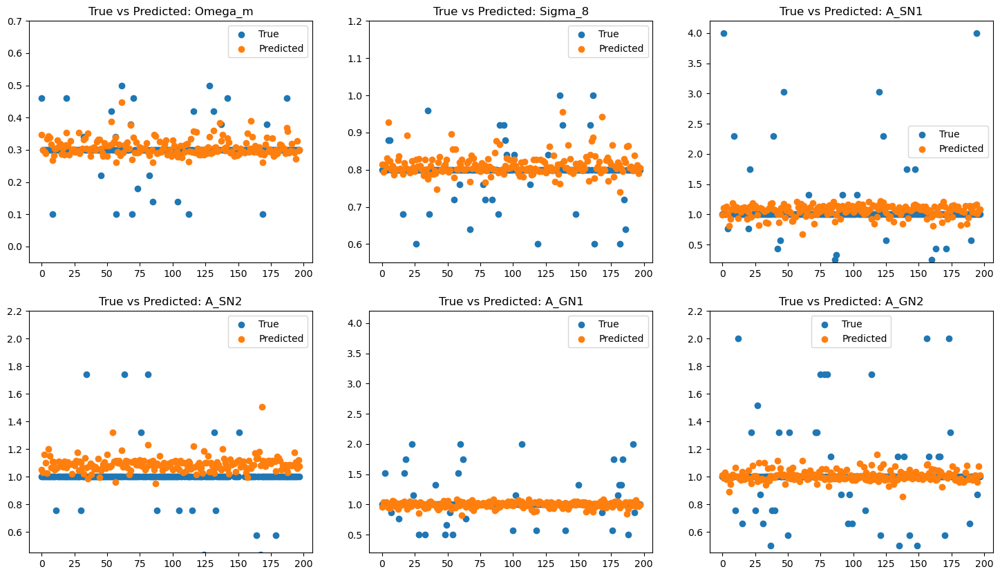

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0451 - mae: 0.1708 - mse: 0.1231 - val_loss: 0.0381 - val_mae: 0.1011 - val_mse: 0.1252 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0328 - mae: 0.1158 - mse: 0.0935 - val_loss: 0.0389 - val_mae: 0.1349 - val_mse: 0.1262 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0362 - mae: 0.1252 - mse: 0.1115 - val_loss: 0.0375 - val_mae: 0.0994 - val_mse: 0.1230 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - loss: 0.0333 - mae: 0.1091 - mse: 0.0985 - val_loss: 0.0377 - val_mae: 0.1080 - val_mse: 0.1230 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0356 - mae: 0.1136 - mse: 0.1051 - val_loss: 0.0373 - val_mae: 0.0988 - val_mse: 0.1235 - learning_rate: 0.001

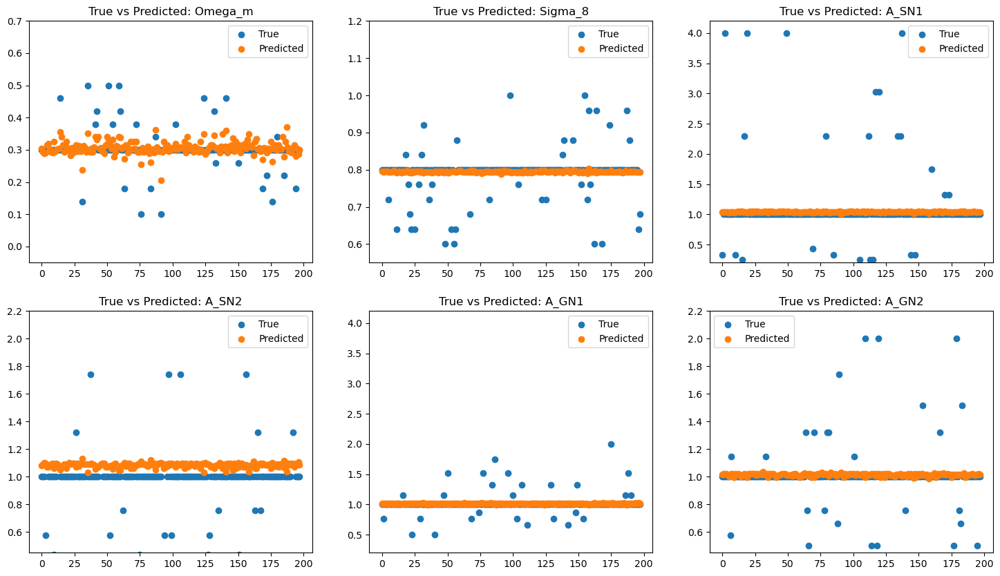

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0427 - mae: 0.1455 - mse: 0.1182 - val_loss: 0.0327 - val_mae: 0.1340 - val_mse: 0.0955 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0329 - mae: 0.1154 - mse: 0.0997 - val_loss: 0.0318 - val_mae: 0.1116 - val_mse: 0.0944 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0332 - mae: 0.1113 - mse: 0.0981 - val_loss: 0.0320 - val_mae: 0.1085 - val_mse: 0.0940 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0336 - mae: 0.1148 - mse: 0.1042 - val_loss: 0.0320 - val_mae: 0.1374 - val_mse: 0.0953 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0353 - mae: 0.1280 - mse: 0.1134 - val_loss: 0.0296 - val_mae: 0.1119 - val_mse: 0.0887 - learning_rate: 5.0000e-04
E

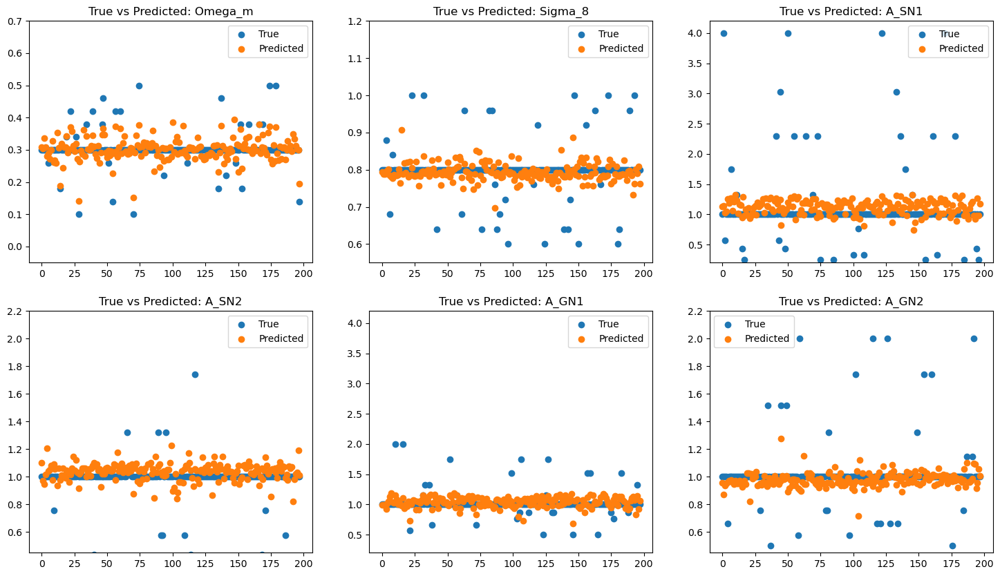

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0601 - mae: 0.1776 - mse: 0.1394 - val_loss: 0.0344 - val_mae: 0.1461 - val_mse: 0.0815 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0275 - mae: 0.1206 - mse: 0.0778 - val_loss: 0.0295 - val_mae: 0.1366 - val_mse: 0.0752 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0237 - mae: 0.1135 - mse: 0.0641 - val_loss: 0.0298 - val_mae: 0.1265 - val_mse: 0.0776 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 10s 16ms/step - loss: 0.0248 - mae: 0.1168 - mse: 0.0688 - val_loss: 0.0252 - val_mae: 0.1168 - val_mse: 0.0687 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 16ms/step - loss: 0.0237 - mae: 0.1151 - mse: 0.0692 - val_loss: 0.0248 - val_mae: 0.1070 - val_mse: 0.0686 - learning_rate: 0.0010
Ep

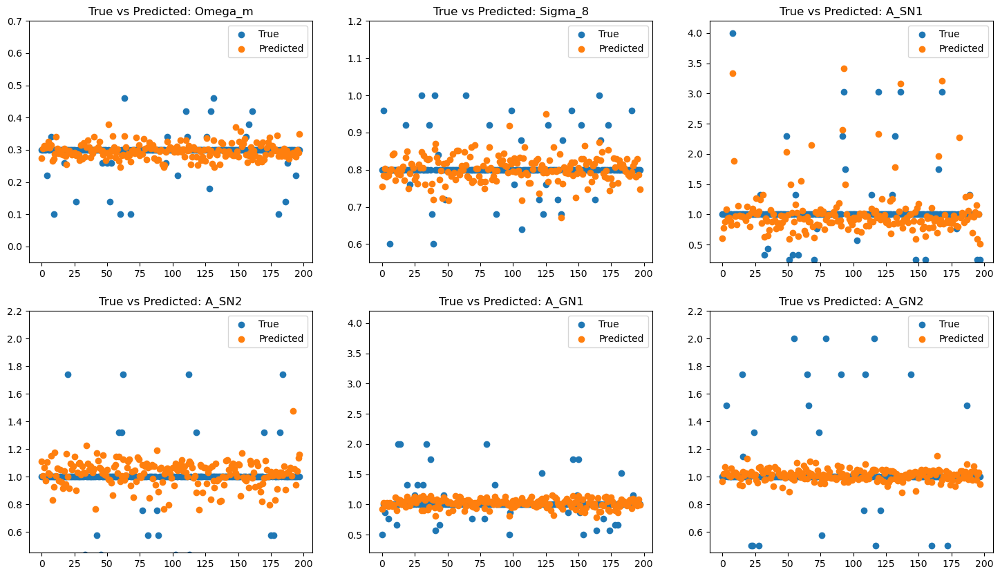

In [232]:
modelC_loss = test_models(create_modelC, (256,256,1))

### Model D

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0454 - mae: 0.1585 - mse: 0.1207 - val_loss: 0.0326 - val_mae: 0.1376 - val_mse: 0.0957 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0314 - mae: 0.1210 - mse: 0.0896 - val_loss: 0.0318 - val_mae: 0.1146 - val_mse: 0.0940 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0276 - mae: 0.1174 - mse: 0.0773 - val_loss: 0.0293 - val_mae: 0.1131 - val_mse: 0.0912 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0265 - mae: 0.1127 - mse: 0.0761 - val_loss: 0.0283 - val_mae: 0.1216 - val_mse: 0.0874 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0308 - mae: 0.1326 - mse: 0.0878 - val_loss: 0.0300 - val_mae: 0.1102 - val_mse: 0.0919 - learning_rate: 0.0010
Epoch 6/20


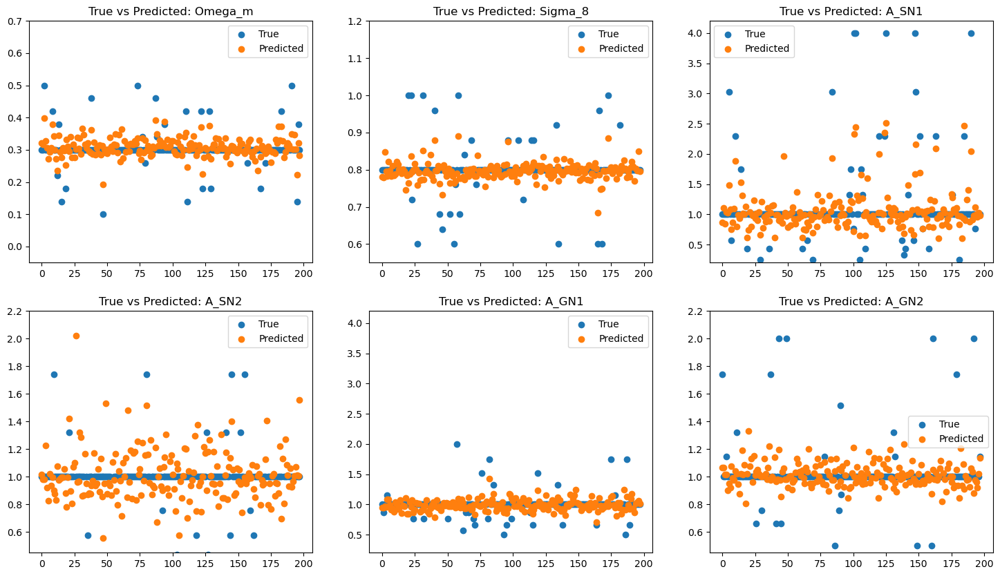

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0652 - mae: 0.1744 - mse: 0.1587 - val_loss: 0.0341 - val_mae: 0.1209 - val_mse: 0.0994 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0389 - mae: 0.1321 - mse: 0.1128 - val_loss: 0.0309 - val_mae: 0.1060 - val_mse: 0.0909 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0332 - mae: 0.1179 - mse: 0.1017 - val_loss: 0.0333 - val_mae: 0.1544 - val_mse: 0.0962 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0315 - mae: 0.1214 - mse: 0.0961 - val_loss: 0.0316 - val_mae: 0.1333 - val_mse: 0.0926 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0379 - mae: 0.1330 - mse: 0.1157 - val_loss: 0.0307 - val_mae: 0.0968 - val_mse: 0.0911 - learning_rate: 5.0000e-0

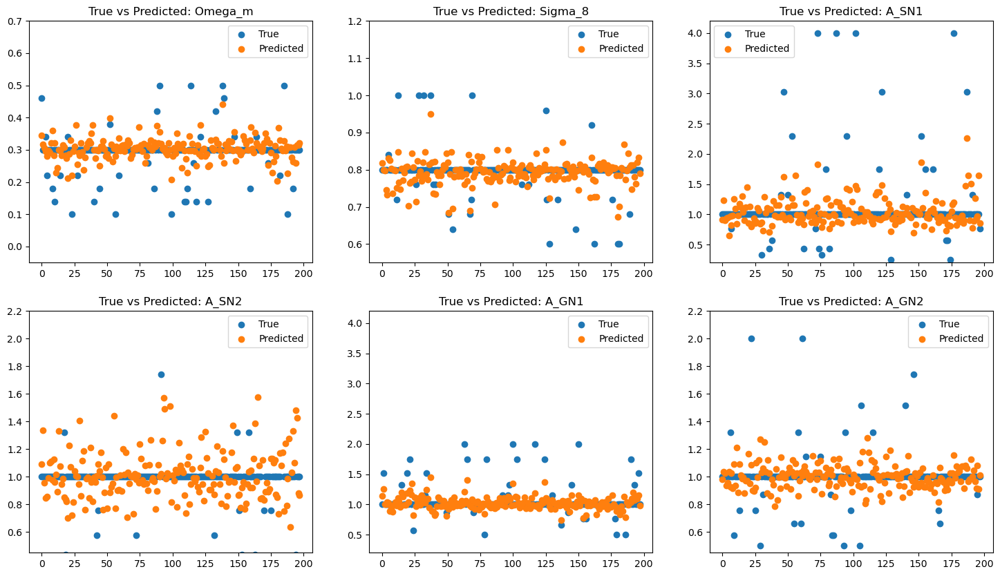

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0605 - mae: 0.1723 - mse: 0.1509 - val_loss: 0.0341 - val_mae: 0.1057 - val_mse: 0.0941 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0358 - mae: 0.1200 - mse: 0.1136 - val_loss: 0.0340 - val_mae: 0.1106 - val_mse: 0.0919 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0335 - mae: 0.1189 - mse: 0.1012 - val_loss: 0.0328 - val_mae: 0.1097 - val_mse: 0.0908 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0400 - mae: 0.1268 - mse: 0.1187 - val_loss: 0.0321 - val_mae: 0.0948 - val_mse: 0.0897 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0351 - mae: 0.1167 - mse: 0.1046 - val_loss: 0.0325 - val_mae: 0.1187 - val_mse: 0.0903 - learning_rate: 0.0010
Epoch 6

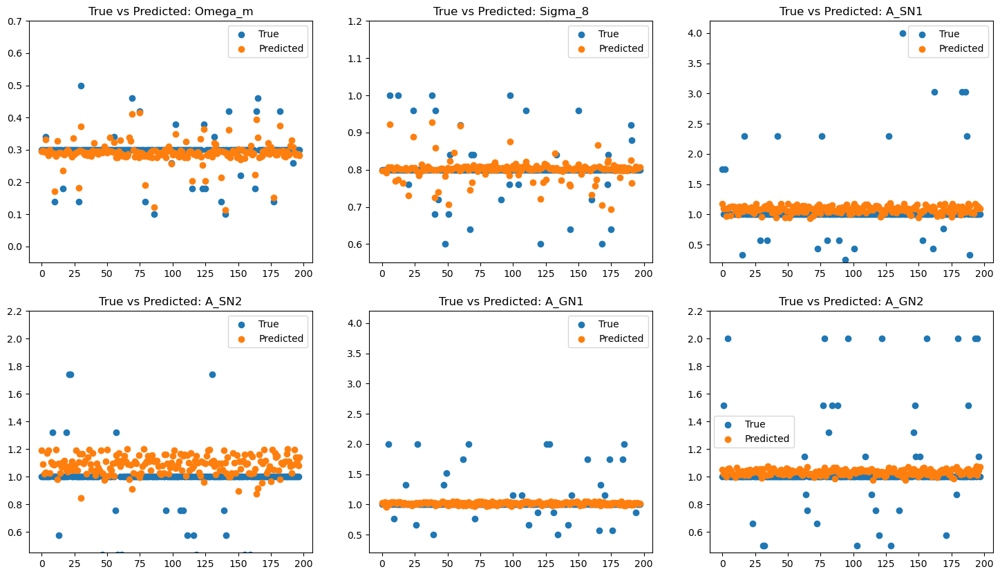

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0470 - mae: 0.1533 - mse: 0.1317 - val_loss: 0.0286 - val_mae: 0.1297 - val_mse: 0.0806 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0341 - mae: 0.1182 - mse: 0.0994 - val_loss: 0.0280 - val_mae: 0.1101 - val_mse: 0.0797 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0318 - mae: 0.1182 - mse: 0.0960 - val_loss: 0.0274 - val_mae: 0.0950 - val_mse: 0.0797 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0327 - mae: 0.1152 - mse: 0.0957 - val_loss: 0.0310 - val_mae: 0.1429 - val_mse: 0.0880 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0287 - mae: 0.1119 - mse: 0.0842 - val_loss: 0.0341 - val_mae: 0.1652 - val_mse: 0.0978 - learning_rate: 0.0010
Epoch 6/20
594/

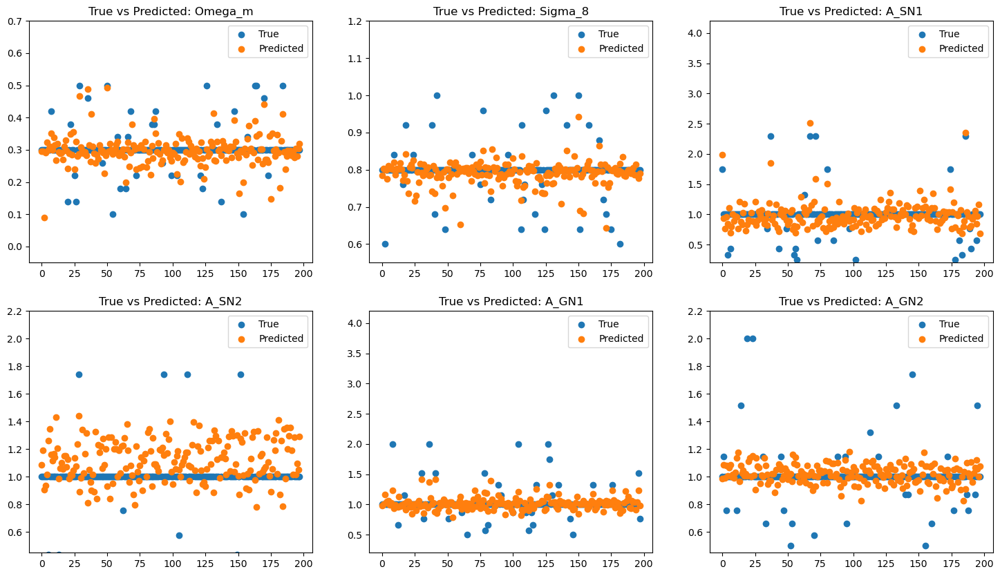

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0353 - mae: 0.1343 - mse: 0.0968 - val_loss: 0.0345 - val_mae: 0.1123 - val_mse: 0.1028 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0373 - mae: 0.1433 - mse: 0.1151 - val_loss: 0.0318 - val_mae: 0.1169 - val_mse: 0.0945 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0246 - mae: 0.1215 - mse: 0.0714 - val_loss: 0.0338 - val_mae: 0.1391 - val_mse: 0.0933 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0260 - mae: 0.1275 - mse: 0.0769 - val_loss: 0.0326 - val_mae: 0.1297 - val_mse: 0.0982 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0203 - mae: 0.1020 - mse: 0.0594 - val_loss: 0.0335 - val_mae: 0.1407 - val_mse: 0.1017 - learning_rate: 5.0000e-04
Epo

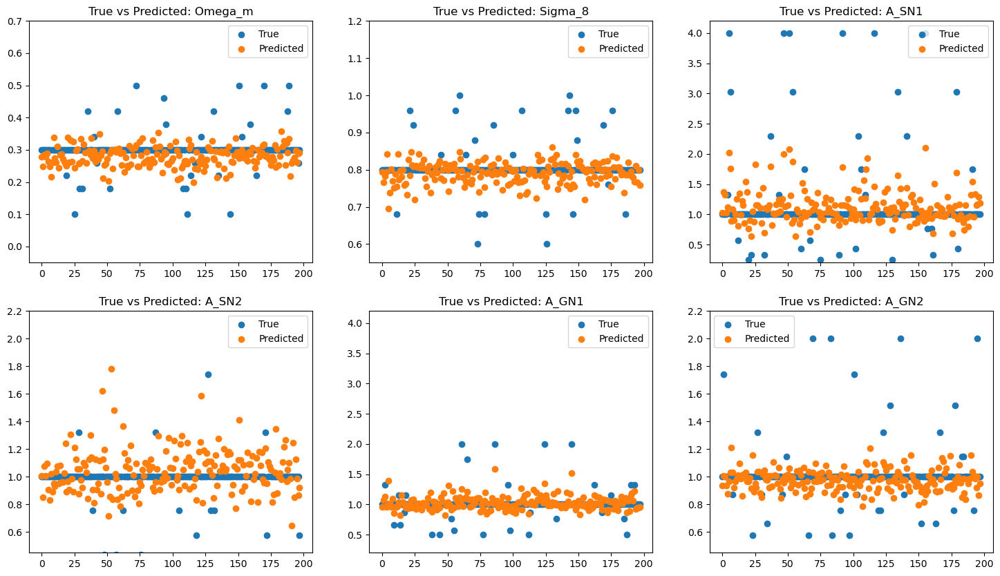

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0446 - mae: 0.1499 - mse: 0.1175 - val_loss: 0.0340 - val_mae: 0.1336 - val_mse: 0.0937 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0359 - mae: 0.1256 - mse: 0.1094 - val_loss: 0.0305 - val_mae: 0.1152 - val_mse: 0.0920 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0337 - mae: 0.1232 - mse: 0.1018 - val_loss: 0.0305 - val_mae: 0.0896 - val_mse: 0.0916 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0324 - mae: 0.1124 - mse: 0.0993 - val_loss: 0.0322 - val_mae: 0.1198 - val_mse: 0.0937 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0306 - mae: 0.1065 - mse: 0.0889 - val_loss: 0.0304 - val_mae: 0.1015 - val_mse: 0.0913 - learning_rate: 5.0000e-04
Ep

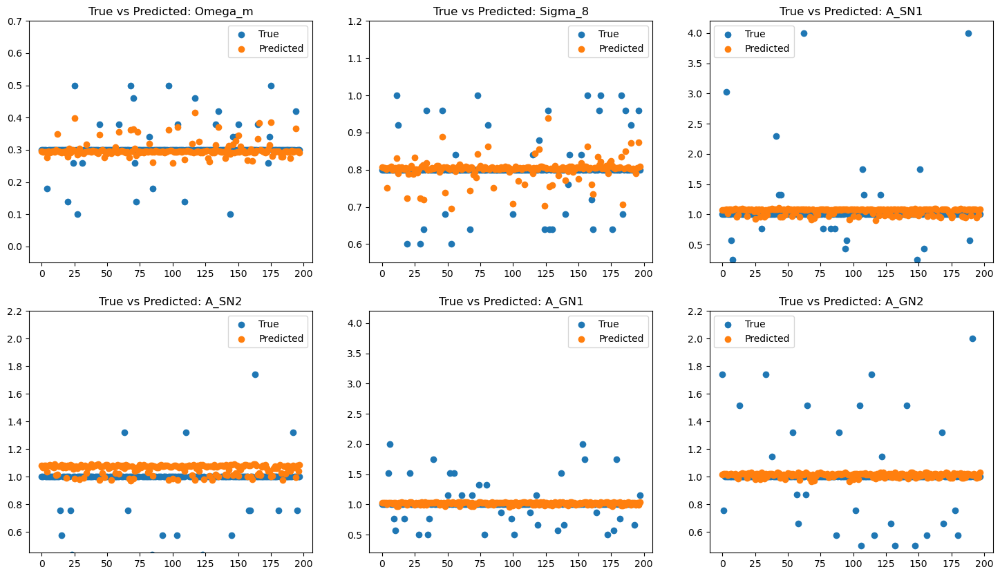

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0387 - mae: 0.1463 - mse: 0.1052 - val_loss: 0.0356 - val_mae: 0.1092 - val_mse: 0.0990 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0370 - mae: 0.1255 - mse: 0.1155 - val_loss: 0.0353 - val_mae: 0.1270 - val_mse: 0.0990 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0329 - mae: 0.1202 - mse: 0.0975 - val_loss: 0.0337 - val_mae: 0.1057 - val_mse: 0.0955 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0334 - mae: 0.1190 - mse: 0.1015 - val_loss: 0.0331 - val_mae: 0.1074 - val_mse: 0.0950 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0346 - mae: 0.1160 - mse: 0.1085 - val_loss: 0.0327 - val_mae: 0.1160 - val_mse: 0.0945 - learning_rate: 0.0010
Epo

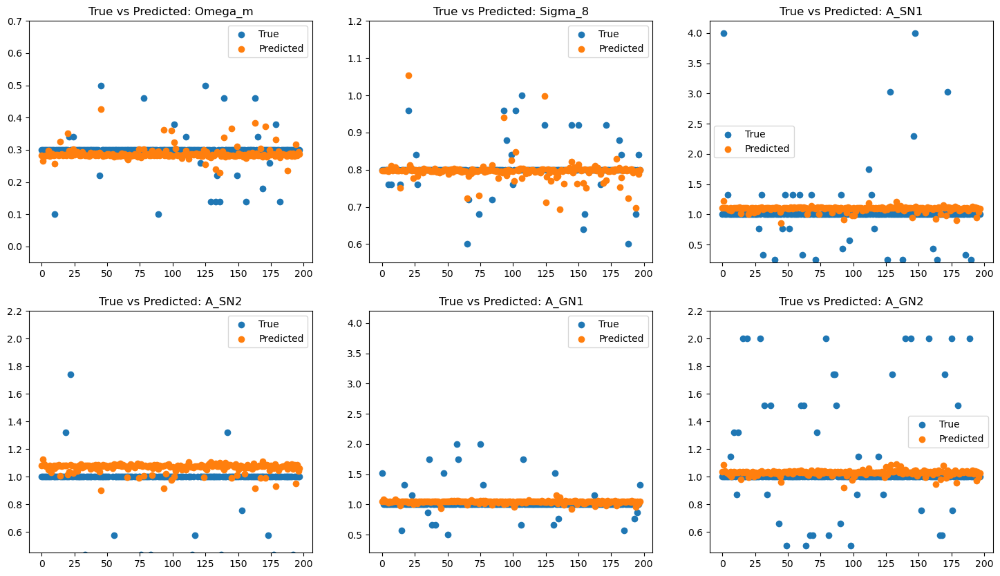

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0376 - mae: 0.1350 - mse: 0.1044 - val_loss: 0.0422 - val_mae: 0.2086 - val_mse: 0.1209 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0361 - mae: 0.1266 - mse: 0.1134 - val_loss: 0.0342 - val_mae: 0.1153 - val_mse: 0.1028 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0374 - mae: 0.1275 - mse: 0.1056 - val_loss: 0.0338 - val_mae: 0.1086 - val_mse: 0.1011 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 0.0304 - mae: 0.1120 - mse: 0.0901 - val_loss: 0.0325 - val_mae: 0.1085 - val_mse: 0.0983 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0376 - mae: 0.1320 - mse: 0.1144 - val_loss: 0.0352 - val_mae: 0.1278 - val_mse: 0.1060 - learning_rate: 0.0010
Epoch 6/20


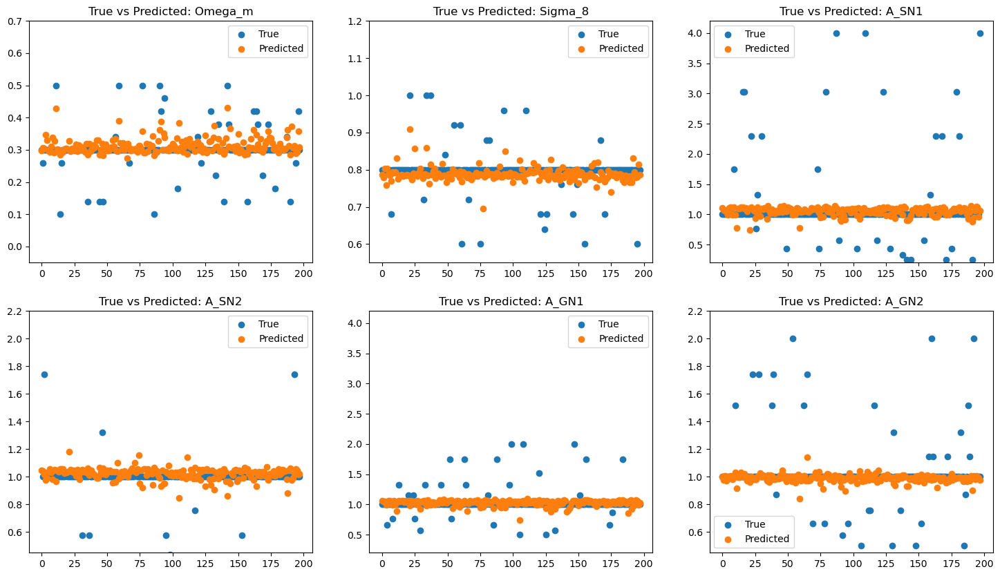

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0520 - mae: 0.1563 - mse: 0.1253 - val_loss: 0.0356 - val_mae: 0.1377 - val_mse: 0.1095 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0337 - mae: 0.1214 - mse: 0.0989 - val_loss: 0.0352 - val_mae: 0.1217 - val_mse: 0.1056 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0301 - mae: 0.1121 - mse: 0.0906 - val_loss: 0.0339 - val_mae: 0.1099 - val_mse: 0.1041 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0328 - mae: 0.1127 - mse: 0.1005 - val_loss: 0.0347 - val_mae: 0.1181 - val_mse: 0.1051 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0297 - mae: 0.1076 - mse: 0.0871 - val_loss: 0.0342 - val_mae: 0.1027 - val_mse: 0.1046 - learning_rate: 0.0010
Epoch 

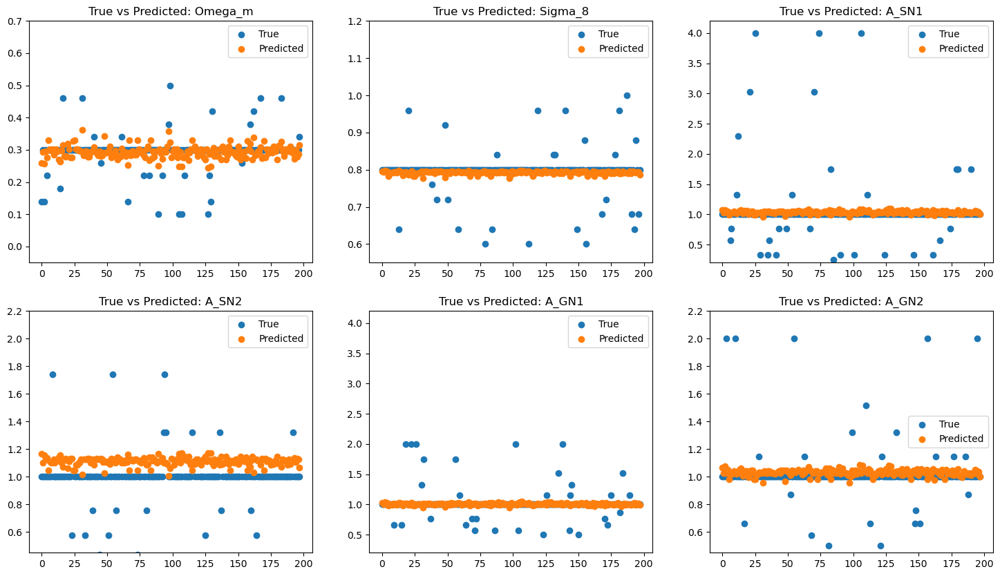

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0479 - mae: 0.1473 - mse: 0.1126 - val_loss: 0.0331 - val_mae: 0.1188 - val_mse: 0.0920 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0343 - mae: 0.1196 - mse: 0.1063 - val_loss: 0.0306 - val_mae: 0.1103 - val_mse: 0.0919 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0360 - mae: 0.1188 - mse: 0.1079 - val_loss: 0.0311 - val_mae: 0.1114 - val_mse: 0.0918 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0390 - mae: 0.1259 - mse: 0.1202 - val_loss: 0.0535 - val_mae: 0.1827 - val_mse: 0.1203 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0342 - mae: 0.1217 - mse: 0.1025 - val_loss: 0.0300 - val_mae: 0.1277 - val_mse: 0.0887 - learning_rate: 5.0000e-04
Epoch 6/20

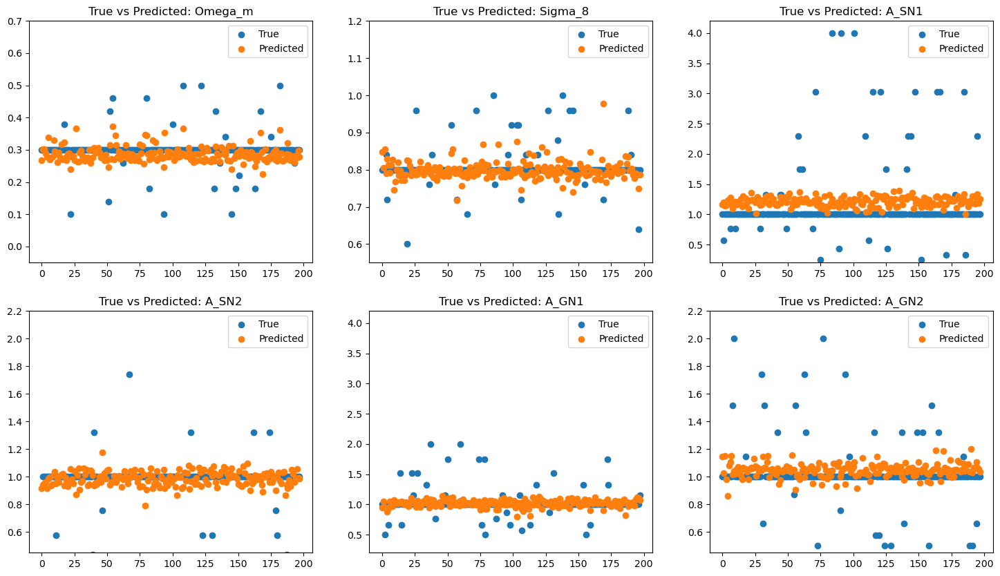

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - loss: 0.0414 - mae: 0.1538 - mse: 0.1010 - val_loss: 0.0276 - val_mae: 0.1279 - val_mse: 0.0790 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0344 - mae: 0.1359 - mse: 0.0952 - val_loss: 0.0263 - val_mae: 0.1166 - val_mse: 0.0725 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0250 - mae: 0.1215 - mse: 0.0692 - val_loss: 0.0253 - val_mae: 0.1067 - val_mse: 0.0722 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0224 - mae: 0.1102 - mse: 0.0567 - val_loss: 0.0438 - val_mae: 0.1953 - val_mse: 0.1302 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0188 - mae: 0.1111 - mse: 0.0502 - val_loss: 0.0248 - val_mae: 0.1209 - val_mse: 0.0699 - learning_rate: 0.0010
Epoch 6/20


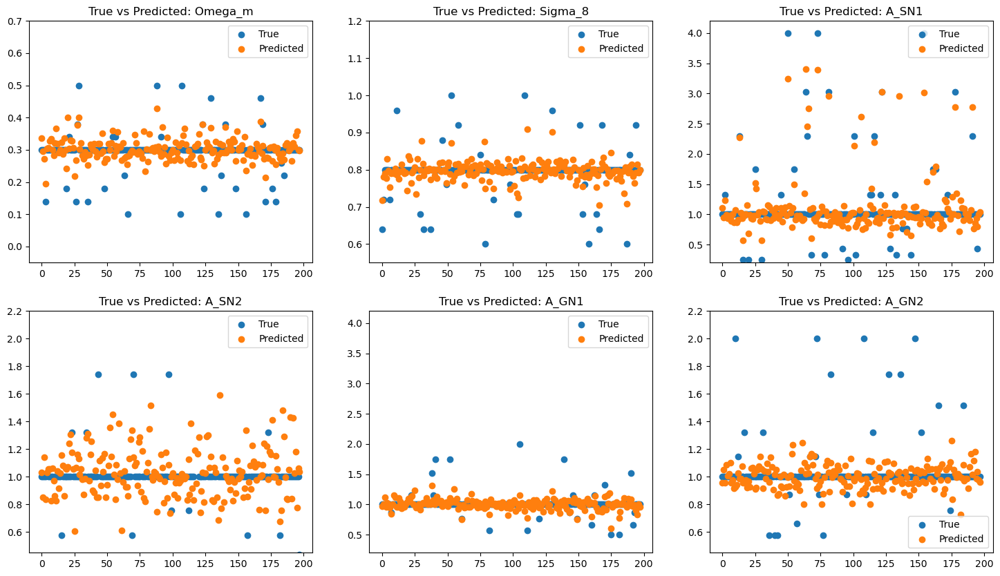

In [233]:
modelD_loss = test_models(create_modelD, (256,256,1))

### Model E

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0480 - mae: 0.1540 - mse: 0.1280 - val_loss: 0.0316 - val_mae: 0.1351 - val_mse: 0.0874 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0405 - mae: 0.1422 - mse: 0.1281 - val_loss: 0.0290 - val_mae: 0.1317 - val_mse: 0.0786 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0334 - mae: 0.1281 - mse: 0.1005 - val_loss: 0.0263 - val_mae: 0.1041 - val_mse: 0.0759 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0361 - mae: 0.1404 - mse: 0.1110 - val_loss: 0.0257 - val_mae: 0.1063 - val_mse: 0.0734 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0281 - mae: 0.1167 - mse: 0.0780 - val_loss: 0.0281 - val_mae: 0.1208 - val_mse: 0.0802 - learning_rate: 0.0010
Epoch 

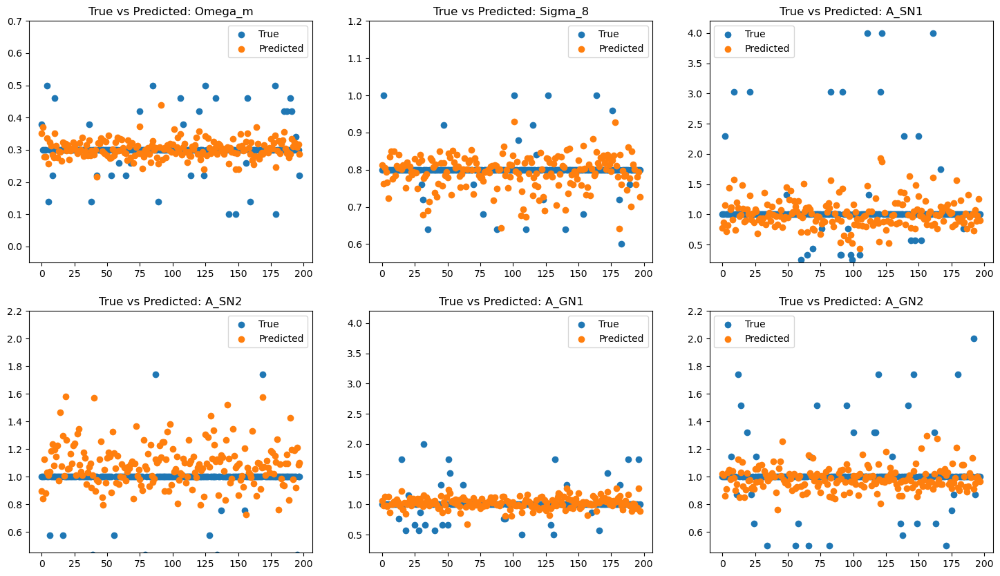

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 12ms/step - loss: 0.0496 - mae: 0.1629 - mse: 0.1263 - val_loss: 0.0340 - val_mae: 0.1210 - val_mse: 0.0961 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0273 - mae: 0.1128 - mse: 0.0750 - val_loss: 0.0316 - val_mae: 0.1091 - val_mse: 0.0943 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0332 - mae: 0.1209 - mse: 0.0978 - val_loss: 0.0358 - val_mae: 0.1266 - val_mse: 0.1014 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0316 - mae: 0.1132 - mse: 0.0949 - val_loss: 0.0359 - val_mae: 0.1289 - val_mse: 0.1068 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0479 - mae: 0.1163 - mse: 0.0938 - val_loss: 0.0313 - val_mae: 0.1190 - val_mse: 0.0932 - learning_rate: 5.00

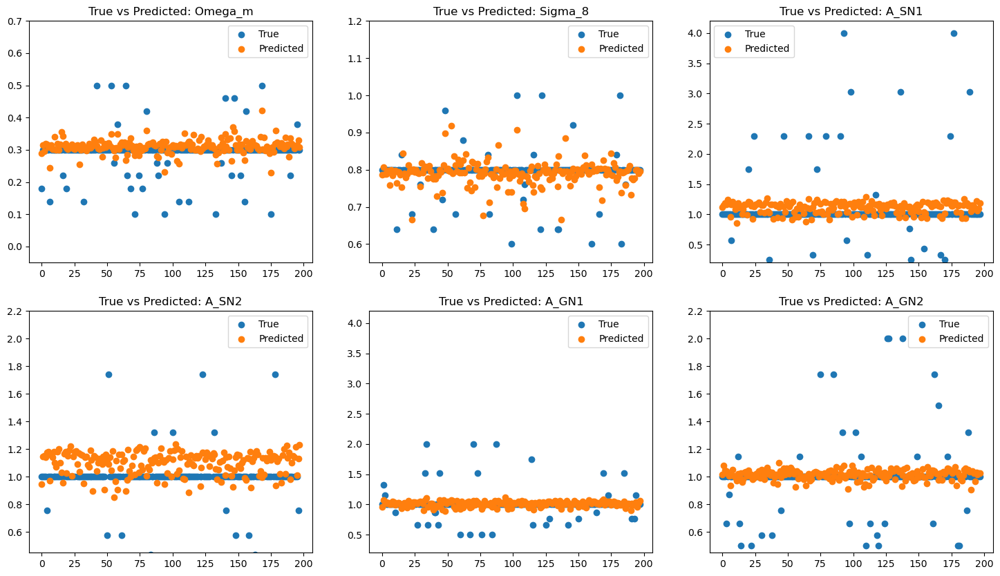

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0426 - mae: 0.1531 - mse: 0.1122 - val_loss: 0.0290 - val_mae: 0.1110 - val_mse: 0.0908 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0398 - mae: 0.1275 - mse: 0.1237 - val_loss: 0.0303 - val_mae: 0.1155 - val_mse: 0.0934 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 0.0384 - mae: 0.1267 - mse: 0.1183 - val_loss: 0.0301 - val_mae: 0.0981 - val_mse: 0.0944 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0337 - mae: 0.1107 - mse: 0.1024 - val_loss: 0.0295 - val_mae: 0.1055 - val_mse: 0.0921 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0286 - mae: 0.0980 - mse: 0.0879 - val_loss: 0.0290 - val_mae: 0.1219 - val_mse: 0.0915 - learning_rate: 5.000

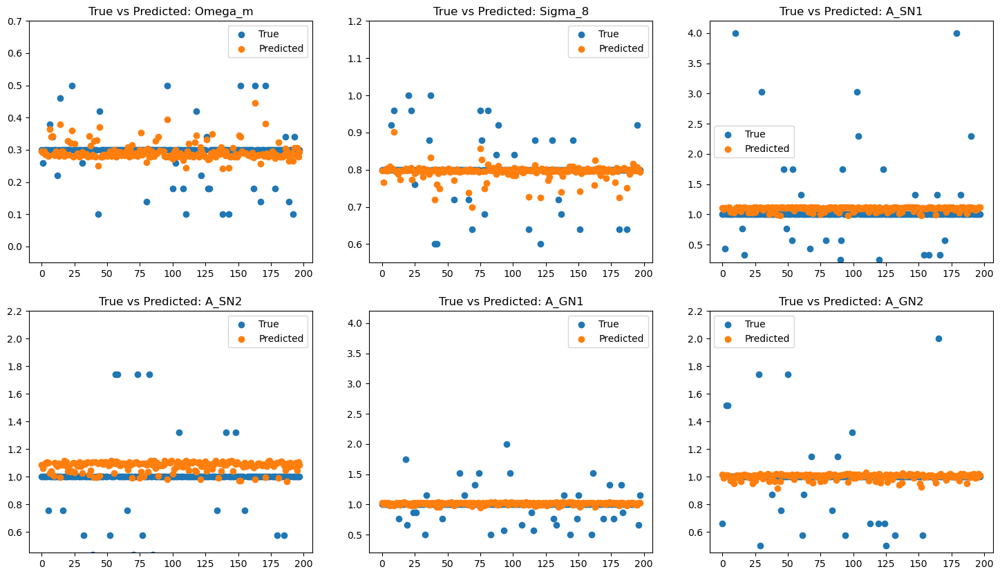

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0401 - mae: 0.1379 - mse: 0.1036 - val_loss: 0.0387 - val_mae: 0.0990 - val_mse: 0.1221 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0327 - mae: 0.1148 - mse: 0.0957 - val_loss: 0.0379 - val_mae: 0.1025 - val_mse: 0.1205 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0286 - mae: 0.1047 - mse: 0.0847 - val_loss: 0.0378 - val_mae: 0.1084 - val_mse: 0.1163 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0300 - mae: 0.1094 - mse: 0.0871 - val_loss: 0.0383 - val_mae: 0.1540 - val_mse: 0.1171 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0341 - mae: 0.1265 - mse: 0.1024 - val_loss: 0.0362 - val_mae: 0.1235 - val_mse: 0.1127 - learning_rate: 0.0010
Epoch 6/20

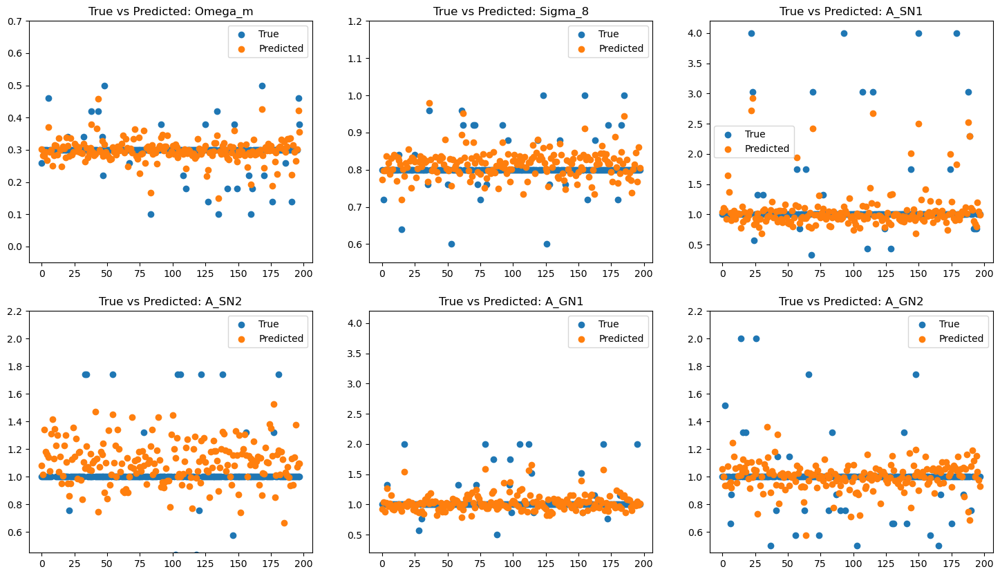

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 0.0369 - mae: 0.1356 - mse: 0.0997 - val_loss: 0.0418 - val_mae: 0.1929 - val_mse: 0.1220 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0325 - mae: 0.1306 - mse: 0.0940 - val_loss: 0.0349 - val_mae: 0.1266 - val_mse: 0.1047 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0272 - mae: 0.1276 - mse: 0.0740 - val_loss: 0.0358 - val_mae: 0.1428 - val_mse: 0.1053 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0273 - mae: 0.1285 - mse: 0.0789 - val_loss: 0.0442 - val_mae: 0.1791 - val_mse: 0.1209 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0228 - mae: 0.1203 - mse: 0.0618 - val_loss: 0.0355 - val_mae: 0.1407 - val_mse: 0.1062 - learning_rate: 5.0000e-0

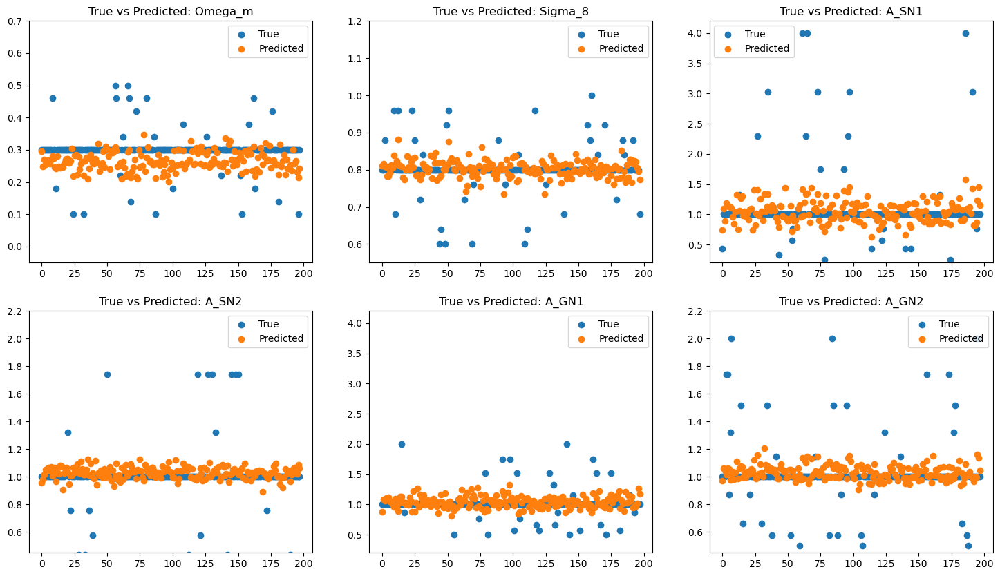

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0410 - mae: 0.1489 - mse: 0.1074 - val_loss: 0.0311 - val_mae: 0.1061 - val_mse: 0.0941 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0343 - mae: 0.1201 - mse: 0.1006 - val_loss: 0.0315 - val_mae: 0.1195 - val_mse: 0.0948 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0375 - mae: 0.1251 - mse: 0.1149 - val_loss: 0.0312 - val_mae: 0.1141 - val_mse: 0.0931 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0367 - mae: 0.1231 - mse: 0.1166 - val_loss: 0.0295 - val_mae: 0.1170 - val_mse: 0.0921 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0316 - mae: 0.1101 - mse: 0.0969 - val_loss: 0.0295 - val_mae: 0.1052 - val_mse: 0.0922 - learning_rate: 5.00

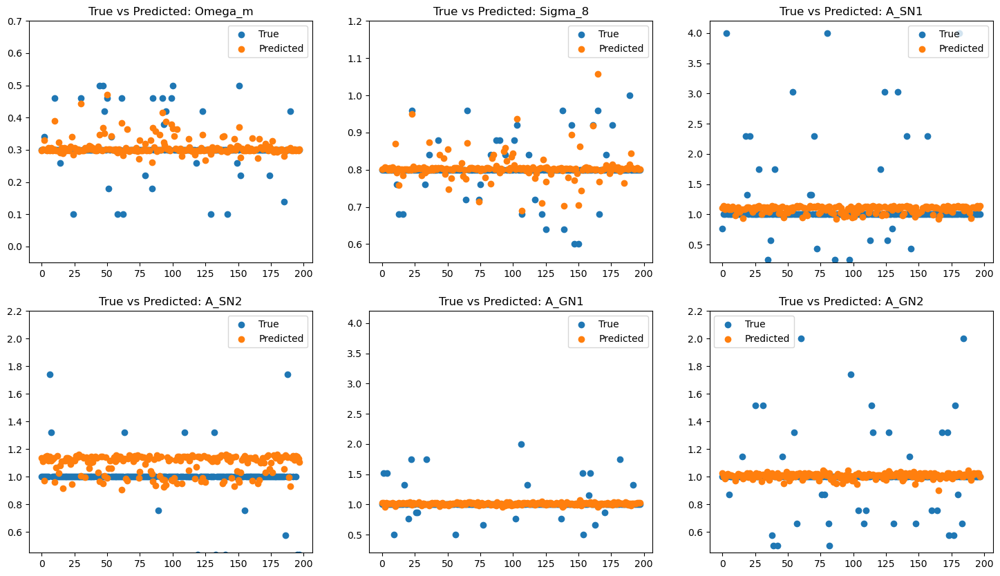

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 10ms/step - loss: 0.0429 - mae: 0.1389 - mse: 0.1206 - val_loss: 0.0338 - val_mae: 0.1010 - val_mse: 0.0992 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0240 - mae: 0.0965 - mse: 0.0662 - val_loss: 0.0348 - val_mae: 0.1132 - val_mse: 0.1040 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0296 - mae: 0.1044 - mse: 0.0852 - val_loss: 0.0334 - val_mae: 0.1025 - val_mse: 0.0977 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0256 - mae: 0.0966 - mse: 0.0719 - val_loss: 0.0327 - val_mae: 0.1107 - val_mse: 0.0967 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0283 - mae: 0.1046 - mse: 0.0808 - val_loss: 0.0342 - val_mae: 0.1282 - val_mse: 0.0990 - learning_rate: 0.001

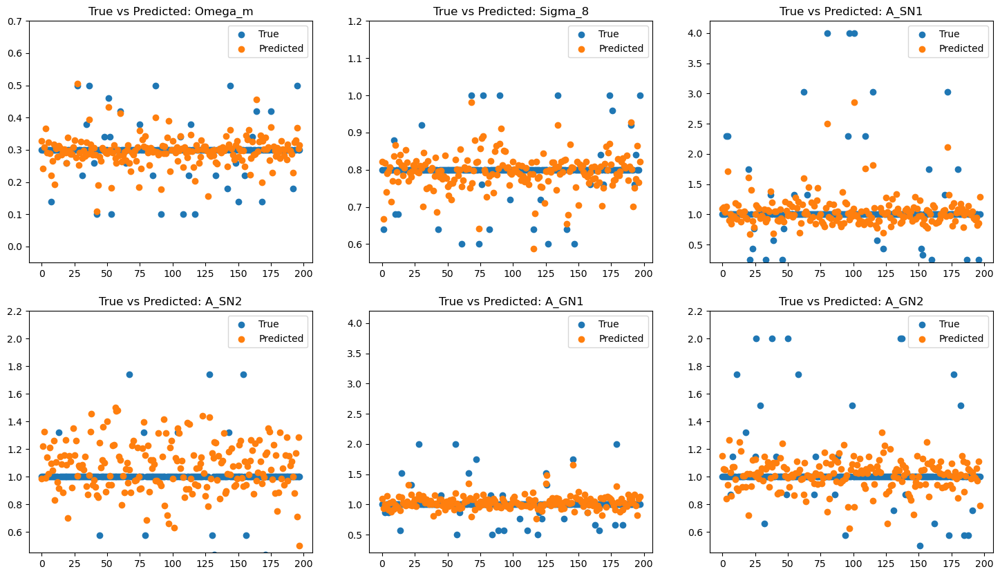

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0518 - mae: 0.1574 - mse: 0.1475 - val_loss: 0.0252 - val_mae: 0.1179 - val_mse: 0.0713 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0407 - mae: 0.1348 - mse: 0.1264 - val_loss: 0.0264 - val_mae: 0.1198 - val_mse: 0.0740 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0412 - mae: 0.1371 - mse: 0.1275 - val_loss: 0.0259 - val_mae: 0.1083 - val_mse: 0.0725 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0339 - mae: 0.1174 - mse: 0.1039 - val_loss: 0.0247 - val_mae: 0.1185 - val_mse: 0.0706 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0266 - mae: 0.1144 - mse: 0.0794 - val_loss: 0.0250 - val_mae: 0.1131 - val_mse: 0.0709 - learning_rate: 5.0000e-0

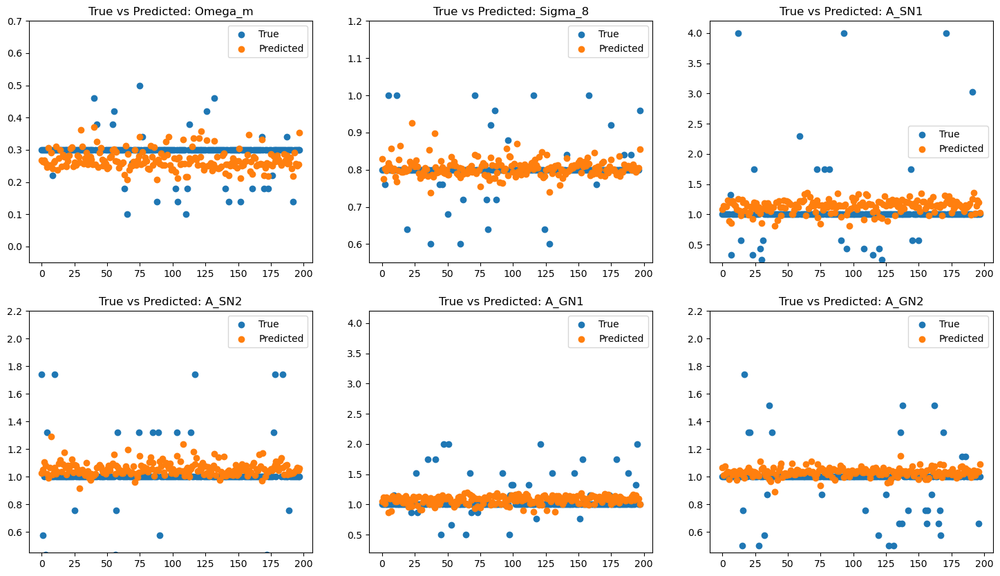

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 10ms/step - loss: 0.0511 - mae: 0.1572 - mse: 0.1391 - val_loss: 0.0273 - val_mae: 0.1179 - val_mse: 0.0734 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0399 - mae: 0.1273 - mse: 0.1254 - val_loss: 0.0279 - val_mae: 0.0971 - val_mse: 0.0713 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0400 - mae: 0.1266 - mse: 0.1234 - val_loss: 0.0283 - val_mae: 0.1260 - val_mse: 0.0768 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0354 - mae: 0.1151 - mse: 0.1079 - val_loss: 0.0308 - val_mae: 0.1578 - val_mse: 0.0866 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0379 - mae: 0.1245 - mse: 0.1190 - val_loss: 0.0274 - val_mae: 0.1309 - val_mse: 0.0745 - learning_rate: 5.00

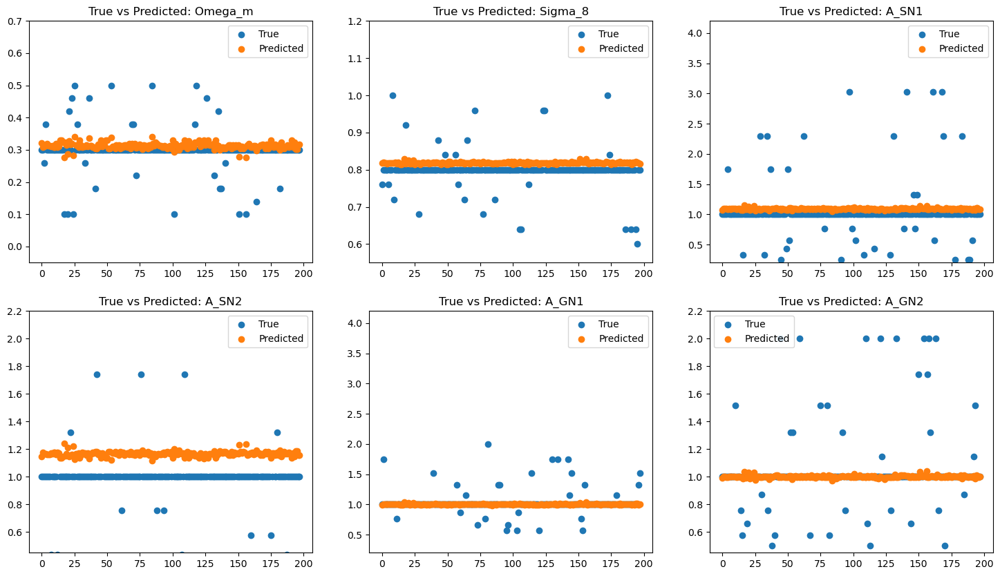

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0460 - mae: 0.1524 - mse: 0.1262 - val_loss: 0.0337 - val_mae: 0.1263 - val_mse: 0.1017 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0362 - mae: 0.1240 - mse: 0.1119 - val_loss: 0.0328 - val_mae: 0.1153 - val_mse: 0.1000 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0320 - mae: 0.1164 - mse: 0.0895 - val_loss: 0.0333 - val_mae: 0.1060 - val_mse: 0.1008 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0356 - mae: 0.1182 - mse: 0.1072 - val_loss: 0.0337 - val_mae: 0.1475 - val_mse: 0.1052 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0347 - mae: 0.1268 - mse: 0.1083 - val_loss: 0.0313 - val_mae: 0.1046 - val_mse: 0.0976 - learning_rate: 5.0000e-04
Epoch

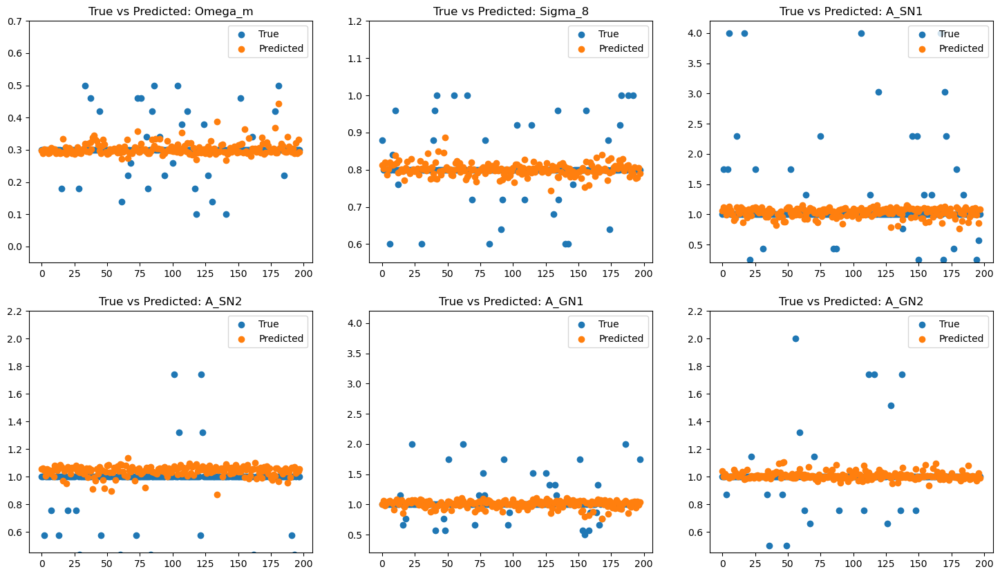

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0367 - mae: 0.1440 - mse: 0.0906 - val_loss: 0.0340 - val_mae: 0.1506 - val_mse: 0.0960 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0264 - mae: 0.1203 - mse: 0.0745 - val_loss: 0.0334 - val_mae: 0.1295 - val_mse: 0.0996 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0288 - mae: 0.1240 - mse: 0.0811 - val_loss: 0.0386 - val_mae: 0.1262 - val_mse: 0.1233 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0278 - mae: 0.1177 - mse: 0.0801 - val_loss: 0.0346 - val_mae: 0.1604 - val_mse: 0.0990 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0241 - mae: 0.1142 - mse: 0.0702 - val_loss: 0.0285 - val_mae: 0.1193 - val_mse: 0.0853 - learning_rate: 5.0000e-04
Ep

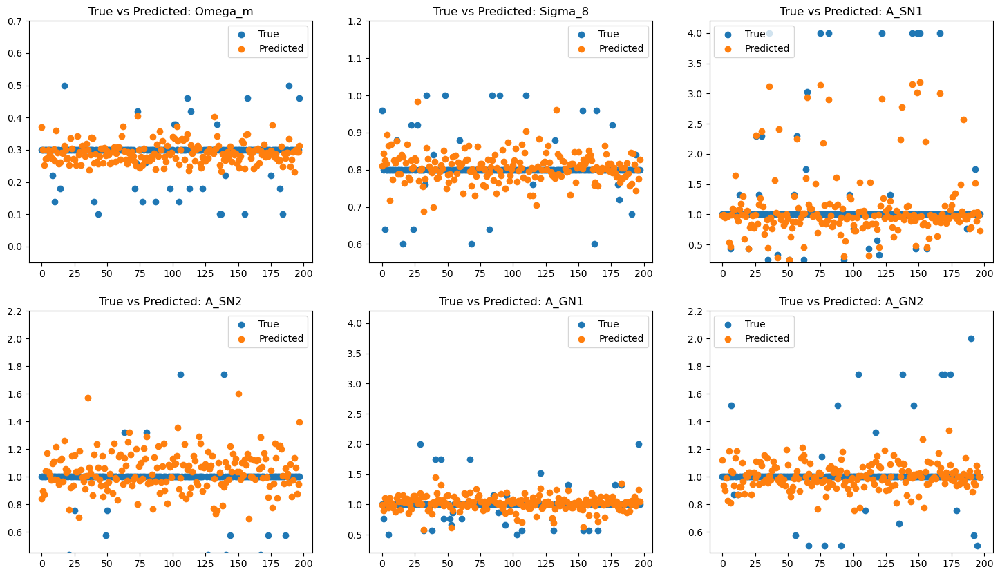

In [234]:
modelE_loss = test_models(create_modelE, (256,256,1))

### Model F

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0536 - mae: 0.1791 - mse: 0.1102 - val_loss: 0.0429 - val_mae: 0.1249 - val_mse: 0.1373 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0282 - mae: 0.1161 - mse: 0.0767 - val_loss: 0.0443 - val_mae: 0.1400 - val_mse: 0.1434 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0270 - mae: 0.1156 - mse: 0.0761 - val_loss: 0.0404 - val_mae: 0.1235 - val_mse: 0.1306 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0279 - mae: 0.1166 - mse: 0.0778 - val_loss: 0.0422 - val_mae: 0.1268 - val_mse: 0.1364 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0241 - mae: 0.1128 - mse: 0.0712 - val_loss: 0.0418 - val_mae: 0.1586 - val_mse: 0.1341 - learning_rate: 0.0010
Epoch 6/20


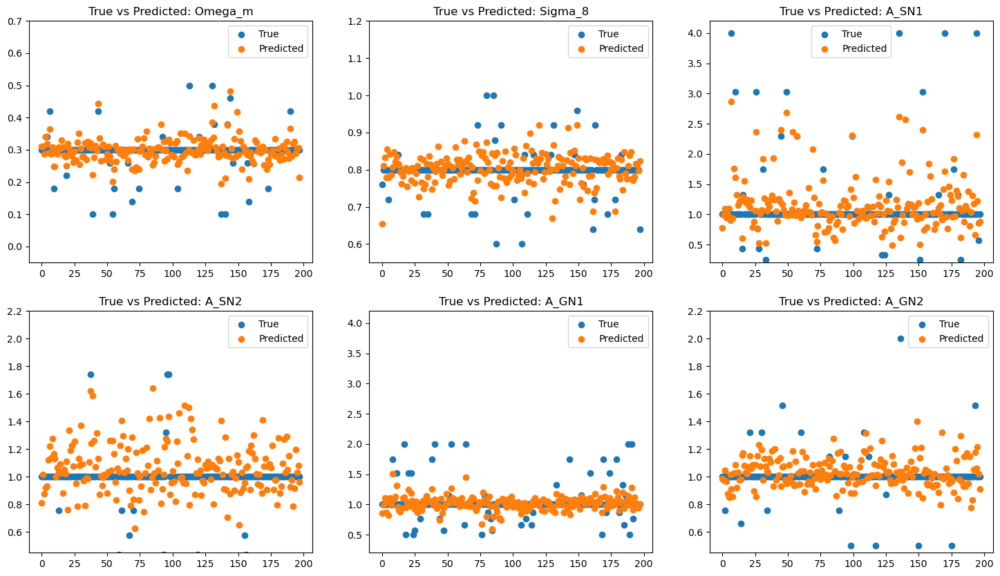

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0722 - mae: 0.2048 - mse: 0.1550 - val_loss: 0.0289 - val_mae: 0.1080 - val_mse: 0.0812 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0286 - mae: 0.1114 - mse: 0.0846 - val_loss: 0.0285 - val_mae: 0.1083 - val_mse: 0.0819 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0339 - mae: 0.1184 - mse: 0.1042 - val_loss: 0.0265 - val_mae: 0.1056 - val_mse: 0.0792 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0308 - mae: 0.1147 - mse: 0.0940 - val_loss: 0.0283 - val_mae: 0.1150 - val_mse: 0.0825 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0344 - mae: 0.1245 - mse: 0.1040 - val_loss: 0.0262 - val_mae: 0.1033 - val_mse: 0.0781 - learning_rate: 0.0010
Ep

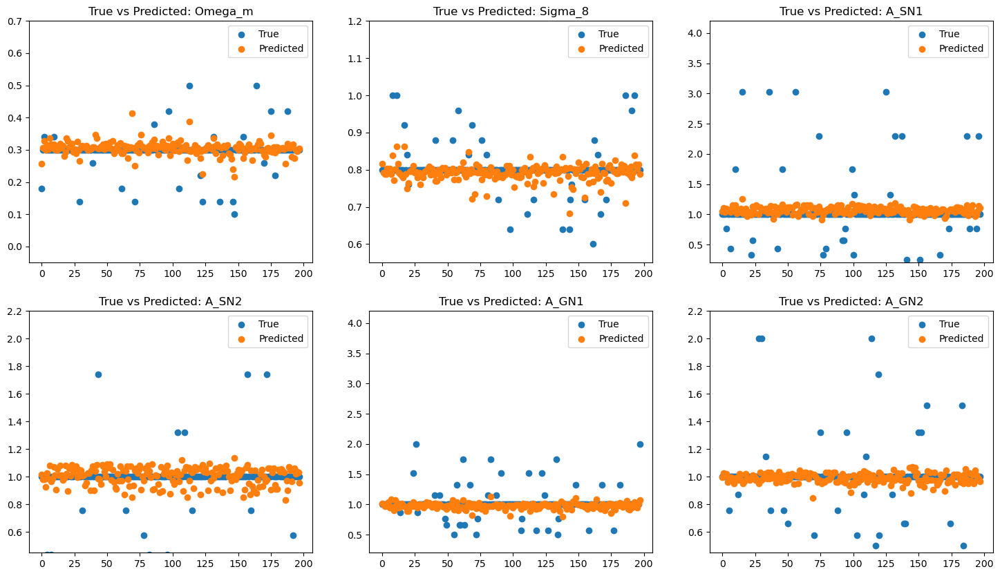

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0513 - mae: 0.1710 - mse: 0.1303 - val_loss: 0.0386 - val_mae: 0.1443 - val_mse: 0.1275 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0300 - mae: 0.1189 - mse: 0.0876 - val_loss: 0.0388 - val_mae: 0.1294 - val_mse: 0.1267 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0303 - mae: 0.1145 - mse: 0.0892 - val_loss: 0.0390 - val_mae: 0.1189 - val_mse: 0.1279 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0299 - mae: 0.1052 - mse: 0.0896 - val_loss: 0.0369 - val_mae: 0.1179 - val_mse: 0.1232 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0271 - mae: 0.0988 - mse: 0.0790 - val_loss: 0.0367 - val_mae: 0.1184 - val_mse: 0.1221 - learning_rate: 5.0000e-04

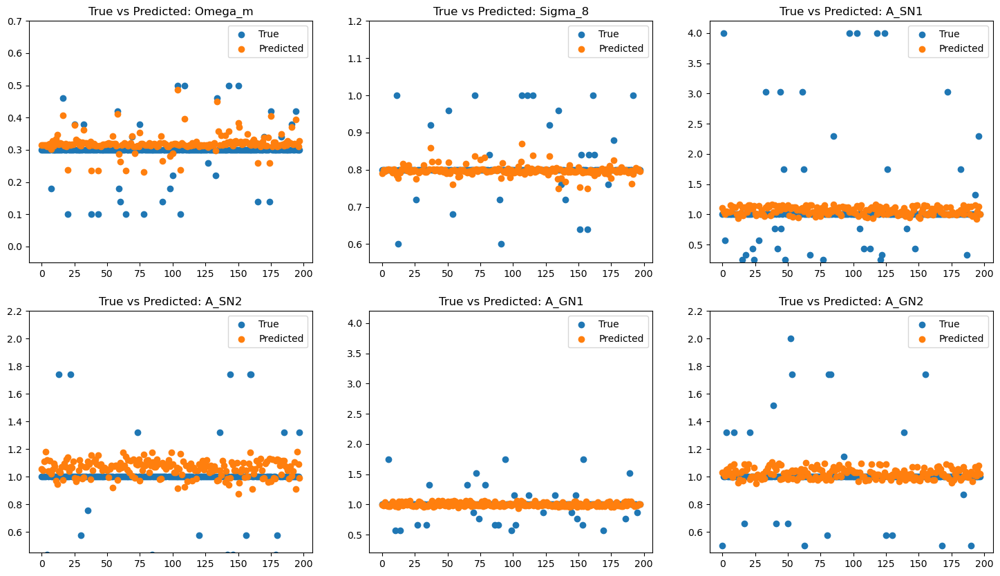

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0625 - mae: 0.1822 - mse: 0.1644 - val_loss: 0.0317 - val_mae: 0.1151 - val_mse: 0.0924 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0337 - mae: 0.1225 - mse: 0.1009 - val_loss: 0.0313 - val_mae: 0.1194 - val_mse: 0.0917 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0326 - mae: 0.1172 - mse: 0.0979 - val_loss: 0.0298 - val_mae: 0.1298 - val_mse: 0.0886 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0282 - mae: 0.1148 - mse: 0.0825 - val_loss: 0.0315 - val_mae: 0.1312 - val_mse: 0.0949 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0323 - mae: 0.1284 - mse: 0.0975 - val_loss: 0.0308 - val_mae: 0.1426 - val_mse: 0.0880 - learning_rate: 0.0010
Epoch 6/20
594/

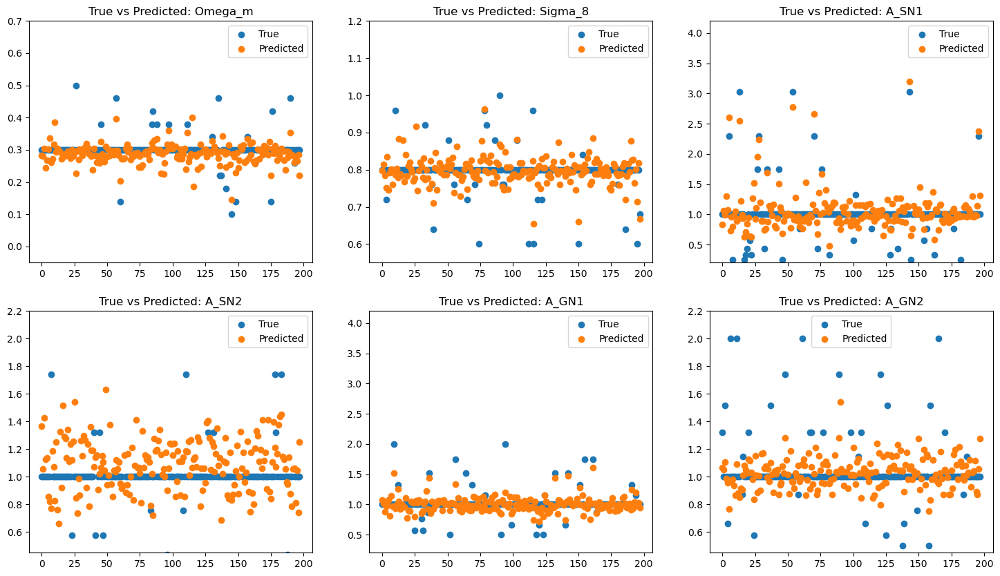

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0427 - mae: 0.1522 - mse: 0.1102 - val_loss: 0.0274 - val_mae: 0.1156 - val_mse: 0.0748 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0282 - mae: 0.1292 - mse: 0.0820 - val_loss: 0.0342 - val_mae: 0.1623 - val_mse: 0.0816 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0232 - mae: 0.1185 - mse: 0.0654 - val_loss: 0.0267 - val_mae: 0.1346 - val_mse: 0.0695 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0171 - mae: 0.1054 - mse: 0.0427 - val_loss: 0.0264 - val_mae: 0.1212 - val_mse: 0.0707 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0136 - mae: 0.0952 - mse: 0.0303 - val_loss: 0.0293 - val_mae: 0.1643 - val_mse: 0.0807 - learning_rate: 0.0010
Epoch 6

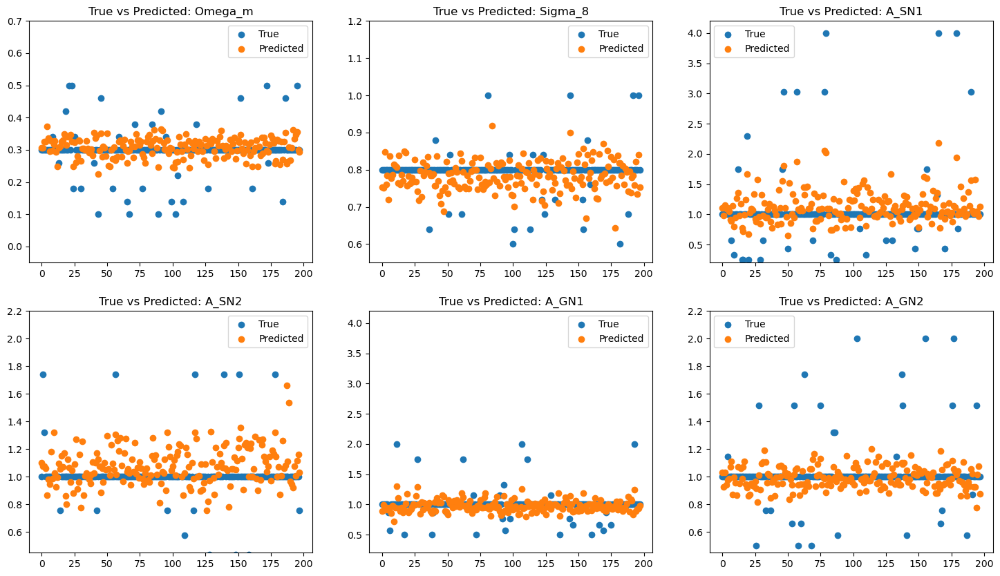

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0470 - mae: 0.1623 - mse: 0.1200 - val_loss: 0.0466 - val_mae: 0.1526 - val_mse: 0.1483 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0306 - mae: 0.1172 - mse: 0.0891 - val_loss: 0.0460 - val_mae: 0.1281 - val_mse: 0.1487 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0287 - mae: 0.1047 - mse: 0.0838 - val_loss: 0.0446 - val_mae: 0.1221 - val_mse: 0.1455 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0291 - mae: 0.1044 - mse: 0.0900 - val_loss: 0.0453 - val_mae: 0.1245 - val_mse: 0.1476 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0338 - mae: 0.1179 - mse: 0.1101 - val_loss: 0.0445 - val_mae: 0.1123 - val_mse: 0.1475 - learning_rate: 0.0010
Epoch 

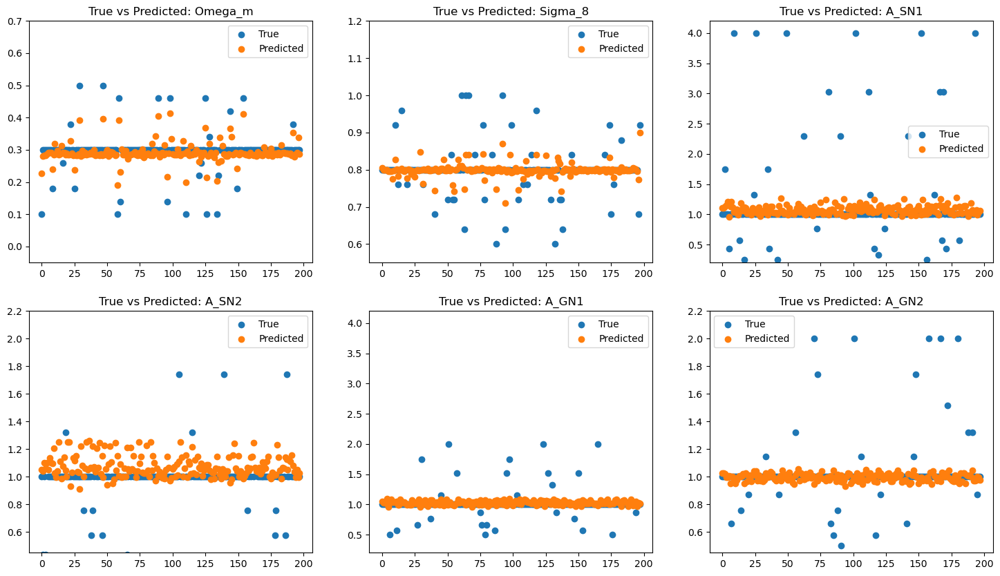

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0396 - mae: 0.1457 - mse: 0.1032 - val_loss: 0.0369 - val_mae: 0.1110 - val_mse: 0.1122 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0367 - mae: 0.1269 - mse: 0.1128 - val_loss: 0.0368 - val_mae: 0.1330 - val_mse: 0.1119 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0299 - mae: 0.1117 - mse: 0.0913 - val_loss: 0.0364 - val_mae: 0.1318 - val_mse: 0.1112 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0257 - mae: 0.1050 - mse: 0.0786 - val_loss: 0.0382 - val_mae: 0.1310 - val_mse: 0.1121 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0265 - mae: 0.1148 - mse: 0.0815 - val_loss: 0.0423 - val_mae: 0.1273 - val_mse: 0.1150 - learning_rate: 0.0010
Epo

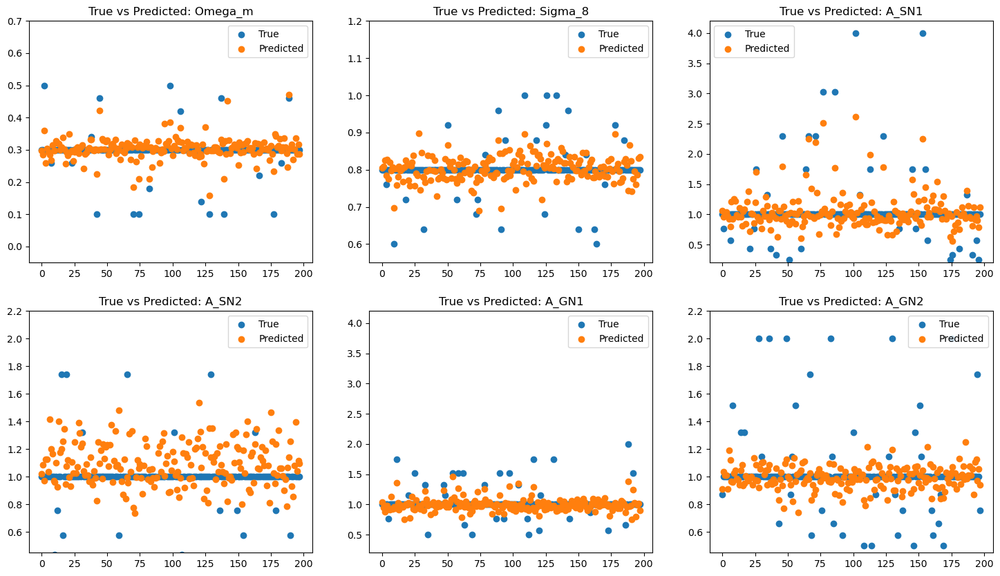

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0582 - mae: 0.1694 - mse: 0.1277 - val_loss: 0.0332 - val_mae: 0.1150 - val_mse: 0.0957 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0302 - mae: 0.1231 - mse: 0.0881 - val_loss: 0.0291 - val_mae: 0.1066 - val_mse: 0.0885 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0296 - mae: 0.1288 - mse: 0.0905 - val_loss: 0.0310 - val_mae: 0.1562 - val_mse: 0.0928 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0264 - mae: 0.1311 - mse: 0.0773 - val_loss: 0.0294 - val_mae: 0.1440 - val_mse: 0.0895 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0227 - mae: 0.1149 - mse: 0.0674 - val_loss: 0.0285 - val_mae: 0.1423 - val_mse: 0.0869 - learning_rate: 5.0000e-04
Epoch 6

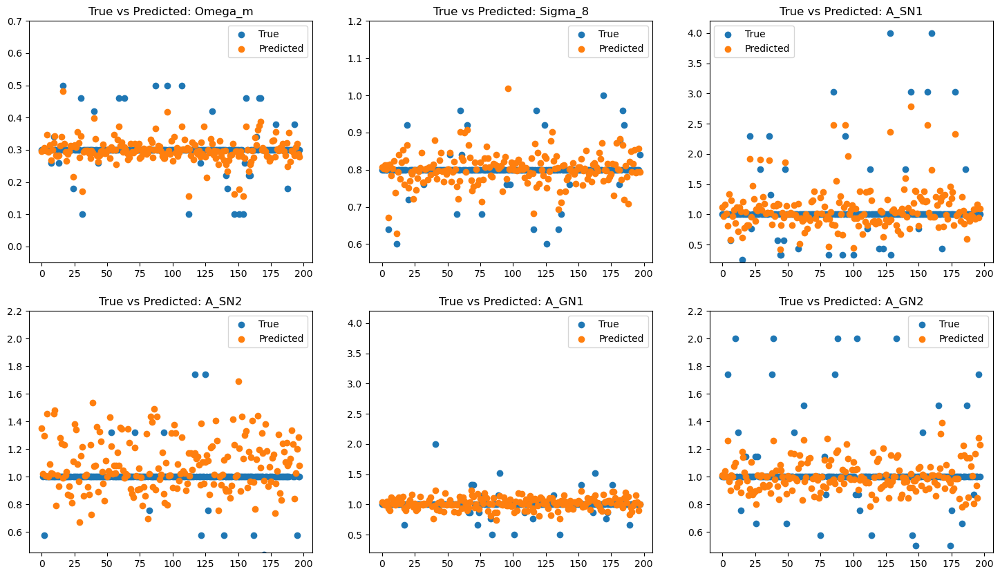

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0389 - mae: 0.1469 - mse: 0.1026 - val_loss: 0.0365 - val_mae: 0.1132 - val_mse: 0.1084 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0328 - mae: 0.1157 - mse: 0.0978 - val_loss: 0.0373 - val_mae: 0.1153 - val_mse: 0.1116 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0379 - mae: 0.1268 - mse: 0.1241 - val_loss: 0.0380 - val_mae: 0.1169 - val_mse: 0.1129 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0315 - mae: 0.1083 - mse: 0.0992 - val_loss: 0.0366 - val_mae: 0.1112 - val_mse: 0.1109 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0251 - mae: 0.0968 - mse: 0.0786 - val_loss: 0.0363 - val_mae: 0.1180 - val_mse: 0.1109 - learning_rate: 5.0000e-0

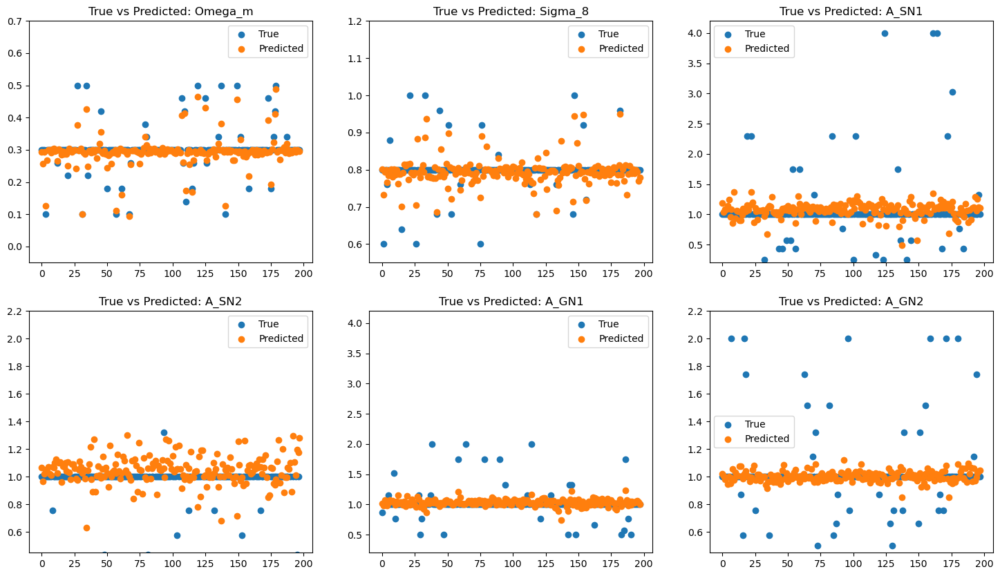

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0428 - mae: 0.1517 - mse: 0.1071 - val_loss: 0.0403 - val_mae: 0.1144 - val_mse: 0.1246 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0269 - mae: 0.1062 - mse: 0.0763 - val_loss: 0.0379 - val_mae: 0.1184 - val_mse: 0.1185 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0303 - mae: 0.1242 - mse: 0.0962 - val_loss: 0.0374 - val_mae: 0.1163 - val_mse: 0.1168 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0232 - mae: 0.1103 - mse: 0.0641 - val_loss: 0.0392 - val_mae: 0.1338 - val_mse: 0.1164 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0186 - mae: 0.1036 - mse: 0.0518 - val_loss: 0.0379 - val_mae: 0.1469 - val_mse: 0.1125 - learning_rate: 0.0010
Epoch 6/20
594

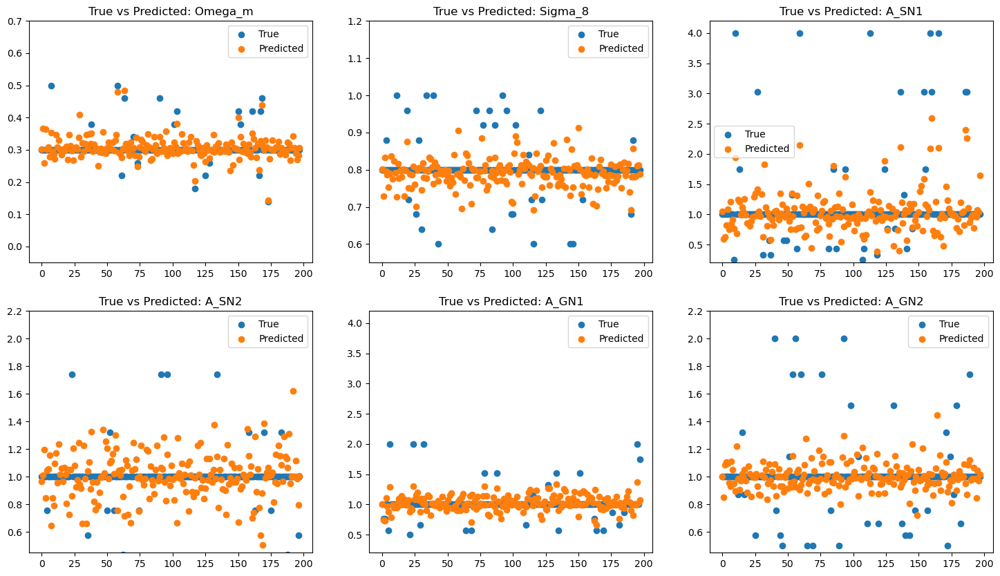

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0522 - mae: 0.1691 - mse: 0.1066 - val_loss: 0.0400 - val_mae: 0.1331 - val_mse: 0.1246 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0278 - mae: 0.1196 - mse: 0.0793 - val_loss: 0.0353 - val_mae: 0.1252 - val_mse: 0.1113 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0253 - mae: 0.1132 - mse: 0.0713 - val_loss: 0.0335 - val_mae: 0.1306 - val_mse: 0.1029 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0220 - mae: 0.1142 - mse: 0.0614 - val_loss: 0.0332 - val_mae: 0.1286 - val_mse: 0.1018 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.0196 - mae: 0.1080 - mse: 0.0514 - val_loss: 0.0343 - val_mae: 0.1363 - val_mse: 0.1021 - learning_rate: 0.0010
Epoch 6/20


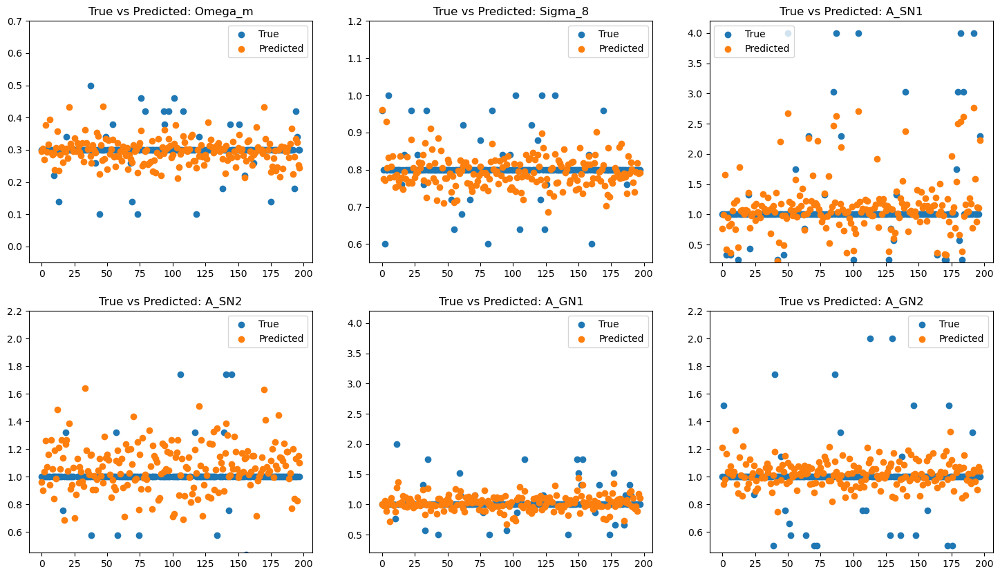

In [235]:
modelF_loss = test_models(create_modelF, (256,256,1))

### Model G

Map training on: Magnetic Fields
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 0.0844 - mae: 0.2196 - mse: 0.1814 - val_loss: 0.0262 - val_mae: 0.1059 - val_mse: 0.0769 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0379 - mae: 0.1335 - mse: 0.1146 - val_loss: 0.0267 - val_mae: 0.1206 - val_mse: 0.0797 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0280 - mae: 0.1125 - mse: 0.0823 - val_loss: 0.0254 - val_mae: 0.1064 - val_mse: 0.0749 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0319 - mae: 0.1247 - mse: 0.0991 - val_loss: 0.0270 - val_mae: 0.1060 - val_mse: 0.0766 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0327 - mae: 0.1233 - mse: 0.0985 - val_loss: 0.0258 - val_mae: 0.1058 - val_mse: 0.0759 - learning_rate: 0.0010
Epoch 6/20


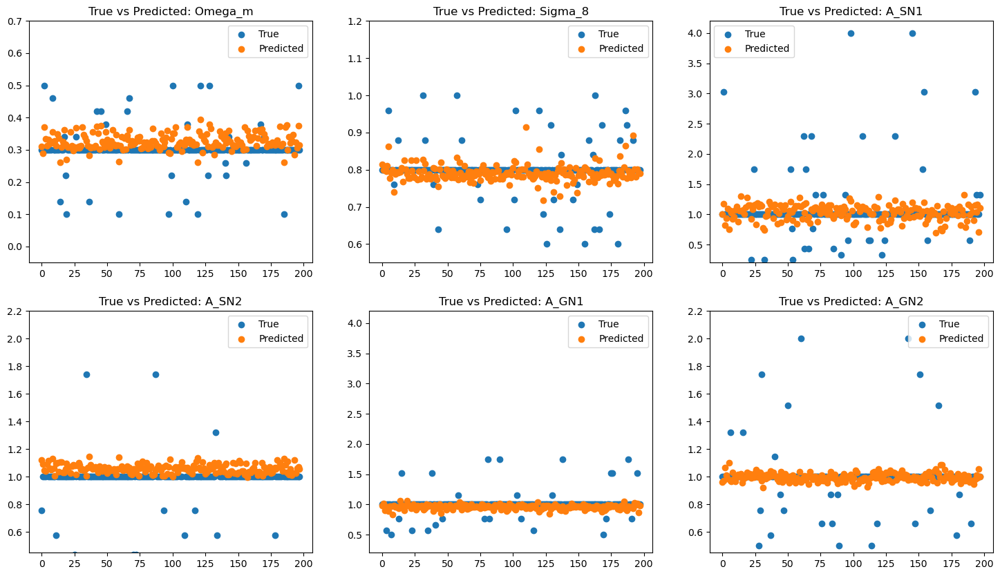

Map training on: Neutral Hydrogen Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0898 - mae: 0.2150 - mse: 0.1681 - val_loss: 0.0338 - val_mae: 0.1118 - val_mse: 0.1043 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0350 - mae: 0.1228 - mse: 0.0911 - val_loss: 0.0339 - val_mae: 0.1220 - val_mse: 0.1047 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0348 - mae: 0.1211 - mse: 0.1067 - val_loss: 0.0329 - val_mae: 0.1109 - val_mse: 0.1040 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0320 - mae: 0.1219 - mse: 0.0990 - val_loss: 0.0344 - val_mae: 0.1104 - val_mse: 0.1059 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0331 - mae: 0.1193 - mse: 0.0984 - val_loss: 0.0326 - val_mae: 0.1075 - val_mse: 0.1032 - learning_rate: 0.0010
Ep

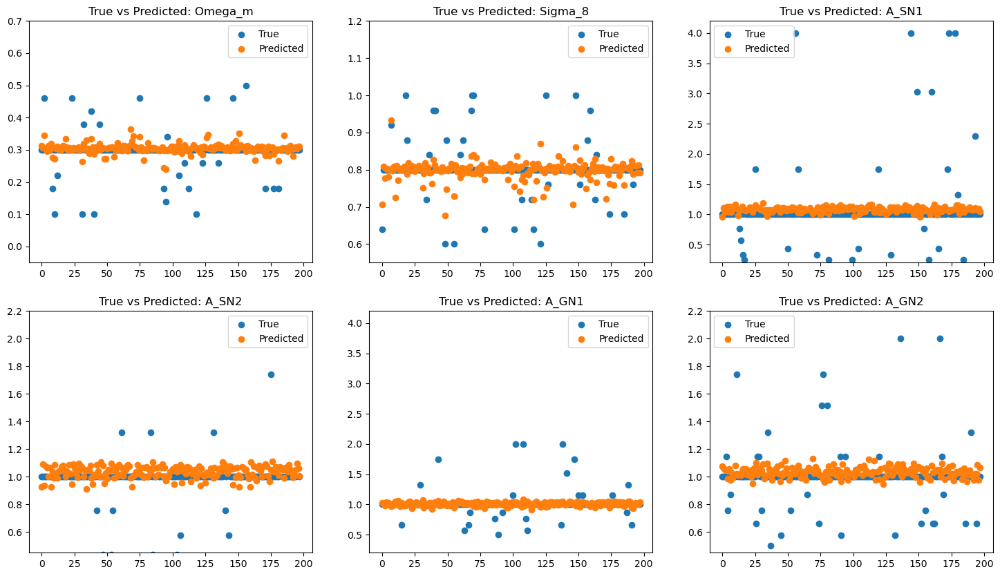

Map training on: Dark Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.1483 - mae: 0.2280 - mse: 0.1825 - val_loss: 0.0361 - val_mae: 0.1152 - val_mse: 0.1069 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0360 - mae: 0.1226 - mse: 0.0970 - val_loss: 0.0351 - val_mae: 0.1109 - val_mse: 0.1065 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0338 - mae: 0.1217 - mse: 0.1008 - val_loss: 0.0358 - val_mae: 0.1104 - val_mse: 0.1073 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0363 - mae: 0.1207 - mse: 0.1155 - val_loss: 0.0354 - val_mae: 0.1116 - val_mse: 0.1075 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0282 - mae: 0.0986 - mse: 0.0822 - val_loss: 0.0345 - val_mae: 0.1173 - val_mse: 0.1063 - learning_rate: 5.0000e-04
Epo

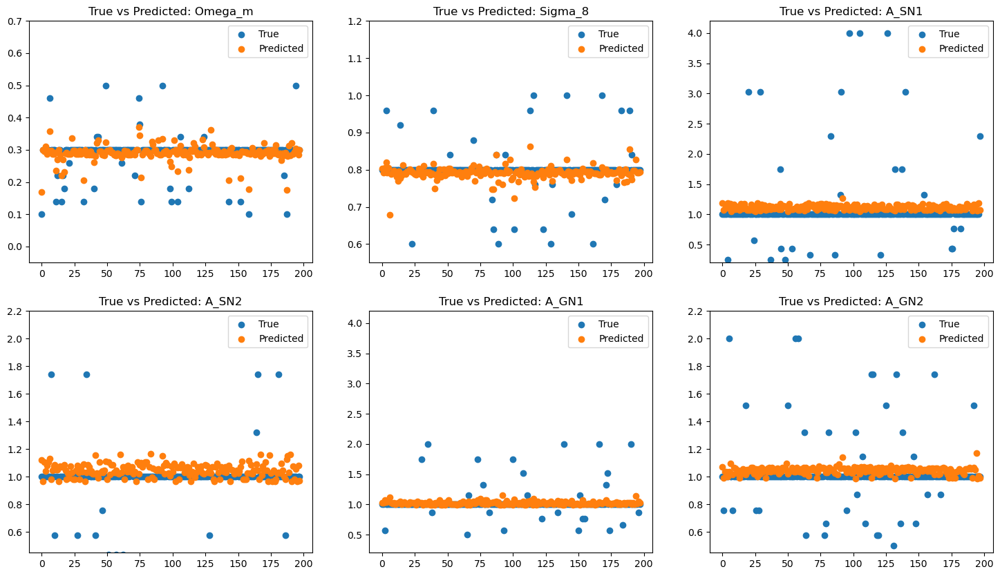

Map training on: Gas Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 0.1788 - mae: 0.2765 - mse: 0.2684 - val_loss: 0.0343 - val_mae: 0.1131 - val_mse: 0.0955 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0364 - mae: 0.1247 - mse: 0.1002 - val_loss: 0.0327 - val_mae: 0.1062 - val_mse: 0.0947 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0374 - mae: 0.1195 - mse: 0.1170 - val_loss: 0.0320 - val_mae: 0.1043 - val_mse: 0.0928 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0315 - mae: 0.1085 - mse: 0.0921 - val_loss: 0.0315 - val_mae: 0.1205 - val_mse: 0.0915 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0330 - mae: 0.1186 - mse: 0.1019 - val_loss: 0.0309 - val_mae: 0.1017 - val_mse: 0.0907 - learning_rate: 0.0010
Epoch 6/20
594/

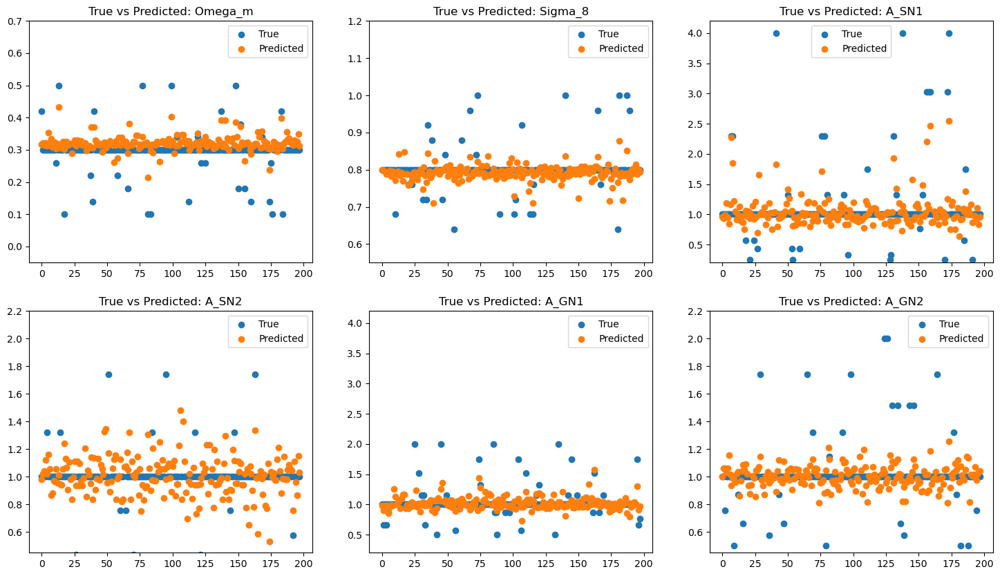

Map training on: Magnesium over Iron
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 0.0662 - mae: 0.1842 - mse: 0.1282 - val_loss: 0.0279 - val_mae: 0.1141 - val_mse: 0.0775 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0267 - mae: 0.1219 - mse: 0.0740 - val_loss: 0.0259 - val_mae: 0.1217 - val_mse: 0.0740 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0238 - mae: 0.1214 - mse: 0.0717 - val_loss: 0.0257 - val_mae: 0.1262 - val_mse: 0.0749 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0139 - mae: 0.0953 - mse: 0.0367 - val_loss: 0.0259 - val_mae: 0.1153 - val_mse: 0.0772 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0104 - mae: 0.0872 - mse: 0.0281 - val_loss: 0.0279 - val_mae: 0.1421 - val_mse: 0.0829 - learning_rate: 0.0010
Epoch 6

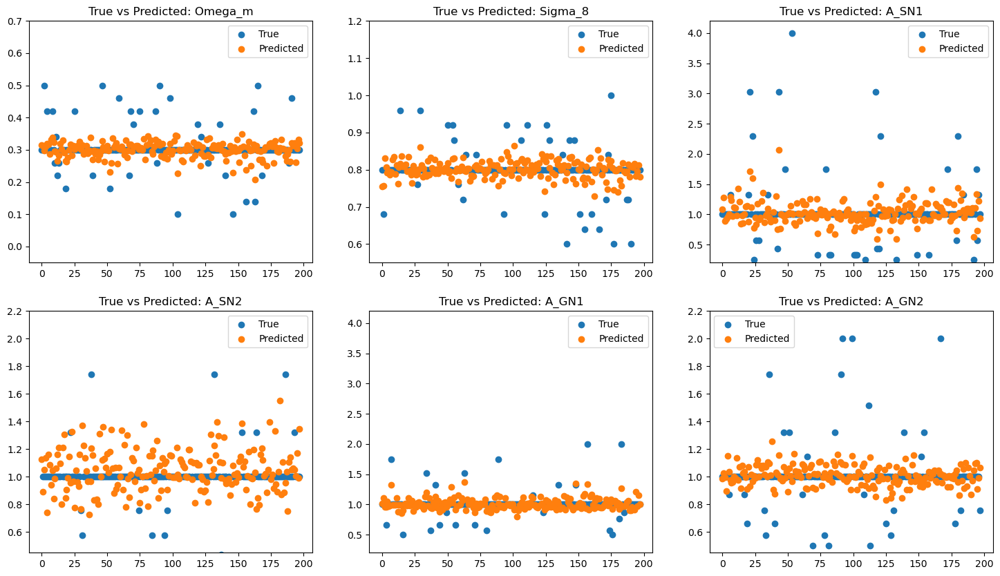

Map training on: Total Matter Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 0.0624 - mae: 0.1800 - mse: 0.1284 - val_loss: 0.0282 - val_mae: 0.0932 - val_mse: 0.0829 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0318 - mae: 0.1108 - mse: 0.0924 - val_loss: 0.0276 - val_mae: 0.1042 - val_mse: 0.0828 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0351 - mae: 0.1200 - mse: 0.1058 - val_loss: 0.0287 - val_mae: 0.1218 - val_mse: 0.0845 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0368 - mae: 0.1246 - mse: 0.1137 - val_loss: 0.0279 - val_mae: 0.0978 - val_mse: 0.0829 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0342 - mae: 0.1121 - mse: 0.1059 - val_loss: 0.0274 - val_mae: 0.0934 - val_mse: 0.0822 - learning_rate: 5.0000e-04
Ep

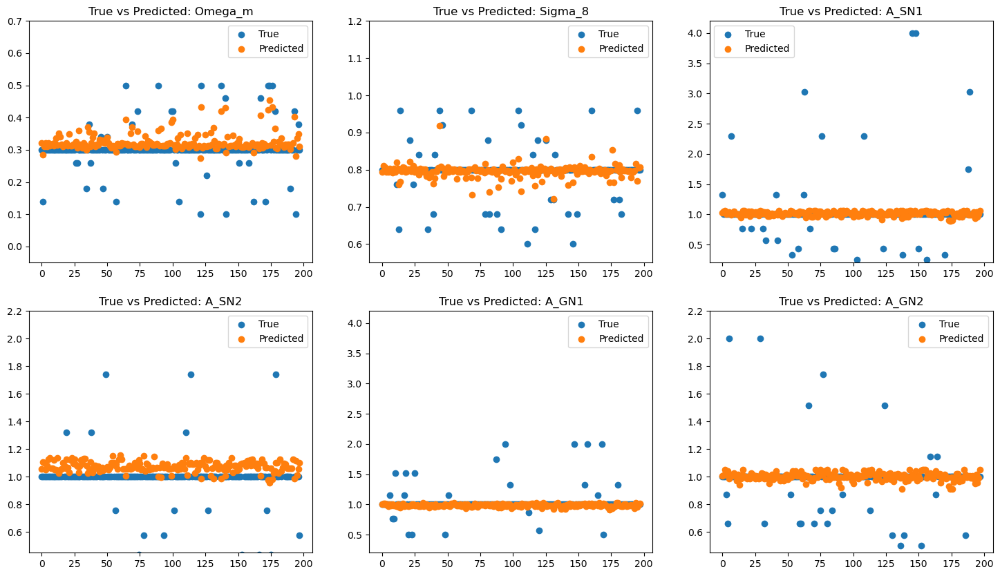

Map training on: Electron Number Density
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - loss: 0.0642 - mae: 0.1806 - mse: 0.1378 - val_loss: 0.0309 - val_mae: 0.1084 - val_mse: 0.0917 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0330 - mae: 0.1171 - mse: 0.0969 - val_loss: 0.0312 - val_mae: 0.1213 - val_mse: 0.0925 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0341 - mae: 0.1183 - mse: 0.1071 - val_loss: 0.0302 - val_mae: 0.0949 - val_mse: 0.0908 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0299 - mae: 0.1097 - mse: 0.0865 - val_loss: 0.0292 - val_mae: 0.1059 - val_mse: 0.0881 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0302 - mae: 0.1135 - mse: 0.0895 - val_loss: 0.0301 - val_mae: 0.1110 - val_mse: 0.0894 - learning_rate: 0.0010
Epo

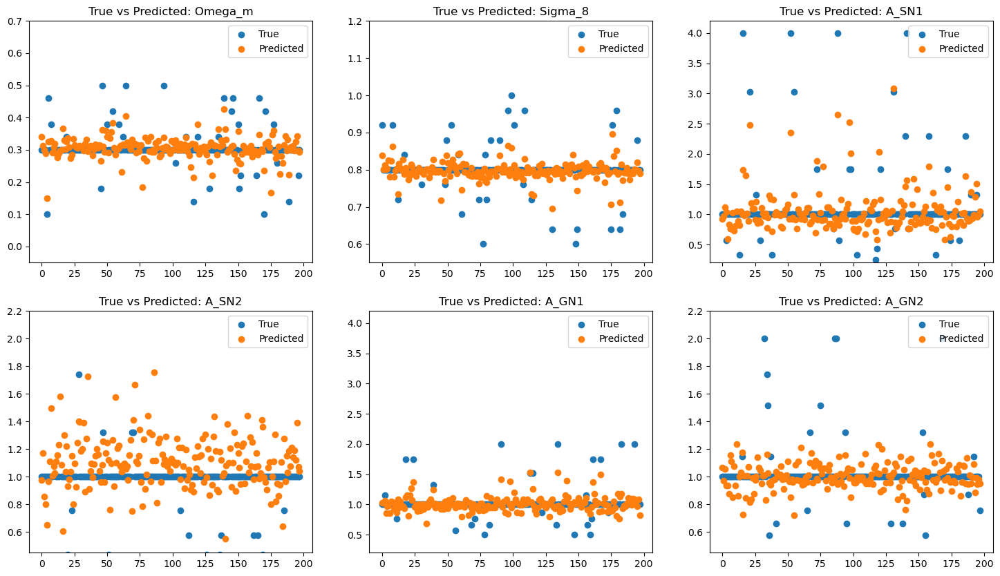

Map training on: Gas Temperature
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0881 - mae: 0.1955 - mse: 0.1424 - val_loss: 0.0368 - val_mae: 0.1634 - val_mse: 0.0958 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0332 - mae: 0.1282 - mse: 0.1002 - val_loss: 0.0304 - val_mae: 0.1049 - val_mse: 0.0867 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0313 - mae: 0.1223 - mse: 0.0926 - val_loss: 0.0306 - val_mae: 0.1214 - val_mse: 0.0877 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0287 - mae: 0.1234 - mse: 0.0836 - val_loss: 0.0286 - val_mae: 0.1181 - val_mse: 0.0826 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0286 - mae: 0.1286 - mse: 0.0738 - val_loss: 0.0307 - val_mae: 0.1369 - val_mse: 0.0854 - learning_rate: 0.0010
Epoch 6/20


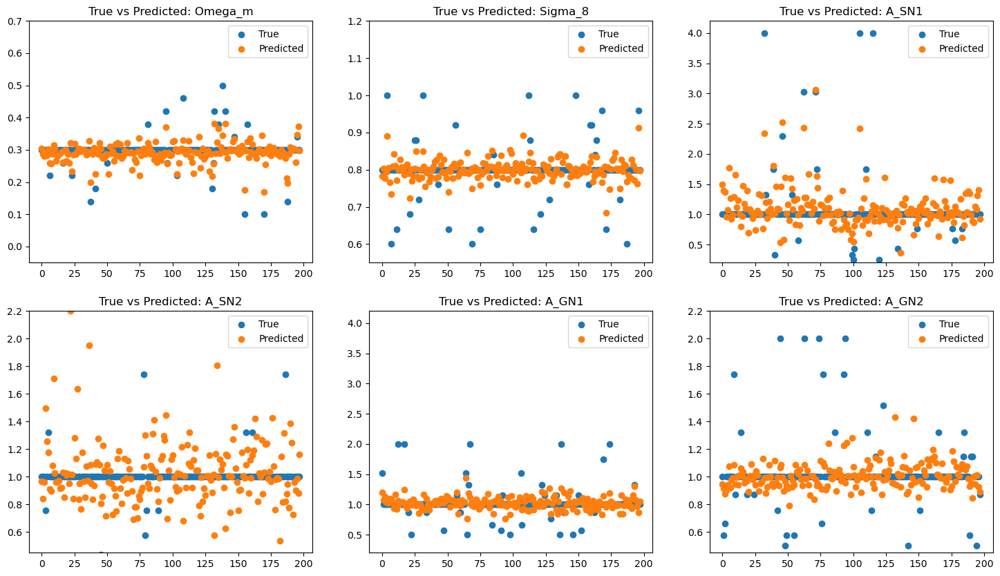

Map training on: Dark Matter Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.1033 - mae: 0.2246 - mse: 0.2111 - val_loss: 0.0300 - val_mae: 0.0998 - val_mse: 0.0859 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0370 - mae: 0.1165 - mse: 0.1152 - val_loss: 0.0297 - val_mae: 0.0986 - val_mse: 0.0858 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0283 - mae: 0.1002 - mse: 0.0838 - val_loss: 0.0292 - val_mae: 0.1185 - val_mse: 0.0852 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0292 - mae: 0.1047 - mse: 0.0888 - val_loss: 0.0293 - val_mae: 0.1099 - val_mse: 0.0861 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0304 - mae: 0.1037 - mse: 0.0922 - val_loss: 0.0285 - val_mae: 0.1081 - val_mse: 0.0838 - learning_rate: 0.0010
Epoch 

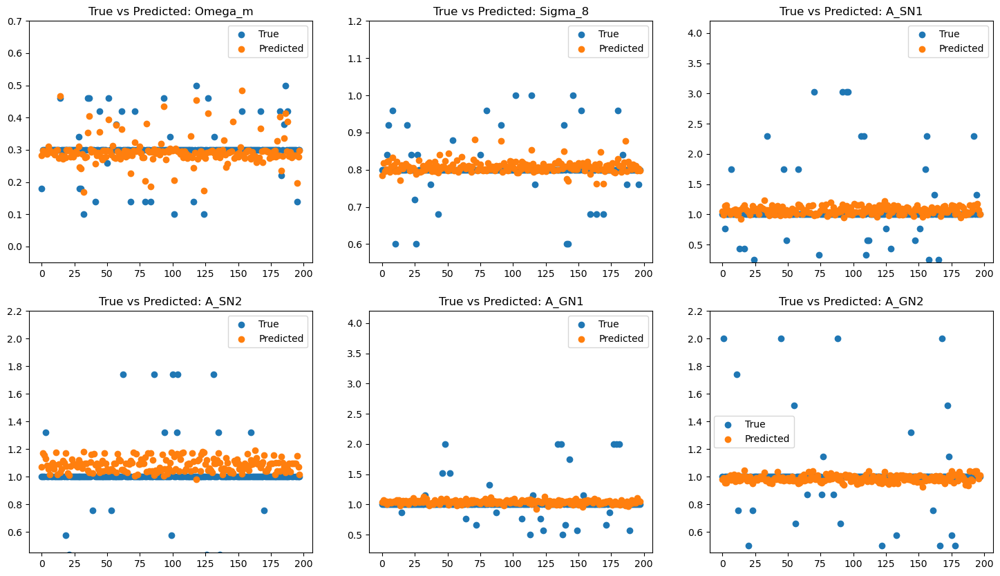

Map training on: Gas Velocity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.1828 - mae: 0.2520 - mse: 0.2497 - val_loss: 0.0335 - val_mae: 0.1083 - val_mse: 0.1065 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0337 - mae: 0.1234 - mse: 0.1006 - val_loss: 0.0347 - val_mae: 0.1262 - val_mse: 0.1072 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0299 - mae: 0.1155 - mse: 0.0935 - val_loss: 0.0334 - val_mae: 0.1284 - val_mse: 0.1076 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0234 - mae: 0.1097 - mse: 0.0685 - val_loss: 0.0322 - val_mae: 0.1208 - val_mse: 0.1025 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0220 - mae: 0.1112 - mse: 0.0612 - val_loss: 0.0328 - val_mae: 0.1397 - val_mse: 0.1029 - learning_rate: 0.0010
Epoch 6/20
594

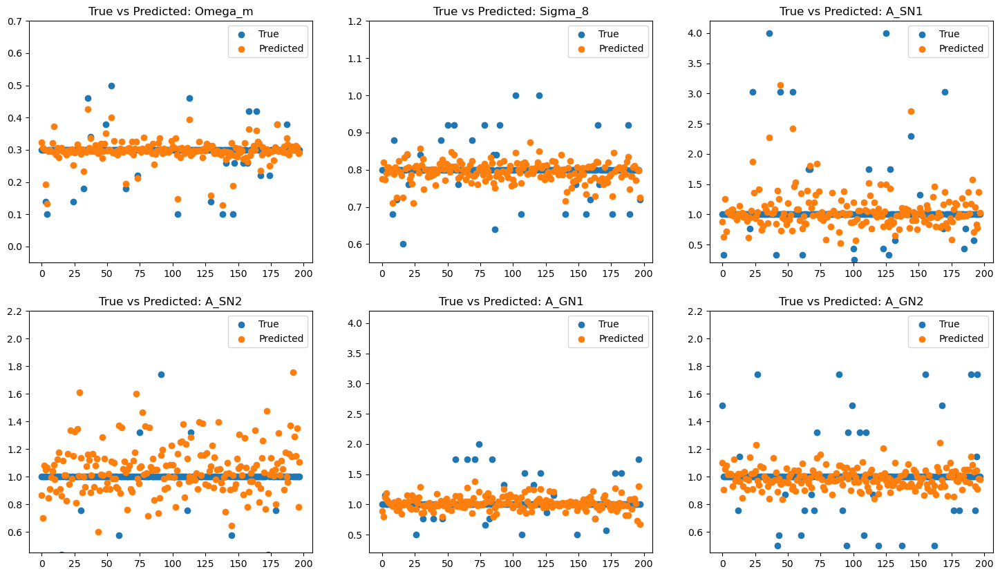

Map training on: Gas Metallicity
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 0.0642 - mae: 0.1809 - mse: 0.1383 - val_loss: 0.0353 - val_mae: 0.1406 - val_mse: 0.0968 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0413 - mae: 0.1521 - mse: 0.1217 - val_loss: 0.0316 - val_mae: 0.1254 - val_mse: 0.0920 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0281 - mae: 0.1283 - mse: 0.0790 - val_loss: 0.0287 - val_mae: 0.1220 - val_mse: 0.0841 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0237 - mae: 0.1257 - mse: 0.0698 - val_loss: 0.0289 - val_mae: 0.1220 - val_mse: 0.0833 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.0216 - mae: 0.1161 - mse: 0.0590 - val_loss: 0.0328 - val_mae: 0.1592 - val_mse: 0.0969 - learning_rate: 0.0010
Epoch 6/20


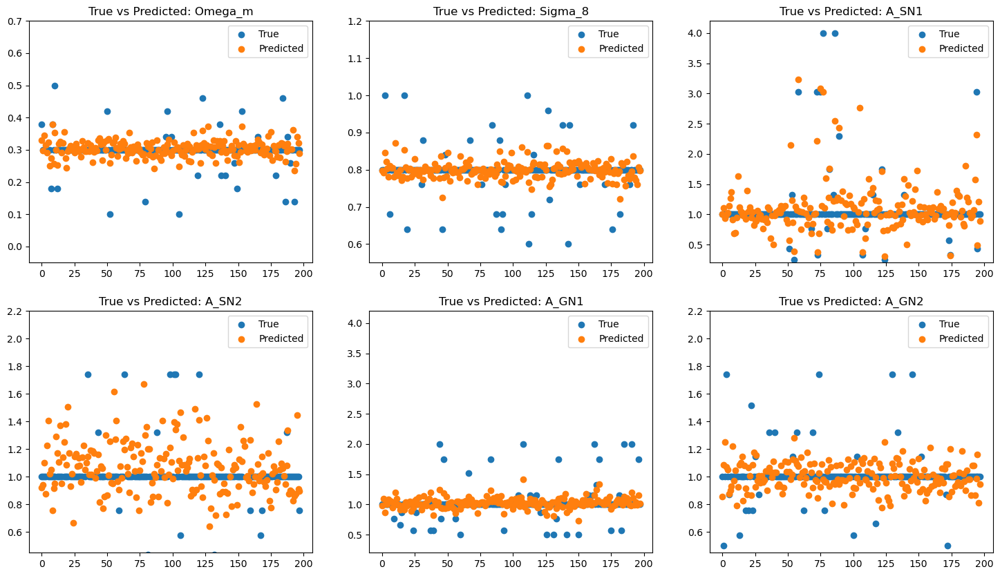

In [236]:
modelG_loss = test_models(create_modelG, (256,256,1))

### Model H

Map training on: Magnetic Fields
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0652 - val_loss: 0.0040 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0030 - val_loss: 0.0031 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0022 - val_loss: 0.0031 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0029 - val_loss: 0.0032 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0022 - val_loss: 0.0031 - learning_rate: 5.0000e-04
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0024 - val_loss: 0.0031 - learning_rate: 5.0000e-04
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0024 - val_loss: 0.0031 - learning_rate: 2.5000e-04
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step


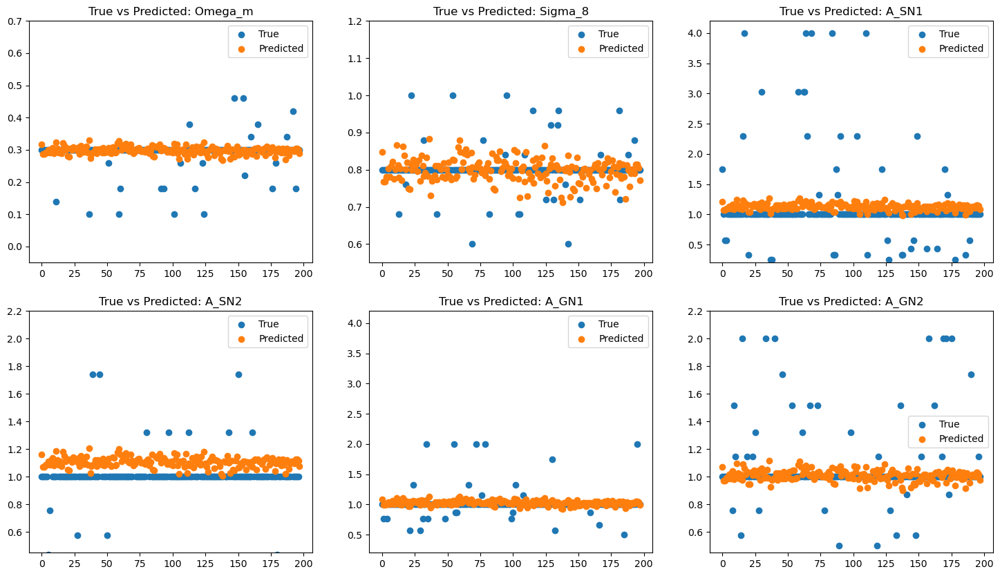

Map training on: Neutral Hydrogen Density
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0544 - val_loss: 0.0145 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0101 - val_loss: 0.0047 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0042 - val_loss: 0.0030 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0023 - val_loss: 0.0028 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0027 - val_loss: 0.0027 - learning_rate: 0.0010
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0025 - val_loss: 0.0027 - learning_rate: 0.0010
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0026 - val_loss: 0.0027 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0027 - val_loss: 0.0

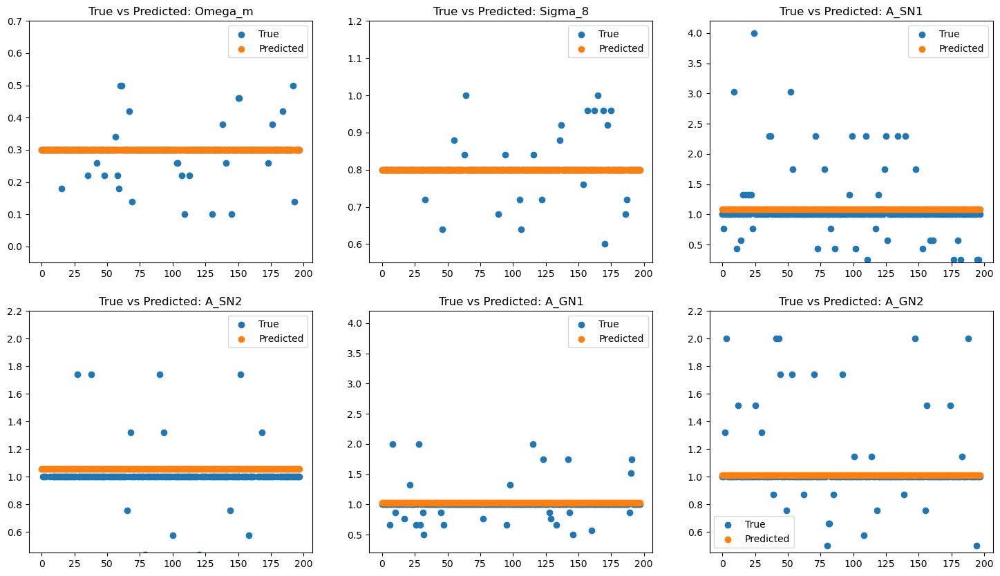

Map training on: Dark Matter Density
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 25ms/step - loss: 0.0765 - val_loss: 0.0065 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0045 - val_loss: 0.0026 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0024 - val_loss: 0.0027 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0028 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0028 - val_loss: 0.0026 - learning_rate: 5.0000e-04
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0024 - val_loss: 0.0025 - learning_rate: 5.0000e-04
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0023 - val_loss: 0.0026 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0025 - val_loss: 

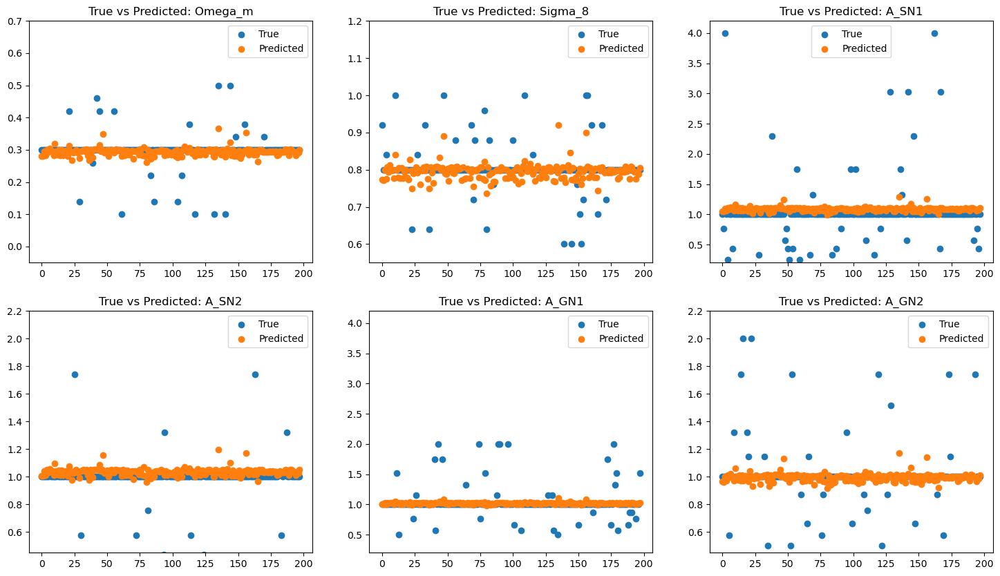

Map training on: Gas Density
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0389 - val_loss: 0.0020 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0026 - val_loss: 0.0022 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0025 - val_loss: 0.0019 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0027 - val_loss: 0.0020 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0022 - val_loss: 0.0021 - learning_rate: 5.0000e-04
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0026 - val_loss: 0.0019 - learning_rate: 2.5000e-04
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0026 - val_loss: 0.0019 - learning_rate: 2.5000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0023 - val_loss: 0.00

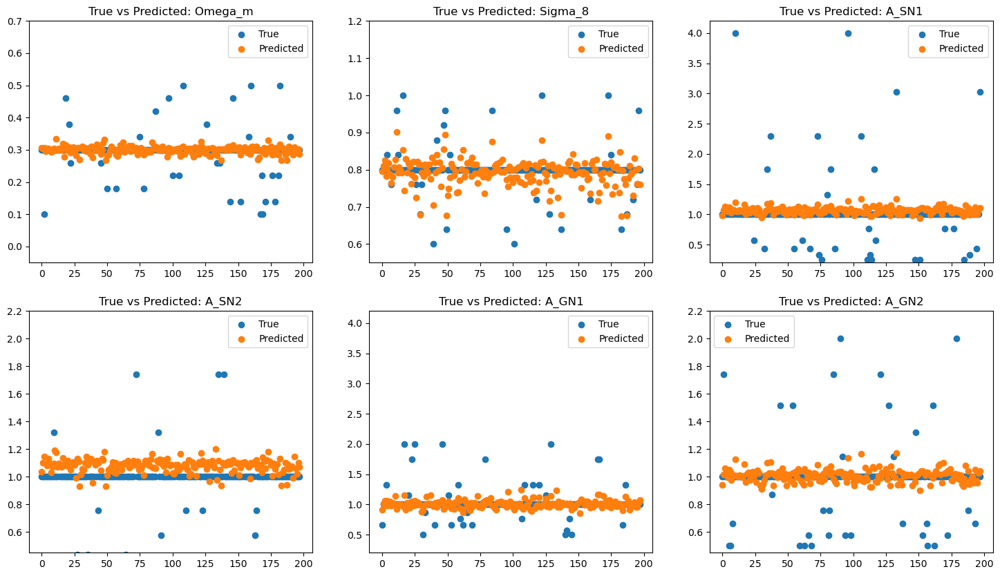

Map training on: Magnesium over Iron
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 17s 27ms/step - loss: 0.0991 - val_loss: 0.0179 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0130 - val_loss: 0.0056 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0042 - val_loss: 0.0031 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0029 - val_loss: 0.0028 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0026 - val_loss: 0.0028 - learning_rate: 0.0010
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0028 - val_loss: 0.0028 - learning_rate: 0.0010
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0024 - val_loss: 0.0028 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0028 - val_loss: 0.0028 -

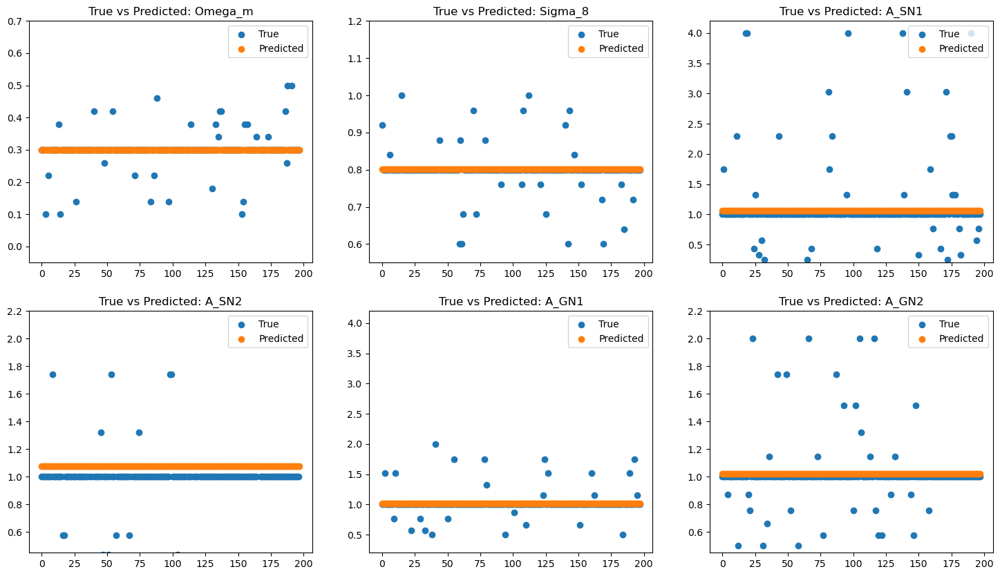

Map training on: Total Matter Density
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.2072 - val_loss: 0.0190 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0138 - val_loss: 0.0057 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0047 - val_loss: 0.0031 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0031 - val_loss: 0.0028 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0022 - val_loss: 0.0027 - learning_rate: 0.0010
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0021 - val_loss: 0.0027 - learning_rate: 0.0010
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0023 - val_loss: 0.0027 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0024 - val_loss: 0.0027 

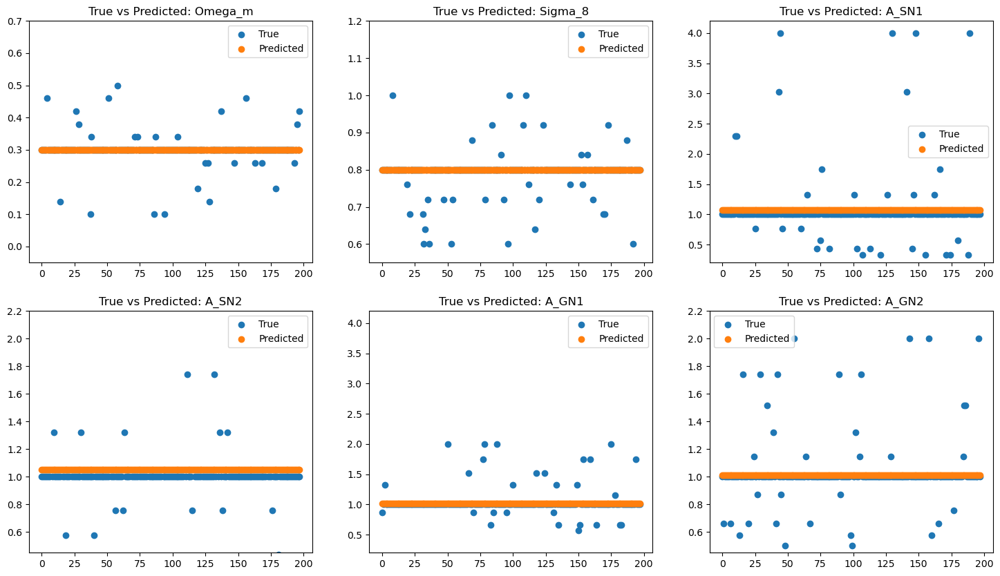

Map training on: Electron Number Density
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 17s 27ms/step - loss: 0.2994 - val_loss: 0.0091 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0079 - val_loss: 0.0037 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0030 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0032 - val_loss: 0.0027 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0027 - val_loss: 0.0026 - learning_rate: 0.0010
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0027 - val_loss: 0.0024 - learning_rate: 5.0000e-04
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0029 - val_loss: 0.0025 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0029 - val_loss: 

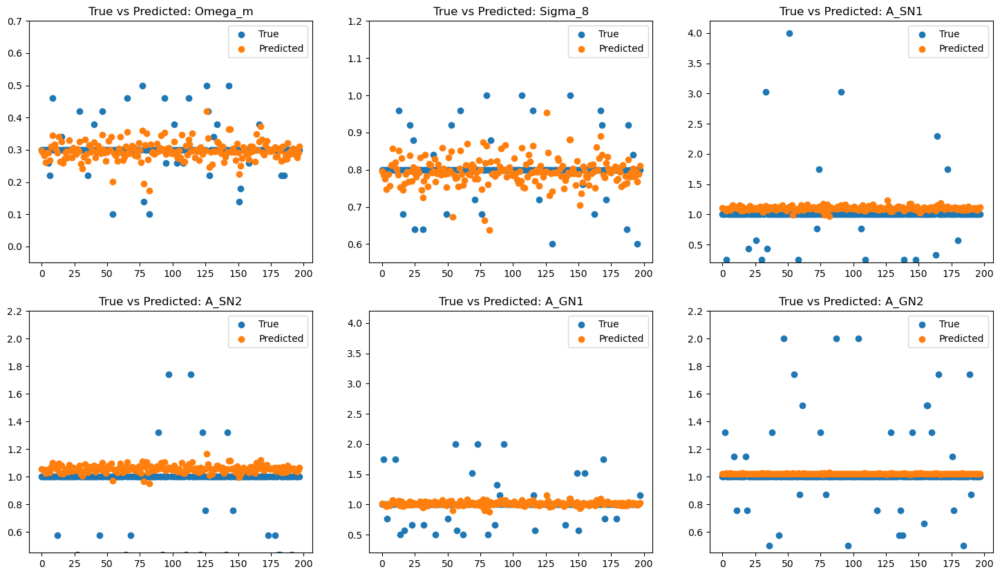

Map training on: Gas Temperature
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0459 - val_loss: 0.0030 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0030 - val_loss: 0.0023 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0026 - val_loss: 0.0023 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0028 - val_loss: 0.0020 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0026 - val_loss: 0.0020 - learning_rate: 0.0010
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0027 - val_loss: 0.0020 - learning_rate: 0.0010
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0026 - val_loss: 0.0020 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0024 - val_loss: 0.0020 - lea

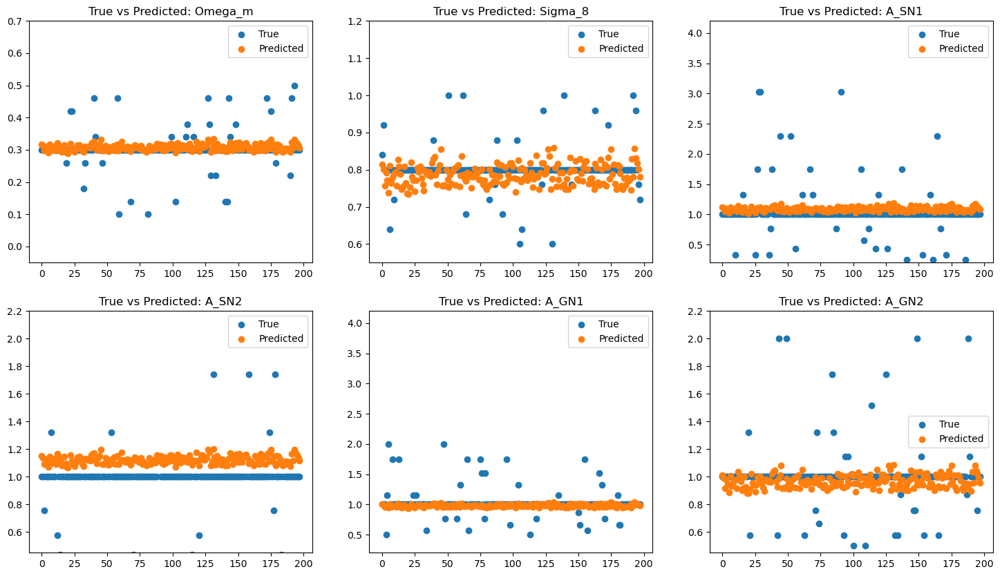

Map training on: Dark Matter Velocity
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 25ms/step - loss: 0.0318 - val_loss: 0.0026 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 27ms/step - loss: 0.0028 - val_loss: 0.0026 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0027 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0024 - val_loss: 0.0024 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0028 - val_loss: 0.0023 - learning_rate: 5.0000e-04
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0028 - val_loss: 0.0025 - learning_rate: 5.0000e-04
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0028 - val_loss: 0.0023 - learning_rate: 2.5000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0028 - val_l

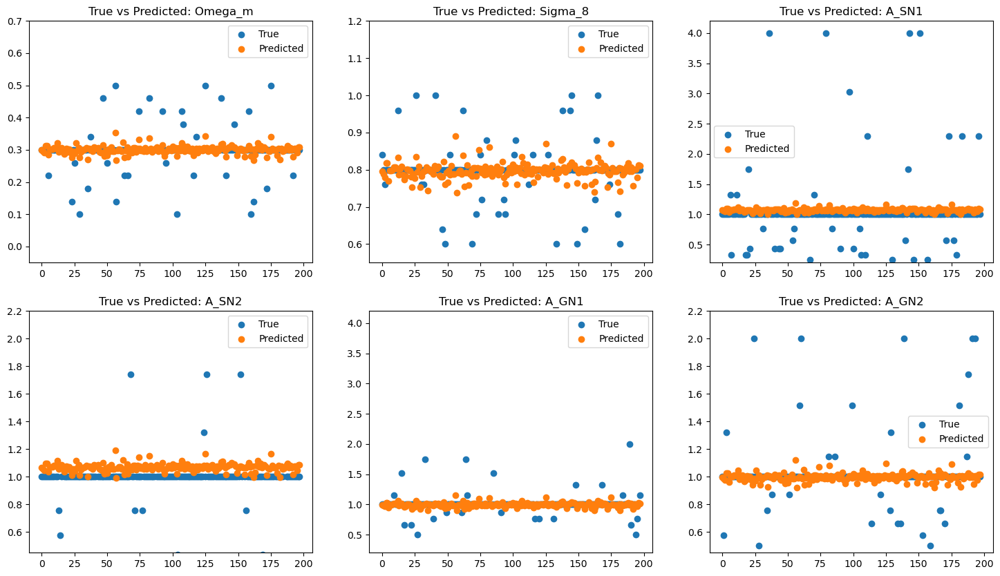

Map training on: Gas Velocity
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 24ms/step - loss: 0.3171 - val_loss: 0.0059 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0053 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 24ms/step - loss: 0.0034 - val_loss: 0.0030 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0029 - val_loss: 0.0024 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0030 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0031 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0026 - val_loss: 0.0023 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0023 - val_loss: 0.0022 - learni

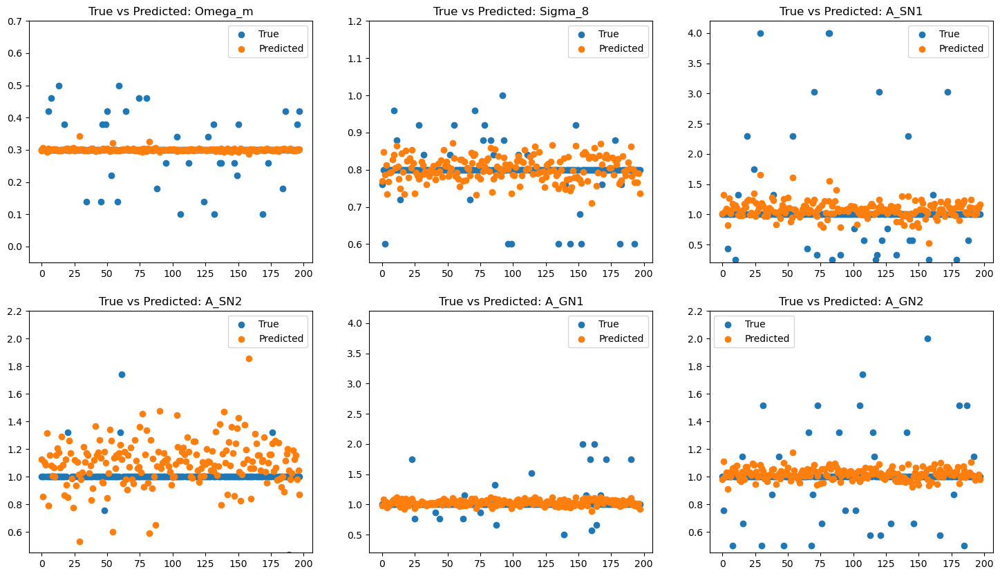

Map training on: Gas Metallicity
Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 16s 26ms/step - loss: 0.0383 - val_loss: 0.0124 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0093 - val_loss: 0.0039 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - loss: 0.0033 - val_loss: 0.0026 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0028 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - loss: 0.0024 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 6/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0021 - val_loss: 0.0025 - learning_rate: 0.0010
Epoch 7/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0025 - val_loss: 0.0025 - learning_rate: 5.0000e-04
Epoch 8/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 14s 24ms/step - loss: 0.0029 - val_loss: 0.0025 - lea

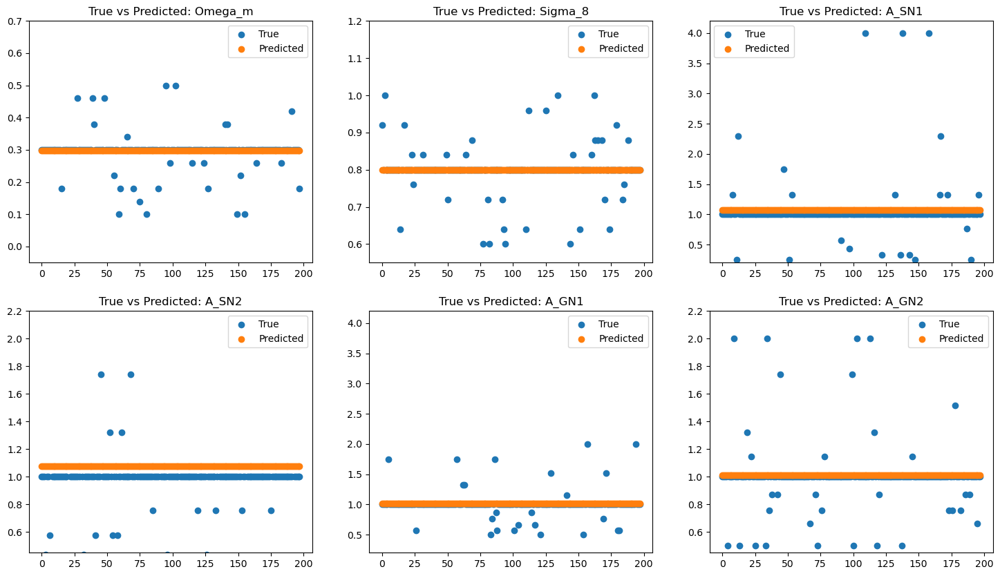

In [110]:
modelH_loss = test_models(create_modelH, (256,256,1))

### CAMELS Model

Map training on: Magnetic Fields
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
7/7 ━━━━━━━━━━━━━━━━━━━━ 4s 484ms/step


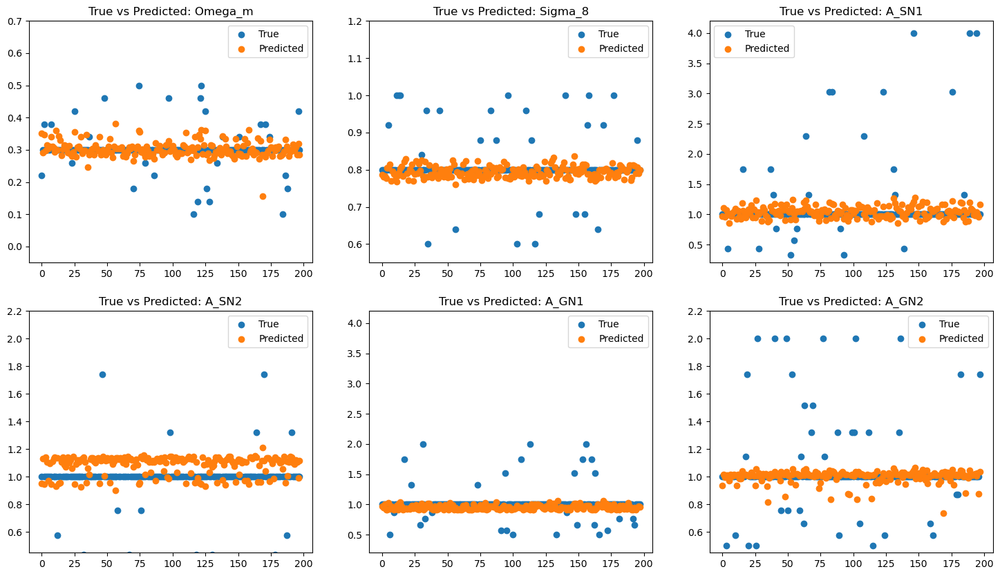

Map training on: Neutral Hydrogen Density
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]


KeyboardInterrupt: 

In [86]:
camels_model_loss = test_models(create_camels_model, (256,256,1))

### Results

In [237]:
def min_val(losses):
    '''
    This is a function which takes in the validation losses from training a model architecture on n fields,
    and returns a list of the minimum validation loss from each field.

    Args:
        losses: A list of validation losses from each time the model is tested on a new field.

    Returns:
        min_val_loss: a list of the minimum validation loss from each field
    '''
    min_val_loss = []
    for loss in losses:
        min_val_loss.append(min(loss))
    return min_val_loss

In [187]:
min_val_loss_dense = min_val(dense_model_loss)

In [238]:
min_val_lossA = min_val(modelA_loss)
min_val_lossB = min_val(modelB_loss)
min_val_lossC = min_val(modelC_loss)
min_val_lossD = min_val(modelD_loss)
min_val_lossE = min_val(modelE_loss)
min_val_lossF = min_val(modelF_loss)
min_val_lossG = min_val(modelG_loss)

In [241]:
total_min_losses = {}
total_min_losses_model = []
for i in range(len(map_names)):

    print(f'\nLowest Validation Loss for {map_names[i]}\n')

    #print(f'Dense Model: {min_val_loss_dense[i]}')
    print(f'Model A: {min_val_lossA[i]}')
    print(f'Model B: {min_val_lossB[i]}')
    print(f'Model C: {min_val_lossC[i]}')
    print(f'Model D: {min_val_lossD[i]}')
    print(f'Model E: {min_val_lossE[i]}')
    print(f'Model F: {min_val_lossF[i]}')
    print(f'Model G: {min_val_lossG[i]}')

    total_min_losses[map_names[i]] = min([min_val_lossA[i],min_val_lossB[i],min_val_lossC[i],min_val_lossD[i],
                                        min_val_lossE[i],min_val_lossF[i],min_val_lossG[i]])


print('\nAverage validation loss (across all fields)')

#print(f'Dense Model: {sum(min_val_loss_dense)/len(min_val_loss_dense)}')
print(f'Model A: {sum(min_val_lossA)/len(min_val_lossA)}')
print(f'Model B: {sum(min_val_lossB)/len(min_val_lossB)}')
print(f'Model C: {sum(min_val_lossC)/len(min_val_lossC)}')
print(f'Model D: {sum(min_val_lossD)/len(min_val_lossD)}')
print(f'Model E: {sum(min_val_lossE)/len(min_val_lossE)}')
print(f'Model F: {sum(min_val_lossF)/len(min_val_lossF)}')
print(f'Model G: {sum(min_val_lossG)/len(min_val_lossG)}')

print(f'\n{total_min_losses}')


Lowest Validation Loss for Magnetic Fields

Model A: 0.0714956521987915
Model B: 0.10607556253671646
Model C: 0.0777423083782196
Model D: 0.06291544437408447
Model E: 0.0669320821762085
Model F: 0.10865840315818787
Model G: 0.07382123917341232

Lowest Validation Loss for Neutral Hydrogen Density

Model A: 0.06993170827627182
Model B: 0.08565109968185425
Model C: 0.06831902265548706
Model D: 0.08073880523443222
Model E: 0.09282709658145905
Model F: 0.0777619406580925
Model G: 0.10321405529975891

Lowest Validation Loss for Dark Matter Density

Model A: 0.09818972647190094
Model B: 0.12649418413639069
Model C: 0.08955471962690353
Model D: 0.08968041092157364
Model E: 0.09066279232501984
Model F: 0.12210763990879059
Model G: 0.10614980012178421

Lowest Validation Loss for Gas Density

Model A: 0.06552831083536148
Model B: 0.07920155674219131
Model C: 0.06850569695234299
Model D: 0.07213405519723892
Model E: 0.08310389518737793
Model F: 0.06950646638870239
Model G: 0.07017295807600021

Lo

We see that overall, model E performed the worst, and all the other models have very similar losses - while training we could also see that all the models became stagnent very fast. This lines up with how simpler models (few filters) seemed to perform almost idential to more complex models. 

We don't have much data, hence this makes sense.

Looking at the predictions graphically (on the validation data), we see that certain fields have a much highter accuracy in the predictions compared to other fields. For example Magnetic Fields, Neutral Hydrogen Density, and Magnesium over iron have good predictions for all the parameters, however Dark Matter Velocity, total matter Density etc seem to only have good predictions for $\Omega_m$ and $\sigma_8$, but the model only predicts the most common value for the other 4 parameters. 

This suggests that some fields are not affected/ minimally affected by some of the parameters. We shall look more at this later.

## 3.2 Testing the models on multiple fields simultaneously

In [341]:
def test_models11(model_func, input_shape, data, weight_param , parameters,plot_preds = True):
    '''
    This is a function which creates, trains, and tests (on validation data) a specific model architecture
    on all 11 fields simultanteously (task 2).

    Args: 
        model_func: a function which returns a keras model architecture
        input_shape: the shape of the input data that is passed to model_func to create the model
        data: a combined array of the fields that I want to train on simultaneously
        weight_param: the weight parameter to use
        plot_preds: a boolean indicating whether I want to plot the predictions of the validation data

    Returns: 
        total_loss: a list of the validation losses from training
    '''
    total_loss = []
    
    X_train, X_test, y_train, y_test = format_data(grids = data,parameters = parameters, smooth = False, sigma_smooth = 0, noise = False, 
                sigma_noise = 0, normalise = True, test_size = 0.20)

    model = model_func(input_shape)
    history = compile_fit_model(model,X_train, y_train, validation_split = 594, epochs = 15, verbose = True,
                                batch_size = 1, weight_param = weight_param)
    
    total_loss.append(history.history['val_mse'])

    predictions = predict(model,X_train[594:])

    if plot_preds:
        plot_predictions(predictions, y_test, figure_save = False,image_name = '')        

    return total_loss, predictions

### Using 4 maps

In [293]:
# Creating a combined array with 2 maps: MgasMap and neMap
GasMap = np.stack([MgasMap, ZMap, TMap, VgasMap], axis=-1)

In [294]:
GasMap.shape

(990, 256, 256, 4)

Computed Weights: [0.25173904 0.25173904 0.0258503  0.0258503  0.06621718 0.06621718]
Epoch 1/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 11ms/step - loss: 0.0041 - mae: 0.1513 - mse: 0.1014 - val_loss: 0.0028 - val_mae: 0.1082 - val_mse: 0.0839 - learning_rate: 0.0010
Epoch 2/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0031 - mae: 0.1245 - mse: 0.0913 - val_loss: 0.0025 - val_mae: 0.1218 - val_mse: 0.0738 - learning_rate: 0.0010
Epoch 3/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 0.0027 - mae: 0.1134 - mse: 0.0726 - val_loss: 0.0026 - val_mae: 0.0999 - val_mse: 0.0731 - learning_rate: 0.0010
Epoch 4/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0031 - mae: 0.1155 - mse: 0.0893 - val_loss: 0.0027 - val_mae: 0.1196 - val_mse: 0.0792 - learning_rate: 0.0010
Epoch 5/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0023 - mae: 0.0976 - mse: 0.0639 - val_loss: 0.0021 - val_mae: 0.0884 - val_mse: 0.0602 - learning_rate: 5.0000e-04
Epoch 6/15
594/594 ━━━━━━━━━━━━━━━━

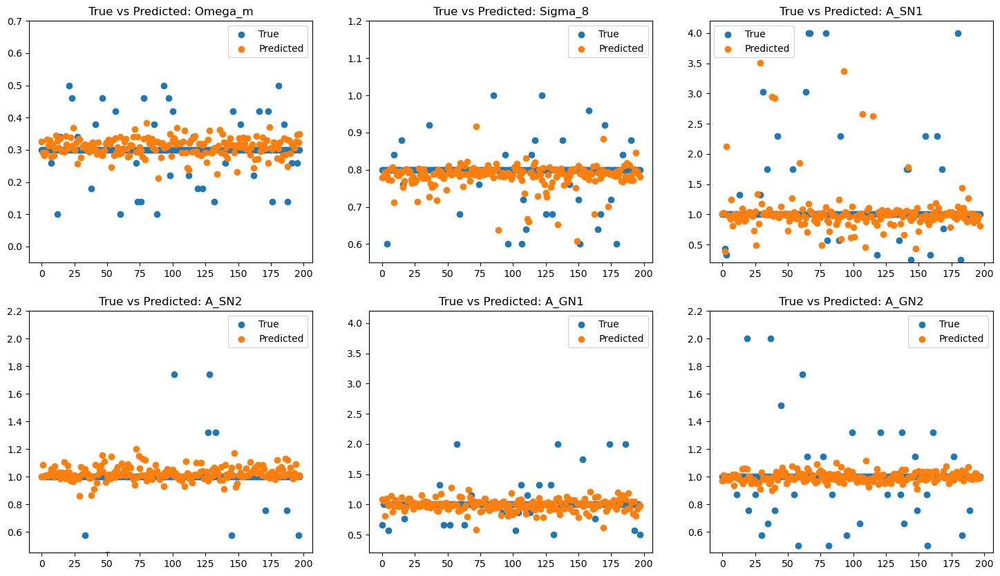

In [296]:
single_model_loss_11 = test_models11(tuned_model_single_map, input_shape = (256,256,4), data = GasMap, weight_param = 0.013)

### Using all 11 fields

Computed Weights: [0.25173904 0.25173904 0.0258503  0.0258503  0.06621718 0.06621718]
Epoch 1/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 13s 19ms/step - loss: 0.0057 - mae: 0.1788 - mse: 0.1301 - val_loss: 0.0033 - val_mae: 0.1334 - val_mse: 0.0856 - learning_rate: 0.0010
Epoch 2/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0036 - mae: 0.1366 - mse: 0.1041 - val_loss: 0.0031 - val_mae: 0.1273 - val_mse: 0.0800 - learning_rate: 0.0010
Epoch 3/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 0.0030 - mae: 0.1305 - mse: 0.0903 - val_loss: 0.0028 - val_mae: 0.1210 - val_mse: 0.0728 - learning_rate: 0.0010
Epoch 4/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0031 - mae: 0.1296 - mse: 0.0889 - val_loss: 0.0028 - val_mae: 0.1348 - val_mse: 0.0708 - learning_rate: 0.0010
Epoch 5/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - loss: 0.0036 - mae: 0.1375 - mse: 0.1064 - val_loss: 0.0025 - val_mae: 0.1119 - val_mse: 0.0646 - learning_rate: 0.0010
Epoch 6/15
594/594 ━━━━━━━━━━━━━━━━━━━

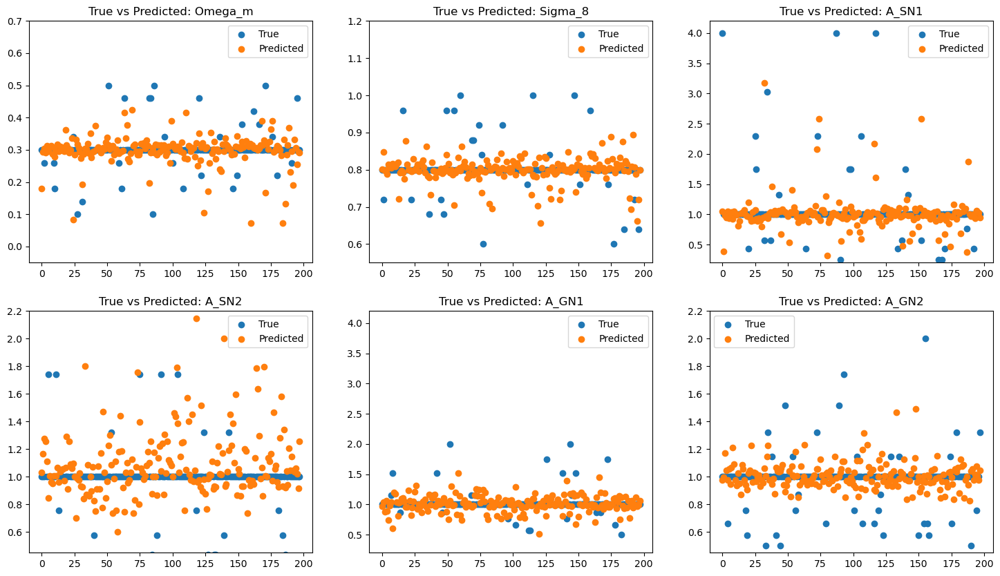

In [311]:
single_model_loss_11 = test_models11(tuned_model_single_map, input_shape = (256,256,11), data = combined_array, weight_param = 0.013)

## 3.3 Predicting only $\Omega_m$

Let's use the same model architecture as we have been using previously. But now we need to split our label parameters so that they only have the parameters for $\Omega_m$

In [81]:
params.shape

(66, 6)

In [374]:
params_omega = params[:, :1] 
params_omega.shape

(66, 1)

Now let's define a model which takes in the output shape we want as a parameter so we can easily use the same base architeture for predicting any number of parameters

In [338]:
def create_1out_model(input_shape, output_shape=1):

    model = keras.Sequential([
        keras.Input(shape=input_shape),
        data_augmentation,
    
        keras.layers.Conv2D(16, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(32, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(64, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),

        keras.layers.Conv2D(128, (3,3), padding='valid', strides = 2),
        keras.layers.LeakyReLU(0.01),
        
        keras.layers.Flatten(),       
        keras.layers.Dense(output_shape, activation = 'softplus')
    ])
    return model

In [344]:
X_train_omega, X_test_omega, y_train_omega, y_test_omega = format_data(grids = GasMap,parameters = params_omega,
                                                                       smooth = False, sigma_smooth = 0, noise = False,test_size = 0.20)

In [345]:
omega_model = create_1out_model((256,256,4), 1)
omega_history = compile_fit_model(omega_model,X_train_omega, y_train_omega, validation_split = 594, epochs = 20, verbose = True,
                                batch_size = 1, weight_param = 0.01)

Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - loss: 8.5672e-04 - mae: 0.0676 - mse: 0.0097 - val_loss: 1.4472e-04 - val_mae: 0.0340 - val_mse: 0.0016 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 1.4512e-04 - mae: 0.0310 - mse: 0.0016 - val_loss: 6.1687e-05 - val_mae: 0.0171 - val_mse: 6.9975e-04 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 1.0998e-04 - mae: 0.0261 - mse: 0.0012 - val_loss: 1.2062e-04 - val_mae: 0.0310 - val_mse: 0.0014 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 5.7009e-05 - mae: 0.0191 - mse: 6.4669e-04 - val_loss: 8.0965e-05 - val_mae: 0.0266 - val_mse: 9.1844e-04 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 2.8970e-05 - mae: 0.0140 - mse: 3.2862e-04 - val_loss: 5.7065e-05 - val_mae: 0.0212 - val_mse: 6.4732e-04 - 

In [387]:
omega_predictions = omega_model.predict(X_train_omega[594:])

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step 


<>:3: SyntaxWarning:

invalid escape sequence '\O'

<>:3: SyntaxWarning:

invalid escape sequence '\O'

/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/3733315287.py:3: SyntaxWarning:

invalid escape sequence '\O'



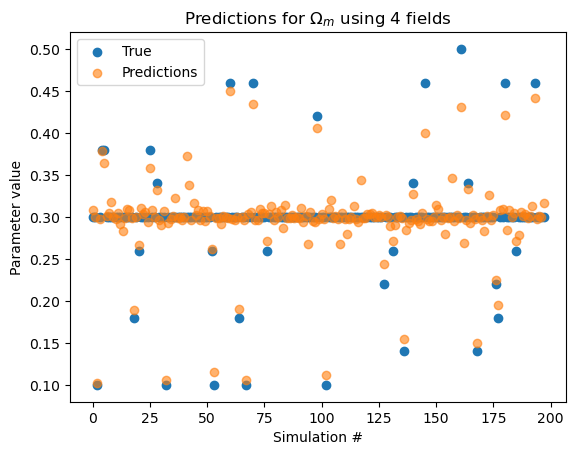

In [389]:
plt.scatter([x for x in range(len(y_train_omega[594:]))], y_train_omega[594:], label = 'True')
plt.scatter([x for x in range(len(omega_predictions))],omega_predictions, label = 'Predictions', alpha = 0.6)
plt.title('Predictions for $\Omega_m$ using 4 fields')
plt.xlabel('Simulation #')
plt.ylabel('Parameter value')
plt.savefig('omega_m preds 4 maps')
plt.legend()

<>:6: SyntaxWarning:

invalid escape sequence '\O'

<>:6: SyntaxWarning:

invalid escape sequence '\O'

/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/1998105139.py:6: SyntaxWarning:

invalid escape sequence '\O'



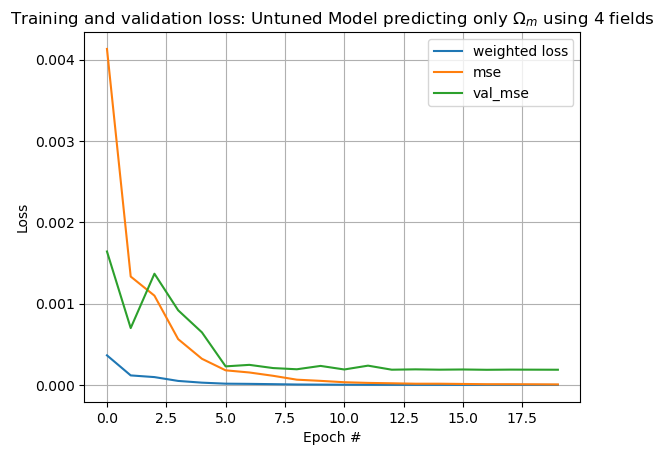

In [367]:
epoch_range = [x for x in range(0,20)]
plt.figure()
plt.plot(epoch_range, omega_history.history["loss"], label="weighted loss")
plt.plot(epoch_range, omega_history.history["mse"], label="mse")
plt.plot(epoch_range, omega_history.history["val_mse"], label="val_mse")
plt.title("Training and validation loss: Untuned Model predicting only $\Omega_m$ using 4 fields")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.grid()
plt.legend(loc="upper right")
plt.savefig('Train val loss untuned omega 4maps')

In [143]:
import numpy as np
from scipy.stats import mode

# Example: Your (66,6) NumPy array
most_common_values, _ = mode(params, axis=0, keepdims=False)

print("Most common values for each parameter:", most_common_values)


Most common values for each parameter: [0.3 0.8 1.  1.  1.  1. ]


## Predcting the rest of the parameters

In [410]:
params_sigma = params[:, 1:2] 
params_ASN1 = params[:, :1:3]
params_ASN2 = params[:, :1:4]
params_AGN1 = params[:, :1:5]
params_AGN2 = params[:, :1:6]
params_sigma.shape

(66, 1)

In [378]:
X_train_sigma, X_test_sigma, y_train_sigma, y_test_sigma = format_data(grids = GasMap,parameters = params_sigma,
                                                                       smooth = False, sigma_smooth = 0, noise = False,test_size = 0.20)

sigma_model = create_1out_model((256,256,4), 1)
sigma_history = compile_fit_model(sigma_model,X_train_sigma, y_train_sigma, validation_split = 594, epochs = 20, verbose = True,
                                batch_size = 1, weight_param = 0.01)

Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 4.4366e-04 - mae: 0.0479 - mse: 0.0050 - val_loss: 1.8123e-04 - val_mae: 0.0262 - val_mse: 0.0021 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 2.2118e-04 - mae: 0.0308 - mse: 0.0025 - val_loss: 1.4531e-04 - val_mae: 0.0234 - val_mse: 0.0016 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 2.0280e-04 - mae: 0.0281 - mse: 0.0023 - val_loss: 1.8614e-04 - val_mae: 0.0330 - val_mse: 0.0021 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 1.5690e-04 - mae: 0.0230 - mse: 0.0018 - val_loss: 1.7549e-04 - val_mae: 0.0303 - val_mse: 0.0020 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 1.1795e-04 - mae: 0.0218 - mse: 0.0013 - val_loss: 1.5256e-04 - val_mae: 0.0253 - val_mse: 0.0017 - learning_rate: 5.00

In [379]:
X_train_ASN1, X_test_ASN1, y_train_ASN1, y_test_ASN1 = format_data(grids = GasMap,parameters = params_ASN1,
                                                                       smooth = False, sigma_smooth = 0, noise = False,test_size = 0.20)

ASN1_model = create_1out_model((256,256,4), 1)
ASN1_history = compile_fit_model(ASN1_model,X_train_ASN1, y_train_ASN1, validation_split = 594, epochs = 20, verbose = True,
                                batch_size = 1, weight_param = 0.01)

Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 10ms/step - loss: 8.1005e-04 - mae: 0.0658 - mse: 0.0092 - val_loss: 7.5749e-05 - val_mae: 0.0209 - val_mse: 8.5927e-04 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 8.7098e-05 - mae: 0.0239 - mse: 9.8800e-04 - val_loss: 7.2111e-05 - val_mae: 0.0216 - val_mse: 8.1800e-04 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 7.5232e-05 - mae: 0.0227 - mse: 8.5340e-04 - val_loss: 6.4735e-05 - val_mae: 0.0178 - val_mse: 7.3433e-04 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 4.9705e-05 - mae: 0.0164 - mse: 5.6384e-04 - val_loss: 5.5050e-05 - val_mae: 0.0141 - val_mse: 6.2446e-04 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 4.4197e-05 - mae: 0.0158 - mse: 5.0135e-04 - val_loss: 3.6162e-05 - val_mae: 0.0163 - val_ms

In [380]:
X_train_ASN2, X_test_ASN2, y_train_ASN2, y_test_ASN2 = format_data(grids = GasMap,parameters = params_ASN2,
                                                                       smooth = False, sigma_smooth = 0, noise = False,test_size = 0.20)

ASN2_model = create_1out_model((256,256,4), 1)
ASN2_history = compile_fit_model(ASN2_model,X_train_ASN2, y_train_ASN2, validation_split = 594, epochs = 20, verbose = True,
                                batch_size = 1, weight_param = 0.01)

Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 10ms/step - loss: 9.6636e-04 - mae: 0.0680 - mse: 0.0110 - val_loss: 8.6477e-05 - val_mae: 0.0218 - val_mse: 9.8095e-04 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 1.1086e-04 - mae: 0.0274 - mse: 0.0013 - val_loss: 4.6139e-05 - val_mae: 0.0163 - val_mse: 5.2339e-04 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 7.7022e-05 - mae: 0.0226 - mse: 8.7371e-04 - val_loss: 1.1048e-04 - val_mae: 0.0290 - val_mse: 0.0013 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 11ms/step - loss: 6.0683e-05 - mae: 0.0194 - mse: 6.8837e-04 - val_loss: 3.8768e-05 - val_mae: 0.0137 - val_mse: 4.3977e-04 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 2.9643e-05 - mae: 0.0137 - mse: 3.3626e-04 - val_loss: 6.7985e-05 - val_mae: 0.0231 - val_mse: 7.712

In [381]:
X_train_AGN1, X_test_AGN1, y_train_AGN1, y_test_AGN1 = format_data(grids = GasMap,parameters = params_AGN1,
                                                                       smooth = False, sigma_smooth = 0, noise = False,test_size = 0.20)

AGN1_model = create_1out_model((256,256,4), 1)
AGN1_history = compile_fit_model(AGN1_model,X_train_AGN1, y_train_AGN1, validation_split = 594, epochs = 20, verbose = True,
                                batch_size = 1, weight_param = 0.01)

Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 11ms/step - loss: 6.5279e-04 - mae: 0.0588 - mse: 0.0074 - val_loss: 7.7475e-05 - val_mae: 0.0216 - val_mse: 8.7885e-04 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 8.1642e-05 - mae: 0.0232 - mse: 9.2612e-04 - val_loss: 5.9471e-05 - val_mae: 0.0173 - val_mse: 6.7462e-04 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - loss: 7.1461e-05 - mae: 0.0227 - mse: 8.1062e-04 - val_loss: 6.9275e-05 - val_mae: 0.0200 - val_mse: 7.8582e-04 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 3.0591e-05 - mae: 0.0130 - mse: 3.4701e-04 - val_loss: 4.5408e-05 - val_mae: 0.0178 - val_mse: 5.1509e-04 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 2.0088e-05 - mae: 0.0112 - mse: 2.2787e-04 - val_loss: 2.9712e-05 - val_mae: 0.0104 - val_mse

In [382]:
X_train_AGN2, X_test_AGN2, y_train_AGN2, y_test_AGN2 = format_data(grids = GasMap,parameters = params_AGN2,
                                                                       smooth = False, sigma_smooth = 0, noise = False,test_size = 0.20)

AGN2_model = create_1out_model((256,256,4), 1)
AGN2_history = compile_fit_model(AGN2_model,X_train_AGN2, y_train_AGN2, validation_split = 594, epochs = 20, verbose = True,
                                batch_size = 1, weight_param = 0.01)

Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 7.4073e-04 - mae: 0.0621 - mse: 0.0084 - val_loss: 7.5484e-05 - val_mae: 0.0186 - val_mse: 8.5626e-04 - learning_rate: 0.0010
Epoch 2/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 1.1670e-04 - mae: 0.0274 - mse: 0.0013 - val_loss: 1.0234e-04 - val_mae: 0.0264 - val_mse: 0.0012 - learning_rate: 0.0010
Epoch 3/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 8.2602e-05 - mae: 0.0226 - mse: 9.3700e-04 - val_loss: 6.8190e-05 - val_mae: 0.0199 - val_mse: 7.7352e-04 - learning_rate: 0.0010
Epoch 4/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 4.2757e-05 - mae: 0.0165 - mse: 4.8502e-04 - val_loss: 6.2576e-05 - val_mae: 0.0136 - val_mse: 7.0984e-04 - learning_rate: 5.0000e-04
Epoch 5/20
594/594 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - loss: 4.2598e-05 - mae: 0.0159 - mse: 4.8322e-04 - val_loss: 3.5516e-05 - val_mae: 0.0151 - val_mse: 4.0287

In [394]:
sigma_predictions = sigma_model.predict(X_train_sigma[594:])
ASN1_predictions = ASN1_model.predict(X_train_ASN1[594:])
ASN2_predictions = ASN2_model.predict(X_train_ASN2[594:])
AGN1_predictions = AGN1_model.predict(X_train_AGN1[594:])
AGN2_predictions = AGN2_model.predict(X_train_AGN2[594:])

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step 
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


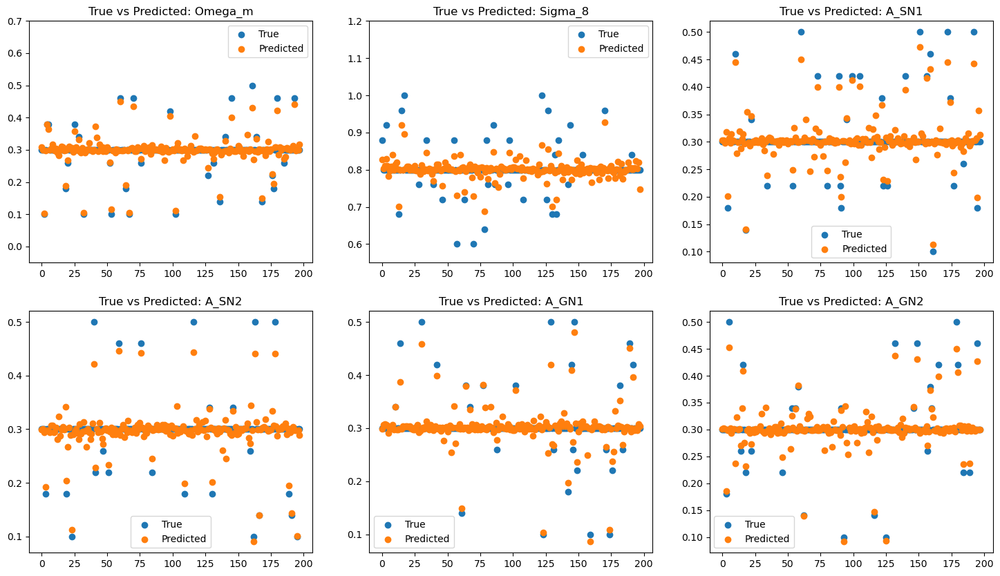

In [393]:
fig,ax=plt.subplots(2,3, figsize = (18,10))

ax[0,0].set_ylim([-0.05, 0.7])
ax[0,0].scatter([x for x in range(len(predictions))],y_train_omega[594:] , label = 'True')
ax[0,0].scatter([x for x in range(len(predictions))],omega_predictions, label = 'Predicted')
ax[0,0].set_title('True vs Predicted: Omega_m')
ax[0,0].legend()

ax[0,1].set_ylim([0.55, 1.2])
ax[0,1].scatter([x for x in range(len(predictions))],y_train_sigma[594:] , label = 'True')
ax[0,1].scatter([x for x in range(len(predictions))],sigma_predictions, label = 'Predicted')
ax[0,1].set_title('True vs Predicted: Sigma_8')
ax[0,1].legend()

#ax[0,2].set_ylim([0.20, 4.2])
ax[0,2].scatter([x for x in range(len(predictions))],y_train_ASN1[594:] , label = 'True')
ax[0,2].scatter([x for x in range(len(predictions))],ASN1_predictions, label = 'Predicted')
ax[0,2].set_title('True vs Predicted: A_SN1')
ax[0,2].legend()

#ax[1,0].set_ylim([0.45, 2.2])
ax[1,0].scatter([x for x in range(len(predictions))],y_train_ASN2[594:] , label = 'True')
ax[1,0].scatter([x for x in range(len(predictions))],ASN2_predictions, label = 'Predicted')
ax[1,0].set_title('True vs Predicted: A_SN2')
ax[1,0].legend()

#ax[1,1].set_ylim([0.20, 4.2])
ax[1,1].scatter([x for x in range(len(predictions))],y_train_AGN1[594:] , label = 'True')
ax[1,1].scatter([x for x in range(len(predictions))],AGN1_predictions, label = 'Predicted')
ax[1,1].set_title('True vs Predicted: A_GN1')
ax[1,1].legend()

#ax[1,2].set_ylim([0.45, 2.2])
ax[1,2].scatter([x for x in range(len(predictions))],y_train_AGN2[594:] , label = 'True')
ax[1,2].scatter([x for x in range(len(predictions))],AGN2_predictions, label = 'Predicted')
ax[1,2].set_title('True vs Predicted: A_GN2')
ax[1,2].legend()

plt.savefig('All val preds single models')
plt.show()

    


<>:7: SyntaxWarning:

invalid escape sequence '\O'

<>:16: SyntaxWarning:

invalid escape sequence '\s'

<>:7: SyntaxWarning:

invalid escape sequence '\O'

<>:16: SyntaxWarning:

invalid escape sequence '\s'

/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/3982141821.py:7: SyntaxWarning:

invalid escape sequence '\O'

/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/3982141821.py:16: SyntaxWarning:

invalid escape sequence '\s'



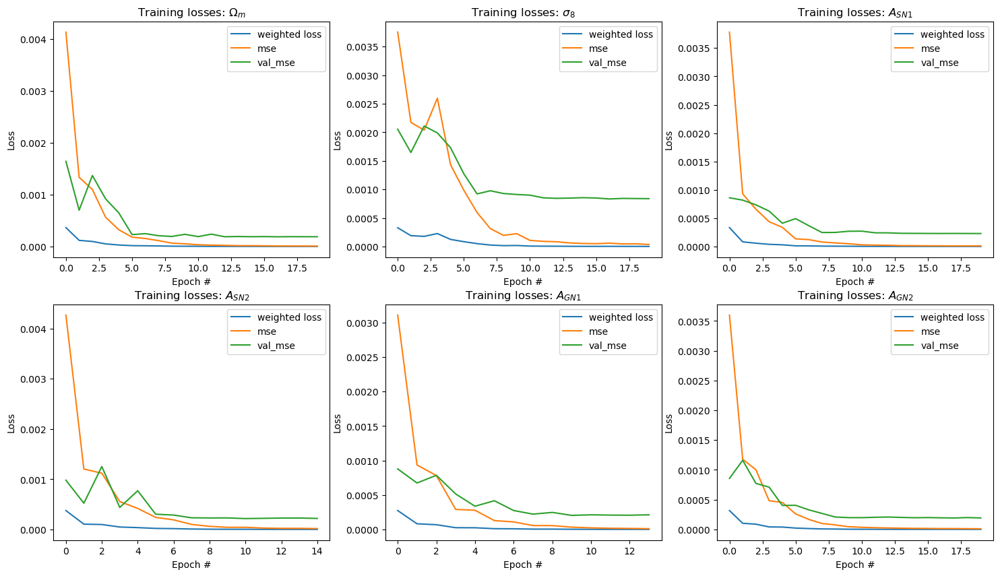

In [409]:
fig,ax=plt.subplots(2,3, figsize = (18,10))


ax[0,0].plot([x for x in range (len(omega_history.history["loss"]))], omega_history.history["loss"], label="weighted loss")
ax[0,0].plot([x for x in range (len(omega_history.history["loss"]))], omega_history.history["mse"], label="mse")
ax[0,0].plot([x for x in range (len(omega_history.history["loss"]))], omega_history.history["val_mse"], label="val_mse")
ax[0,0].set_title('Training losses: $\Omega_m$')
ax[0,0].set_xlabel('Epoch #')
ax[0,0].set_ylabel('Loss')
ax[0,0].legend()


ax[0,1].plot([x for x in range (len(sigma_history.history["loss"]))], sigma_history.history["loss"], label="weighted loss")
ax[0,1].plot([x for x in range (len(sigma_history.history["loss"]))], sigma_history.history["mse"], label="mse")
ax[0,1].plot([x for x in range (len(sigma_history.history["loss"]))], sigma_history.history["val_mse"], label="val_mse")
ax[0,1].set_title('Training losses: $\sigma_8$')
ax[0,1].set_xlabel('Epoch #')
ax[0,1].set_ylabel('Loss')
ax[0,1].legend()

ax[0,2].plot([x for x in range (len(ASN1_history.history["loss"]))], ASN1_history.history["loss"], label="weighted loss")
ax[0,2].plot([x for x in range (len(ASN1_history.history["loss"]))], ASN1_history.history["mse"], label="mse")
ax[0,2].plot([x for x in range (len(ASN1_history.history["loss"]))], ASN1_history.history["val_mse"], label="val_mse")
ax[0,2].set_title('Training losses: $A_{SN1}$')
ax[0,2].set_xlabel('Epoch #')
ax[0,2].set_ylabel('Loss')
ax[0,2].legend()


ax[1,0].plot([x for x in range (len(ASN2_history.history["loss"]))], ASN2_history.history["loss"], label="weighted loss")
ax[1,0].plot([x for x in range (len(ASN2_history.history["loss"]))], ASN2_history.history["mse"], label="mse")
ax[1,0].plot([x for x in range (len(ASN2_history.history["loss"]))], ASN2_history.history["val_mse"], label="val_mse")
ax[1,0].set_title('Training losses: $A_{SN2}$')
ax[1,0].set_xlabel('Epoch #')
ax[1,0].set_ylabel('Loss')
ax[1,0].legend()


ax[1,1].plot([x for x in range (len(AGN1_history.history["loss"]))], AGN1_history.history["loss"], label="weighted loss")
ax[1,1].plot([x for x in range (len(AGN1_history.history["loss"]))], AGN1_history.history["mse"], label="mse")
ax[1,1].plot([x for x in range (len(AGN1_history.history["loss"]))], AGN1_history.history["val_mse"], label="val_mse")
ax[1,1].set_title('Training losses: $A_{GN1}$')
ax[1,1].set_xlabel('Epoch #')
ax[1,1].set_ylabel('Loss')
ax[1,1].legend()


ax[1,2].plot([x for x in range (len(AGN2_history.history["loss"]))], AGN2_history.history["loss"], label="weighted loss")
ax[1,2].plot([x for x in range (len(AGN2_history.history["loss"]))], AGN2_history.history["mse"], label="mse")
ax[1,2].plot([x for x in range (len(AGN2_history.history["loss"]))], AGN2_history.history["val_mse"], label="val_mse")
ax[1,2].set_title('Training losses: $A_{GN2}$')
ax[1,2].set_xlabel('Epoch #')
ax[1,2].set_ylabel('Loss')
ax[1,2].legend()

plt.savefig('All losses single models')
plt.show()

### Final testing

In [412]:
testomega_predictions = omega_model.predict(X_test_omega)
testsigma_predictions = sigma_model.predict(X_test_sigma)
testASN1_predictions = ASN1_model.predict(X_test_ASN1)
testASN2_predictions = ASN2_model.predict(X_test_ASN2)
testAGN1_predictions = AGN1_model.predict(X_test_AGN1)
testAGN2_predictions = AGN2_model.predict(X_test_AGN2)

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


<>:5: SyntaxWarning:

invalid escape sequence '\O'

<>:10: SyntaxWarning:

invalid escape sequence '\s'

<>:5: SyntaxWarning:

invalid escape sequence '\O'

<>:10: SyntaxWarning:

invalid escape sequence '\s'

/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/1842696135.py:5: SyntaxWarning:

invalid escape sequence '\O'

/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/1842696135.py:10: SyntaxWarning:

invalid escape sequence '\s'



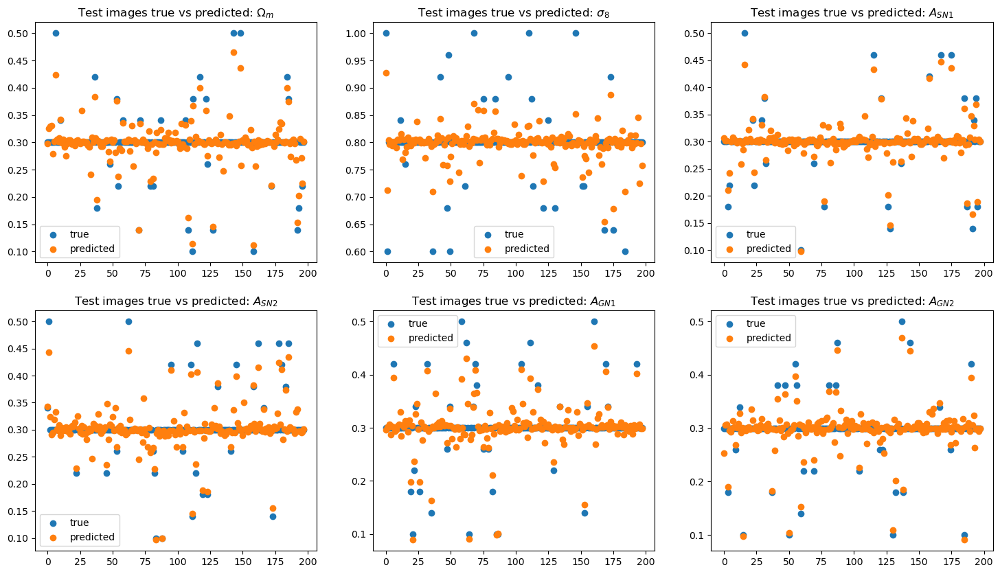

In [417]:
fig,ax=plt.subplots(2,3, figsize = (18,10))

ax[0,0].scatter([x for x in range (len( y_test_omega))], y_test_omega, label="true")
ax[0,0].scatter([x for x in range (len(testomega_predictions))], testomega_predictions, label="predicted")
ax[0,0].set_title('Test images true vs predicted: $\Omega_m$')
ax[0,0].legend()

ax[0,1].scatter([x for x in range (len( y_test_sigma))], y_test_sigma, label="true")
ax[0,1].scatter([x for x in range (len(testsigma_predictions))], testsigma_predictions, label="predicted")
ax[0,1].set_title('Test images true vs predicted: $\sigma_8$')
ax[0,1].legend()

ax[0,2].scatter([x for x in range (len( y_test_ASN1))], y_test_ASN1, label="true")
ax[0,2].scatter([x for x in range (len(testASN1_predictions))], testASN1_predictions, label="predicted")
ax[0,2].set_title('Test images true vs predicted: $A_{SN1}$')
ax[0,2].legend()

ax[1,0].scatter([x for x in range (len( y_test_ASN2))], y_test_ASN2, label="true")
ax[1,0].scatter([x for x in range (len(testASN2_predictions))], testASN2_predictions, label="predicted")
ax[1,0].set_title('Test images true vs predicted: $A_{SN2}$')
ax[1,0].legend()

ax[1,1].scatter([x for x in range (len( y_test_AGN1))], y_test_AGN1, label="true")
ax[1,1].scatter([x for x in range (len(testAGN1_predictions))], testAGN1_predictions, label="predicted")
ax[1,1].set_title('Test images true vs predicted: $A_{GN1}$')
ax[1,1].legend()

ax[1,2].scatter([x for x in range (len( y_test_AGN2))], y_test_AGN2, label="true")
ax[1,2].scatter([x for x in range (len(testAGN2_predictions))], testAGN2_predictions, label="predicted")
ax[1,2].set_title('Test images true vs predicted: $A_{GN2}$')
ax[1,2].legend()

plt.savefig('Test preds final')
plt.show()

##  NOT IN REPORT (Trying one model but with 2 separate outputs)

In [191]:
from tensorflow.keras.layers import Input, Conv2D, LeakyReLU, Flatten, Dense

def create_model_2out(input_shape):
    # Input layer
    inputs = Input(shape=input_shape)

    # Data augmentation (if defined elsewhere)
    x = data_augmentation(inputs)  

    # Shared convolutional layers
    x = Conv2D(32, (4,4), padding='valid', strides=2)(x)
    x = LeakyReLU(0.1)(x)

    x = Conv2D(64, (4,4), padding='valid', strides=2)(x)
    x = LeakyReLU(0.1)(x)

    x = Conv2D(128, (4,4), padding='valid', strides=2)(x)
    x = LeakyReLU(0.1)(x)

    x = Flatten()(x)
    x = Dense(16, activation='tanh')(x)

    # Separate output branches
    output_uniform = Dense(2, activation='linear', name="uniform_outputs")(x)  # First 2 params
    output_log_normal = Dense(4, activation='softplus', name="log_normal_outputs")(x)  # Last 4 params

    # Define model with two outputs
    model = keras.Model(inputs=inputs, outputs=[output_uniform, output_log_normal])

    return model

In [192]:
X_train, X_test, y_train, y_test = format_data(grids = bMap,parameters= params, smooth = False, sigma_smooth =0, noise= False,
                                                sigma_noise = 0, normalise = True, test_size = 0.2)

In [193]:
from tensorflow.keras.losses import MeanSquaredError

# Compute standard deviations (for weighting)
param_std = np.std(y_train, axis=0)  # y_train has shape (num_samples, 6)

# Inverse standard deviation weighting (add small epsilon to avoid division by zero)
weights = 0.01 / (param_std + 1e-6)

# Split weights for both output layers
weights_uniform = weights[:2]  # First 2 parameters (uniform)
weights_log_normal = weights[2:]  # Last 4 parameters (log-normal)

In [194]:
def dynamic_weighted_mse(weights):
    def loss_fn(y_true, y_pred):
        # Ensure inputs are tensors
        y_true = tf.convert_to_tensor(y_true, dtype=tf.float32)
        y_pred = tf.convert_to_tensor(y_pred, dtype=tf.float32)
        weights_tensor = tf.constant(weights, dtype=tf.float32)
        
        # Compute weighted MSE
        error = tf.square(y_true - y_pred)  # Squared error
        weighted_error = weights_tensor * error  # Apply per-parameter weight
        return tf.reduce_mean(weighted_error)  # Return scalar loss
    return loss_fn

In [196]:
model = create_model_2out((256,256,1))

callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
lr_callback = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=1, min_lr=1e-6)

model.compile(optimizer='adam',loss={
        "uniform_outputs": dynamic_weighted_mse(weights_uniform),  # First 2 params
        "log_normal_outputs": dynamic_weighted_mse(weights_log_normal),} ) # Last 4 params})

history = model.fit(X_train, {"uniform_outputs": y_train[:, :2], "log_normal_outputs": y_train[:, 2:]}, epochs=20, batch_size=32,
    validation_data=(X_train[600:],  
        {"uniform_outputs": y_train[600:, :2], "log_normal_outputs": y_train[600:, 2:]}),callbacks=[callback, lr_callback])

predictions_1, predictions_2 = predict(model,X_test)
predictions =np.hstack((predictions_1, predictions_2))

Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 13s 479ms/step - log_normal_outputs_loss: 0.0097 - loss: 0.3837 - uniform_outputs_loss: 0.3739 - val_log_normal_outputs_loss: 0.0057 - val_loss: 0.0231 - val_uniform_outputs_loss: 0.0174 - learning_rate: 0.0010
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 14s 546ms/step - log_normal_outputs_loss: 0.0047 - loss: 0.0200 - uniform_outputs_loss: 0.0154 - val_log_normal_outputs_loss: 0.0042 - val_loss: 0.0109 - val_uniform_outputs_loss: 0.0067 - learning_rate: 0.0010
Epoch 3/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 12s 483ms/step - log_normal_outputs_loss: 0.0035 - loss: 0.0079 - uniform_outputs_loss: 0.0045 - val_log_normal_outputs_loss: 0.0038 - val_loss: 0.0076 - val_uniform_outputs_loss: 0.0038 - learning_rate: 0.0010
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 442ms/step - log_normal_outputs_loss: 0.0034 - loss: 0.0073 - uniform_outputs_loss: 0.0039 - val_log_normal_outputs_loss: 0.0036 - val_loss: 0.0044 - val_uniform_outputs_loss: 7.5996e-04 - learning_rate: 0.0010


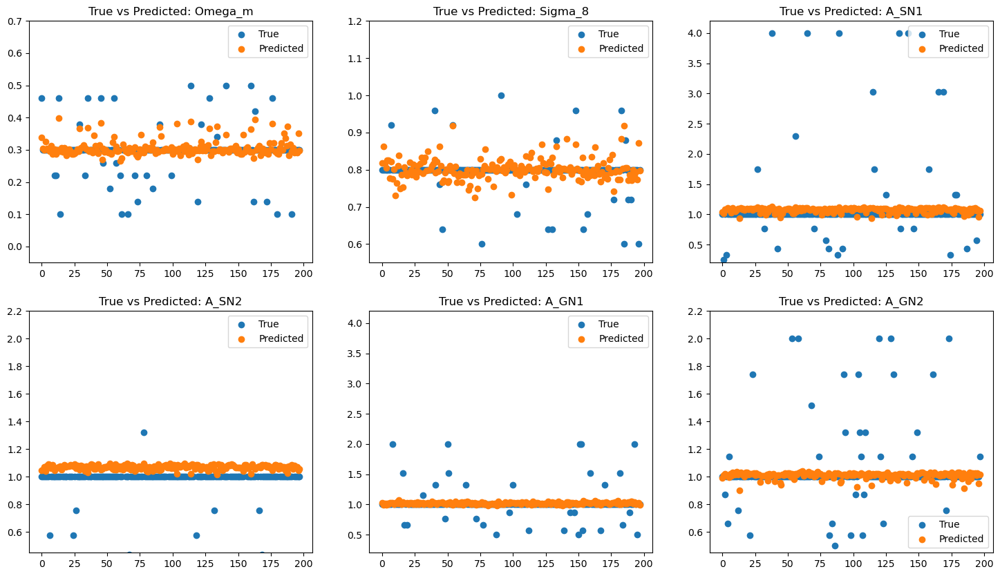

In [197]:
plot_predictions(predictions, y_test, figure_save = False,image_name = '')

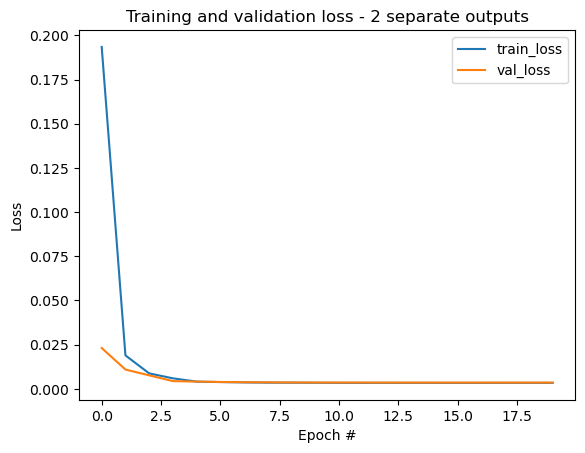

In [198]:
epoch_range = [x for x in range(0,20)]
plt.figure()
plt.plot(epoch_range, history.history["loss"], label="train_loss")
plt.plot(epoch_range, history.history["val_loss"], label="val_loss")
plt.title("Training and validation loss - 2 separate outputs")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="upper right")

# 4. Running tests to get a range of hyperparameters to try

We have a few hyperparameters to train: 

    - standard deviation of the noise added (if at all)
    - standard deviation of smoothing added (if at all)
    - batch size
    - weight parameter for the weighted mse loss function 
    - the number of filters per Conv2D layer
    - leaky relu parameter fo each layer 
    - the number of nodes in the final dense layers (if any)
    - dropout percentages (if any)

As we have quite a lot of parameters, and my computer can't really handle brute forcing through all of these simultaneously, I will take a holistic approch of doing some short tests to get ranges of parameters that I want to try by simply experimenting, and what one/two model architecture(s) that I will end up using, and then use the Optuna hyperparameter tuning package to further tune these. 

From the experiments above we have that the best 2 model architectures were:

## 4.1 WEIGHTED MSE PARAMETER

In [222]:
mse_range = np.array([x for x in range(1,20,2)])/100
mse_range

array([0.01, 0.03, 0.05, 0.07, 0.09, 0.11, 0.13, 0.15, 0.17, 0.19])

In [213]:
mse_range = (np.array([x for x in range(1,20,2)]))/100

validation_loss = []

param_std = np.std(params, axis=0)  # Compute standard deviation

for param in mse_range:
    model = create_modelF((256,256,1))
    X_train, X_test, y_train, y_test = format_data(bMap,params, smooth = False, sigma_smooth = 0, noise = False,
                                                sigma_noise = 0, normalise = True, test_size = 0.20)

    # Define weights as inverse of standard deviation (rarer values get higher weight)
    weights = param/(param_std + 1e-6)  # Avoid division by zero
    print("Computed Weights:", weights)  # Check the computed values
    
    # Define loss function using computed weights
    def dynamic_weighted_mse(y_true, y_pred):
        weights_tensor = tf.constant(weights, dtype=tf.float32)
        error = tf.square(y_true - y_pred)
        weighted_error = weights_tensor * error
        return tf.reduce_mean(weighted_error)

    model.compile(optimizer = 'adam', loss = dynamic_weighted_mse, metrics = ['mse'])
    callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
    lr_callback = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)

    #model.summary()
    history = model.fit(x=X_train, y=y_train, epochs = 15, validation_data = (
            X_train[594:], y_train[594:]), verbose = False, callbacks=[callback,lr_callback], batch_size = 1)

    validation_loss.append(history.history["val_mse"])

Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Computed Weights: [0.58093625 0.58093625 0.05965454 0.05965454 0.15280887 0.15280887]
Computed Weights: [0.96822709 0.96822709 0.09942424 0.09942424 0.25468145 0.25468145]
Computed Weights: [1.35551792 1.35551792 0.13919393 0.13919393 0.35655402 0.35655402]
Computed Weights: [1.74280876 1.74280876 0.17896362 0.17896362 0.4584266  0.4584266 ]
Computed Weights: [2.13009959 2.13009959 0.21873332 0.21873332 0.56029918 0.56029918]
Computed Weights: [2.51739043 2.51739043 0.25850301 0.25850301 0.66217176 0.66217176]
Computed Weights: [2.90468126 2.90468126 0.29827271 0.29827271 0.76404434 0.76404434]
Computed Weights: [3.2919721  3.2919721  0.3380424  0.3380424  0.86591692 0.86591692]
Computed Weights: [3.67926293 3.67926293 0.3778121  0.3778121  0.9677895  0.9677895 ]


In [216]:
min_loss = []
for loss in validation_loss:
    min_loss.append(min(loss))

In [217]:
min_loss

[0.014252377673983574,
 0.017581870779395103,
 0.017819944769144058,
 0.020225098356604576,
 0.015970952808856964,
 0.013166782446205616,
 0.00972110778093338,
 0.017641369253396988,
 0.013231816701591015,
 0.010211870074272156]

In [225]:
print(f'Weight parameter with the lowest validation loss: {mse_range[6]}\nValidation mse: {min(min_loss)} ')

Weight parameter with the lowest validation loss: 0.13
Validation mse: 0.00972110778093338 


In [57]:
model.evaluate(X_test, y_test)

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.1117


0.10279799997806549

## 4.2 BATCH SIZE

In [57]:
batch_range = (np.array([x for x in range(1,64,10)]))
training_loss = []
validation_loss = []
test_loss = []

param_means = np.mean(params, axis=0)  # Compute mean for each parameter
param_std = np.std(params, axis=0)  # Compute standard deviation


for batch in batch_range:
    model = create_modelE((256,256,1))
    X_train, X_test, y_train, y_test = format_data(bMap,params, smooth = False, sigma_smooth = 0, noise = False,
                                                sigma_noise = 0, normalise = True, test_size = 0.20)

    # Define weights as inverse of standard deviation (rarer values get higher weight)
    weights = 0.1/(param_std + 1e-6)  # Avoid division by zero
    print("Computed Weights:", weights)  # Check the computed values
    
    # Define loss function using computed weights
    def dynamic_weighted_mse(y_true, y_pred):
        weights_tensor = tf.constant(weights, dtype=tf.float32)
        error = tf.square(y_true - y_pred)
        weighted_error = weights_tensor * error
        return tf.reduce_mean(weighted_error)

    model.compile(optimizer = 'adam', loss = dynamic_weighted_mse)
    callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
    lr_callback = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)

    #model.summary()
    history = model.fit(x=X_train, y=y_train, epochs = 30, validation_data = (
            X_train[594:], y_train[594:]), verbose = False, callbacks=[callback,lr_callback], batch_size = batch)
    
    training_loss.append(history.history["loss"])
    validation_loss.append(history.history["val_loss"])

Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.19884847 0.50936289 0.50936289]
Computed Weights: [1.93645417 1.93645417 0.19884847 0.

In [61]:
lowest_losses = []
for loss in validation_loss:
    #print(f'The lowest validation loss was {min(loss)}')
    lowest_losses.append(min(loss))

print(f' The batch size with the lowest validation set loss was {batch_range[lowest_losses.index(min(lowest_losses))]} with a value of {min(lowest_losses)}')

 The batch size with the lowest validation set loss was 11 with a value of 4.887007889919914e-05


A batch size of 11 gave the lowest validation loss (for the magnetic field map), so we will use 16 as our batch size to keep with powers of 2 conventions for batch size.

## 4.3 NOISE

In [29]:
noise_range = (np.array([x for x in range(0,100,5)]))/100
training_loss = []
validation_loss = []
test_loss = []

for noise in noise_range:
    model = create_modelE((256,256,1))
    X_train, X_test, y_train, y_test = format_data(BMap,params, smooth = False, sigma_smooth = 0, noise = True,
                                                sigma_noise = noise, normalise = True, test_size = 0.25, random_state = 1)

    history = compile_fit_model(model,X_train, y_train, validation_split = 600, epochs = 30, verbose = False)
    training_loss.append(history.history["loss"])
    validation_loss.append(history.history["val_loss"])
    test_loss.append(model.evaluate(X_test, y_test))
    

Computed Weights: [3.87290835 3.87290835 0.39769694 0.39769694 1.01872579 1.01872579]
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.0277
Computed Weights: [3.87290835 3.87290835 0.39769694 0.39769694 1.01872579 1.01872579]
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0455
Computed Weights: [3.87290835 3.87290835 0.39769694 0.39769694 1.01872579 1.01872579]
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0348
Computed Weights: [3.87290835 3.87290835 0.39769694 0.39769694 1.01872579 1.01872579]
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0367
Computed Weights: [3.87290835 3.87290835 0.39769694 0.39769694 1.01872579 1.01872579]
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0341
Computed Weights: [3.87290835 3.87290835 0.39769694 0.39769694 1.01872579 1.01872579]
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0323
Computed Weights: [3.87290835 3.87290835 0.39769694 0.39769694 1.01872579 1.01872579]
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0430
Computed Weights: [3.872908

In [47]:
final_val_loss = []
for val_loss in validation_loss:
    final_val_loss.append(val_loss[-1])

In [39]:
validation_loss[0][-1]

0.0006280377856455743

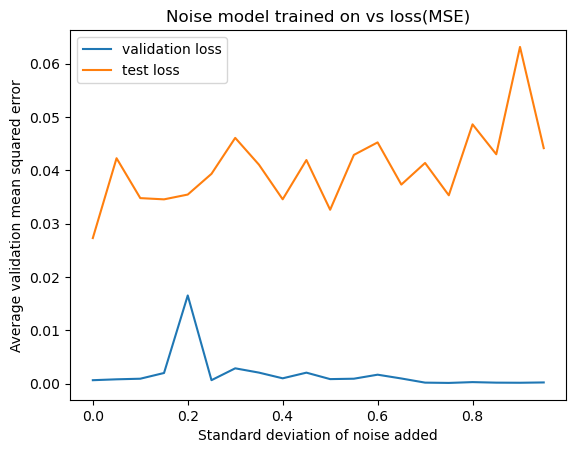

In [43]:
plt.plot(noise_range,final_val_loss, label = 'validation loss')
plt.plot(noise_range,test_loss, label = 'test loss')
plt.xlabel("Standard deviation of noise added")
plt.ylabel("Average validation mean squared error")
plt.title("Noise model trained on vs loss(MSE)")
plt.legend()
#plt.savefig("Noise tests 0-1.5 one map.png")

# 5. USING OPTUNA TO TUNE HYPERPARAMETERS

## TEST 1 : Predicting parameters from a single map

### Running the hyperparameter tuning

In [242]:
import optuna

In [246]:
# Define the Optuna objective function
def objective(trial):

    # Define hyperparameter search space
    filters_1 = trial.suggest_categorical('filters_1', [16, 32, 64])
    filters_2 = trial.suggest_categorical('filters_2', [32, 64, 128])
    filters_3 = trial.suggest_categorical('filters_3', [64, 128, 256])
    filters_4 = trial.suggest_categorical('filters_4', [64,128,256])
    
    strides = trial.suggest_categorical('strides', [1, 2])
    
    batch_size = trial.suggest_int('batch_size',1,16)
    dense_units = trial.suggest_int('dense_units', 4, 32)
    weight_param = trial.suggest_float('weight_param', 0.01,0.015)
    relu_param = trial.suggest_float('relu_param', 0.01,0.05)
    
    
    # Model Architecture
    model = keras.Sequential([
        keras.layers.Input(shape=(256, 256, 1)),
        keras.layers.Conv2D(filters_1, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),
        
        keras.layers.Conv2D(filters_2, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Conv2D(filters_3, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Conv2D(filters_4, 3, padding='valid', strides=strides),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Flatten(),
        keras.layers.Dense(dense_units),
        keras.layers.Dense(6, activation='softplus')
    ])


        # Getting the mean and standard deviation for each parameter
    param_means = np.mean(params, axis=0)
    param_std = np.std(params, axis=0)  

    # Define weights as inverse of standard deviation (rarer values get higher weight)
    weights = weight_param / (param_std + 1e-6)  # Avoid division by zero

    print("Computed Weights:", weights)  # Check the computed values
    
    # Define loss function using computed weights
    def dynamic_weighted_mse(y_true, y_pred):
        weights_tensor = tf.constant(weights, dtype=tf.float32)
        error = tf.square(y_true - y_pred)
        weighted_error = weights_tensor * error
        return tf.reduce_mean(weighted_error)

    model.compile(optimizer='adam', loss=dynamic_weighted_mse, metrics = ['mae', 'mse'])
    
    callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=4 ,restore_best_weights=True)
    lr_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)

    X_train, X_test, y_train, y_test = format_data(MgasMap,params, smooth = False, sigma_smooth = 0, noise = False,
                                                sigma_noise = 0, normalise = True, test_size = 0.20)

    validation_split = 594

    history = model.fit(x=X_train[:validation_split], y=y_train[:validation_split], epochs = 15, validation_data = (
            X_train[validation_split:], y_train[validation_split:]), verbose = False, 
                        callbacks=[callback,lr_callback], batch_size = batch_size)

    # Return validation loss
    return min(history.history['val_mse'])


### **4. Run the Optuna Study**

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=20)  # Adjust n_trials as needed

# Print best hyperparameters
print("Best trial:", study.best_trial.params)


[I 2025-04-02 18:06:50,710] A new study created in memory with name: no-name-e4827976-9649-4f55-b133-7b59d1bcf4e3


Computed Weights: [0.24504805 0.24504805 0.02516322 0.02516322 0.06445719 0.06445719]


[I 2025-04-02 18:07:24,412] Trial 0 finished with value: 0.05630584806203842 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 13, 'dense_units': 31, 'weight_param': 0.012654472159944441, 'relu_param': 0.03610770379921304}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.21276328 0.21276328 0.021848   0.021848   0.05596503 0.05596503]


[I 2025-04-02 18:08:14,440] Trial 1 finished with value: 0.07110496610403061 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 1, 'dense_units': 19, 'weight_param': 0.010987261525050696, 'relu_param': 0.01874635886922986}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.27114734 0.27114734 0.02784328 0.02784328 0.07132231 0.07132231]


[I 2025-04-02 18:11:55,599] Trial 2 finished with value: 0.10067836940288544 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 256, 'filters_4': 128, 'strides': 1, 'batch_size': 12, 'dense_units': 5, 'weight_param': 0.014002259506443682, 'relu_param': 0.040581173562551656}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.19576056 0.19576056 0.02010204 0.02010204 0.05149265 0.05149265]


[I 2025-04-02 18:15:26,694] Trial 3 finished with value: 0.0835597887635231 and parameters: {'filters_1': 16, 'filters_2': 32, 'filters_3': 256, 'filters_4': 256, 'strides': 1, 'batch_size': 7, 'dense_units': 24, 'weight_param': 0.010109227533430703, 'relu_param': 0.03496987681558337}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.28431107 0.28431107 0.02919502 0.02919502 0.07478489 0.07478489]


[I 2025-04-02 18:16:06,617] Trial 4 finished with value: 0.08758500963449478 and parameters: {'filters_1': 16, 'filters_2': 32, 'filters_3': 128, 'filters_4': 64, 'strides': 2, 'batch_size': 1, 'dense_units': 5, 'weight_param': 0.014682045007865486, 'relu_param': 0.043806777854829795}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.28341777 0.28341777 0.02910329 0.02910329 0.07454991 0.07454991]


[I 2025-04-02 18:18:45,428] Trial 5 finished with value: 0.11900680512189865 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 128, 'filters_4': 128, 'strides': 1, 'batch_size': 10, 'dense_units': 13, 'weight_param': 0.014635913960120702, 'relu_param': 0.03263861558135873}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.27915915 0.27915915 0.02866599 0.02866599 0.07342973 0.07342973]


[I 2025-04-02 18:21:45,855] Trial 6 finished with value: 0.06572940945625305 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 64, 'filters_4': 128, 'strides': 1, 'batch_size': 4, 'dense_units': 24, 'weight_param': 0.0144159955331895, 'relu_param': 0.02952209014576793}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.1965252  0.1965252  0.02018056 0.02018056 0.05169378 0.05169378]


[I 2025-04-02 18:27:26,295] Trial 7 finished with value: 0.06649480015039444 and parameters: {'filters_1': 16, 'filters_2': 128, 'filters_3': 256, 'filters_4': 128, 'strides': 1, 'batch_size': 15, 'dense_units': 14, 'weight_param': 0.010148714035907926, 'relu_param': 0.02020107572226374}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.22499329 0.22499329 0.02310386 0.02310386 0.059182   0.059182  ]


[I 2025-04-02 18:30:30,445] Trial 8 finished with value: 0.05897334963083267 and parameters: {'filters_1': 32, 'filters_2': 32, 'filters_3': 64, 'filters_4': 128, 'strides': 1, 'batch_size': 2, 'dense_units': 17, 'weight_param': 0.01161882849950193, 'relu_param': 0.04774411609006887}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.21200586 0.21200586 0.02177022 0.02177022 0.0557658  0.0557658 ]


[I 2025-04-02 18:32:04,911] Trial 9 finished with value: 0.0777076780796051 and parameters: {'filters_1': 16, 'filters_2': 32, 'filters_3': 64, 'filters_4': 64, 'strides': 1, 'batch_size': 4, 'dense_units': 18, 'weight_param': 0.010948147535503694, 'relu_param': 0.025565827833412637}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.25502111 0.25502111 0.02618733 0.02618733 0.06708049 0.06708049]


[I 2025-04-02 18:32:42,039] Trial 10 finished with value: 0.08034567534923553 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 256, 'strides': 2, 'batch_size': 16, 'dense_units': 32, 'weight_param': 0.013169488463662846, 'relu_param': 0.0375533553652885}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.23797411 0.23797411 0.02443682 0.02443682 0.06259646 0.06259646]


[I 2025-04-02 18:33:12,519] Trial 11 finished with value: 0.09931042045354843 and parameters: {'filters_1': 64, 'filters_2': 32, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 12, 'dense_units': 32, 'weight_param': 0.012289168223832815, 'relu_param': 0.04991199611918854}. Best is trial 0 with value: 0.05630584806203842.


Computed Weights: [0.24026239 0.24026239 0.0246718  0.0246718  0.06319837 0.06319837]


[I 2025-04-02 18:33:46,219] Trial 12 finished with value: 0.052856434136629105 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 64, 'filters_4': 128, 'strides': 2, 'batch_size': 7, 'dense_units': 27, 'weight_param': 0.012407336794511599, 'relu_param': 0.04834407086598953}. Best is trial 12 with value: 0.052856434136629105.


Computed Weights: [0.2517433  0.2517433  0.02585074 0.02585074 0.0662183  0.0662183 ]


[I 2025-04-02 18:34:19,594] Trial 13 finished with value: 0.07054975628852844 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 8, 'dense_units': 27, 'weight_param': 0.0130002200370195, 'relu_param': 0.01222868913540261}. Best is trial 12 with value: 0.052856434136629105.


Computed Weights: [0.24024766 0.24024766 0.02467029 0.02467029 0.06319449 0.06319449]


[I 2025-04-02 18:34:53,356] Trial 14 finished with value: 0.0684204027056694 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 64, 'filters_4': 256, 'strides': 2, 'batch_size': 13, 'dense_units': 28, 'weight_param': 0.012406576009196106, 'relu_param': 0.042827835289068646}. Best is trial 12 with value: 0.052856434136629105.


Computed Weights: [0.26015849 0.26015849 0.02671487 0.02671487 0.06843182 0.06843182]


[I 2025-04-02 18:35:28,891] Trial 15 finished with value: 0.047489166259765625 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 128, 'filters_4': 128, 'strides': 2, 'batch_size': 6, 'dense_units': 27, 'weight_param': 0.013434786690143141, 'relu_param': 0.02789298641575117}. Best is trial 15 with value: 0.047489166259765625.


Computed Weights: [0.26353104 0.26353104 0.02706119 0.02706119 0.06931893 0.06931893]


[I 2025-04-02 18:36:04,863] Trial 16 finished with value: 0.08367859572172165 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 128, 'filters_4': 128, 'strides': 2, 'batch_size': 6, 'dense_units': 23, 'weight_param': 0.013608948002003286, 'relu_param': 0.0267382243637639}. Best is trial 15 with value: 0.047489166259765625.


Computed Weights: [0.23242672 0.23242672 0.02386718 0.02386718 0.06113728 0.06113728]


[I 2025-04-02 18:36:50,825] Trial 17 finished with value: 0.055634476244449615 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 128, 'filters_4': 128, 'strides': 2, 'batch_size': 5, 'dense_units': 28, 'weight_param': 0.012002696513566214, 'relu_param': 0.02157485481573045}. Best is trial 15 with value: 0.047489166259765625.


Computed Weights: [0.25994187 0.25994187 0.02669262 0.02669262 0.06837484 0.06837484]


[I 2025-04-02 18:37:25,764] Trial 18 finished with value: 0.08058711886405945 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 128, 'filters_4': 128, 'strides': 2, 'batch_size': 9, 'dense_units': 21, 'weight_param': 0.013423600611821103, 'relu_param': 0.011144399110945873}. Best is trial 15 with value: 0.047489166259765625.


Computed Weights: [0.26949737 0.26949737 0.02767385 0.02767385 0.07088831 0.07088831]


[I 2025-04-02 18:38:00,930] Trial 19 finished with value: 0.09400289505720139 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 128, 'filters_4': 128, 'strides': 2, 'batch_size': 10, 'dense_units': 10, 'weight_param': 0.013917054031715972, 'relu_param': 0.015798188466828764}. Best is trial 15 with value: 0.047489166259765625.


Best trial: {'filters_1': 64, 'filters_2': 64, 'filters_3': 128, 'filters_4': 128, 'strides': 2, 'batch_size': 6, 'dense_units': 27, 'weight_param': 0.013434786690143141, 'relu_param': 0.02789298641575117}


### Running the model with the tuned parameters

In [280]:
def tuned_model_single_map(input_shape):
    
    model = keras.Sequential([
        keras.layers.Input(shape=input_shape),
        keras.layers.Conv2D(64, 3, padding='valid', strides=2),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.03),
        
        keras.layers.Conv2D(64, 3, padding='valid', strides=2),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.03),

        keras.layers.Conv2D(128, 3, padding='valid', strides=2),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.03),

        keras.layers.Conv2D(128, 3, padding='valid', strides=2),
        keras.layers.LeakyReLU(0.03),

        keras.layers.Flatten(),
        keras.layers.Dense(27),
        keras.layers.Dense(6, activation='softplus')
    ])

    return model

In [268]:
tuned_model_single = tuned_model_single_map()

Computed Weights: [0.25173904 0.25173904 0.0258503  0.0258503  0.06621718 0.06621718]
Epoch 1/15
99/99 ━━━━━━━━━━━━━━━━━━━━ 3s 24ms/step - loss: 0.0051 - mae: 0.1626 - mse: 0.1285 - val_loss: 0.0029 - val_mae: 0.1087 - val_mse: 0.0734 - learning_rate: 0.0010
Epoch 2/15
99/99 ━━━━━━━━━━━━━━━━━━━━ 3s 27ms/step - loss: 0.0038 - mae: 0.1343 - mse: 0.1142 - val_loss: 0.0027 - val_mae: 0.1159 - val_mse: 0.0741 - learning_rate: 0.0010
Epoch 3/15
99/99 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - loss: 0.0032 - mae: 0.1183 - mse: 0.0997 - val_loss: 0.0027 - val_mae: 0.1140 - val_mse: 0.0751 - learning_rate: 0.0010
Epoch 4/15
99/99 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - loss: 0.0035 - mae: 0.1265 - mse: 0.1081 - val_loss: 0.0024 - val_mae: 0.1042 - val_mse: 0.0646 - learning_rate: 0.0010
Epoch 5/15
99/99 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - loss: 0.0026 - mae: 0.1108 - mse: 0.0756 - val_loss: 0.0026 - val_mae: 0.1263 - val_mse: 0.0683 - learning_rate: 0.0010
Epoch 6/15
99/99 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/ste

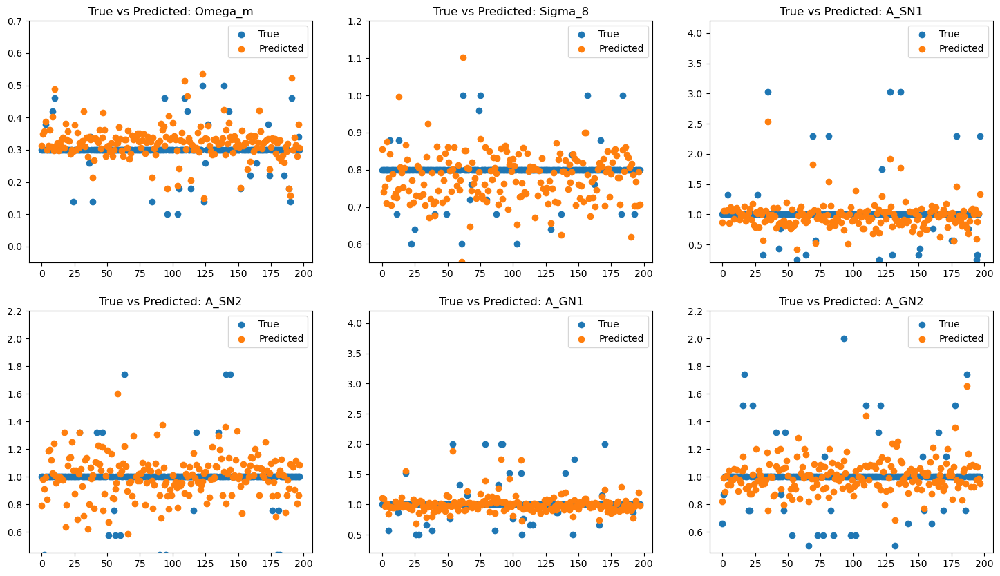

<Figure size 640x480 with 0 Axes>

In [269]:
X_train, X_test, y_train, y_test = format_data(grids = MgasMap ,parameters = params, smooth = False, sigma_smooth = 0, noise = False, 
                sigma_noise = 0, normalise = True, test_size = 0.20)

history = compile_fit_model(tuned_model_single,X_train, y_train, validation_split = 594, epochs = 15,
                            verbose = True, batch_size = 6, weight_param = 0.013)

# Getting and plotting the predictions
predictions = predict(model,X_train[594:])
plot_predictions(predictions, y_train[594:], figure_save = True,image_name = 'tuned model single MgasMap4')

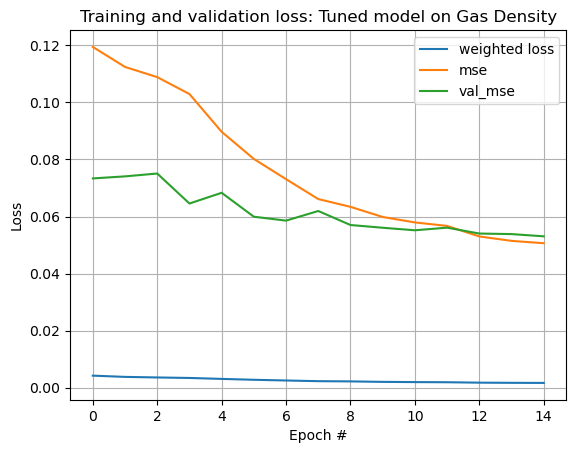

In [274]:
epoch_range = [x for x in range(0,15)]
plt.figure()

plt.plot(epoch_range, history.history["loss"], label="weighted loss")
plt.plot(epoch_range, history.history["mse"], label="mse")
plt.plot(epoch_range, history.history["val_mse"], label="val_mse")
plt.title("Training and validation loss: Tuned model on Gas Density")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.grid()
plt.legend(loc="upper right")
plt.savefig('Train val loss tuned single')

In [277]:
tuned_model_single.evaluate(X_test, y_test)

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0017 - mae: 0.0956 - mse: 0.0485     


[0.0019009539391845465, 0.05353279784321785, 0.09869352728128433]

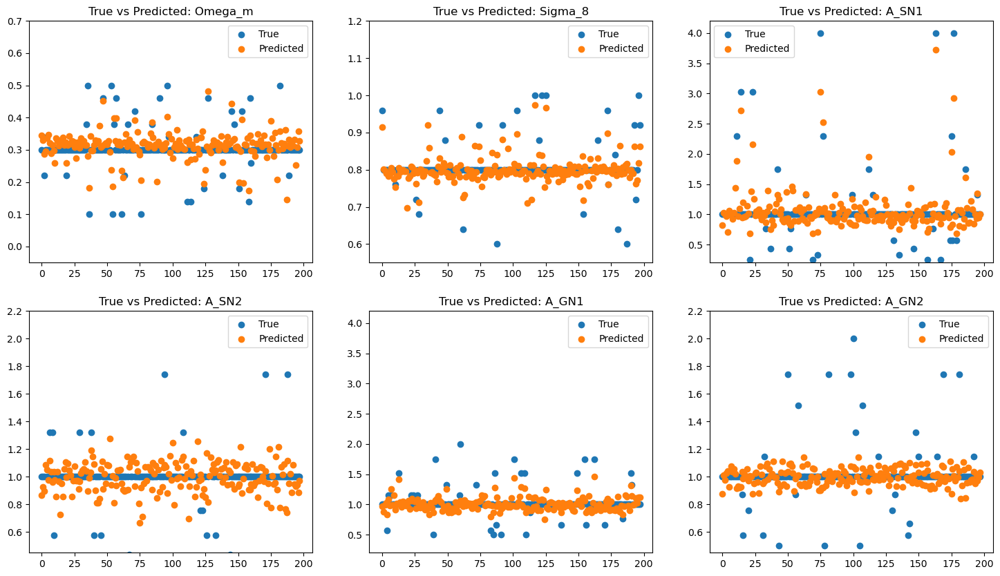

<Figure size 640x480 with 0 Axes>

In [278]:
#predictions_test = predict(tuned_model_single,X_test)
plot_predictions(predictions_test, y_test, figure_save = True,image_name = 'tuned model single test MgasMap4')

### Hyperparameter importance

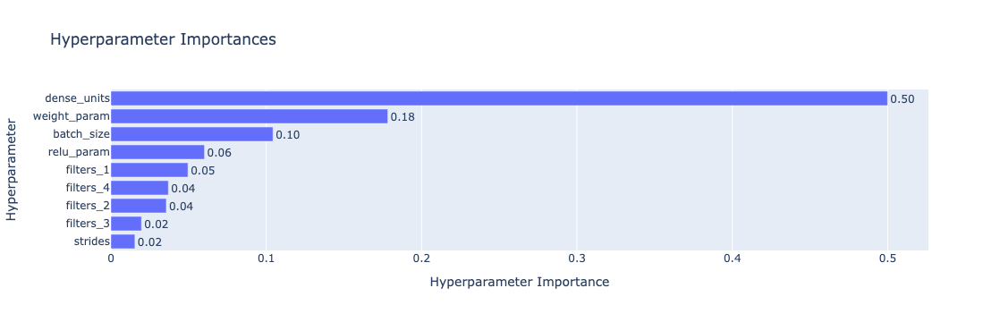

In [279]:
optuna.visualization.plot_param_importances(study)

## TEST 2: Predicting parameters from 4 maps (all gas maps)

### Running the hyperparameter training

In [297]:
# Define the Optuna objective function
def objective2(trial):

    # Define hyperparameter search space
    filters_1 = trial.suggest_categorical('filters_1', [16, 32, 64])
    filters_2 = trial.suggest_categorical('filters_2', [32, 64, 128])
    filters_3 = trial.suggest_categorical('filters_3', [64, 128, 256])
    filters_4 = trial.suggest_categorical('filters_4', [64,128,256])
    
    strides = trial.suggest_categorical('strides', [1, 2])
    
    batch_size = trial.suggest_int('batch_size',1,16)
    dense_units = trial.suggest_int('dense_units', 4, 32)
    weight_param = trial.suggest_float('weight_param', 0.01,0.015)
    relu_param = trial.suggest_float('relu_param', 0.01,0.05)
    
    
    # Model Architecture
    model = keras.Sequential([
        keras.layers.Input(shape=(256, 256, 4)),
        keras.layers.Conv2D(filters_1, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),
        
        keras.layers.Conv2D(filters_2, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Conv2D(filters_3, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Conv2D(filters_4, 3, padding='valid', strides=strides),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Flatten(),
        keras.layers.Dense(dense_units),
        keras.layers.Dense(6, activation='softplus')
    ])


        # Getting the mean and standard deviation for each parameter
    param_means = np.mean(params, axis=0)
    param_std = np.std(params, axis=0)  

    # Define weights as inverse of standard deviation (rarer values get higher weight)
    weights = weight_param / (param_std + 1e-6)  # Avoid division by zero

    print("Computed Weights:", weights)  # Check the computed values
    
    # Define loss function using computed weights
    def dynamic_weighted_mse(y_true, y_pred):
        weights_tensor = tf.constant(weights, dtype=tf.float32)
        error = tf.square(y_true - y_pred)
        weighted_error = weights_tensor * error
        return tf.reduce_mean(weighted_error)

    model.compile(optimizer='adam', loss=dynamic_weighted_mse, metrics = ['mae', 'mse'])
    
    callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=4 ,restore_best_weights=True)
    lr_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)

    X_train, X_test, y_train, y_test = format_data(GasMap,params, smooth = False, sigma_smooth = 0, noise = False,
                                                sigma_noise = 0, normalise = True, test_size = 0.20)

    validation_split = 594

    history = model.fit(x=X_train[:validation_split], y=y_train[:validation_split], epochs = 15, validation_data = (
            X_train[validation_split:], y_train[validation_split:]), verbose = False, 
                        callbacks=[callback,lr_callback], batch_size = batch_size)

    # Return validation loss
    return min(history.history['val_mse'])


### **4. Run the Optuna Study**

study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=20)  # Adjust n_trials as needed

# Print best hyperparameters
print("Best trial:", study.best_trial.params)


[I 2025-04-02 21:11:25,486] A new study created in memory with name: no-name-ddaf1bc9-f0c0-4098-b39d-7f459bbab537


Computed Weights: [0.27564386 0.27564386 0.02830501 0.02830501 0.07250507 0.07250507]


[I 2025-04-02 21:15:28,875] Trial 0 finished with value: 0.06937167793512344 and parameters: {'filters_1': 16, 'filters_2': 128, 'filters_3': 128, 'filters_4': 128, 'strides': 1, 'batch_size': 8, 'dense_units': 29, 'weight_param': 0.014234463488695934, 'relu_param': 0.03837726854695808}. Best is trial 0 with value: 0.06937167793512344.


Computed Weights: [0.21503289 0.21503289 0.02208106 0.02208106 0.05656203 0.05656203]


[I 2025-04-02 21:15:50,565] Trial 1 finished with value: 0.05896197259426117 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 256, 'filters_4': 256, 'strides': 2, 'batch_size': 4, 'dense_units': 5, 'weight_param': 0.011104465671917859, 'relu_param': 0.021291751178882216}. Best is trial 1 with value: 0.05896197259426117.


Computed Weights: [0.20134558 0.20134558 0.02067555 0.02067555 0.05296173 0.05296173]


[I 2025-04-02 21:18:08,362] Trial 2 finished with value: 0.08470368385314941 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 64, 'filters_4': 256, 'strides': 1, 'batch_size': 14, 'dense_units': 27, 'weight_param': 0.010397642217520008, 'relu_param': 0.03372555577023556}. Best is trial 1 with value: 0.05896197259426117.


Computed Weights: [0.21773515 0.21773515 0.02235855 0.02235855 0.05727283 0.05727283]


[I 2025-04-02 21:21:02,738] Trial 3 finished with value: 0.104380302131176 and parameters: {'filters_1': 32, 'filters_2': 32, 'filters_3': 128, 'filters_4': 256, 'strides': 1, 'batch_size': 13, 'dense_units': 30, 'weight_param': 0.011244012426572463, 'relu_param': 0.010373960608813224}. Best is trial 1 with value: 0.05896197259426117.


Computed Weights: [0.28665784 0.28665784 0.029436   0.029436   0.07540218 0.07540218]


[I 2025-04-02 21:23:24,811] Trial 4 finished with value: 0.07778437435626984 and parameters: {'filters_1': 32, 'filters_2': 32, 'filters_3': 128, 'filters_4': 64, 'strides': 1, 'batch_size': 6, 'dense_units': 11, 'weight_param': 0.014803233743010125, 'relu_param': 0.04843124748352117}. Best is trial 1 with value: 0.05896197259426117.


Computed Weights: [0.20182251 0.20182251 0.02072453 0.02072453 0.05308718 0.05308718]


[I 2025-04-02 21:26:35,725] Trial 5 finished with value: 0.7862917184829712 and parameters: {'filters_1': 32, 'filters_2': 128, 'filters_3': 256, 'filters_4': 128, 'strides': 1, 'batch_size': 16, 'dense_units': 11, 'weight_param': 0.010422271378270436, 'relu_param': 0.03119921264392378}. Best is trial 1 with value: 0.05896197259426117.


Computed Weights: [0.20707068 0.20707068 0.02126345 0.02126345 0.05446766 0.05446766]


[I 2025-04-02 21:30:34,470] Trial 6 finished with value: 0.047375667840242386 and parameters: {'filters_1': 32, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 1, 'batch_size': 16, 'dense_units': 14, 'weight_param': 0.010693290908705924, 'relu_param': 0.03825410935071033}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.25497476 0.25497476 0.02618257 0.02618257 0.0670683  0.0670683 ]


[I 2025-04-02 21:31:02,643] Trial 7 finished with value: 0.1263711154460907 and parameters: {'filters_1': 64, 'filters_2': 32, 'filters_3': 128, 'filters_4': 128, 'strides': 2, 'batch_size': 14, 'dense_units': 23, 'weight_param': 0.013167095215352921, 'relu_param': 0.029106788026561504}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.19804802 0.19804802 0.02033694 0.02033694 0.05209435 0.05209435]


[I 2025-04-02 21:32:51,262] Trial 8 finished with value: 0.9522234201431274 and parameters: {'filters_1': 32, 'filters_2': 128, 'filters_3': 128, 'filters_4': 256, 'strides': 1, 'batch_size': 16, 'dense_units': 26, 'weight_param': 0.010227353914674142, 'relu_param': 0.047626069760603545}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.26168372 0.26168372 0.02687149 0.02687149 0.06883301 0.06883301]


[I 2025-04-02 21:34:55,706] Trial 9 finished with value: 0.094447061419487 and parameters: {'filters_1': 32, 'filters_2': 32, 'filters_3': 64, 'filters_4': 128, 'strides': 1, 'batch_size': 8, 'dense_units': 7, 'weight_param': 0.013513550867972138, 'relu_param': 0.011764445291982022}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.23521251 0.23521251 0.02415324 0.02415324 0.06187005 0.06187005]


[I 2025-04-02 21:35:53,087] Trial 10 finished with value: 0.053906749933958054 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 2, 'dense_units': 18, 'weight_param': 0.012146556972132835, 'relu_param': 0.04101237048858065}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.23222089 0.23222089 0.02384604 0.02384604 0.06108314 0.06108314]


[I 2025-04-02 21:37:17,621] Trial 11 finished with value: 0.07288982719182968 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 1, 'dense_units': 18, 'weight_param': 0.011992067202406344, 'relu_param': 0.04036494136640174}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.23710823 0.23710823 0.02434791 0.02434791 0.0623687  0.0623687 ]


[I 2025-04-02 21:37:58,650] Trial 12 finished with value: 0.08457497507333755 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 11, 'dense_units': 18, 'weight_param': 0.01224445329614476, 'relu_param': 0.041603540829349195}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.24970476 0.24970476 0.02564141 0.02564141 0.06568208 0.06568208]


[I 2025-04-02 21:39:25,066] Trial 13 finished with value: 0.08132599294185638 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 1, 'dense_units': 13, 'weight_param': 0.012894947905099716, 'relu_param': 0.02376844542564867}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.22577032 0.22577032 0.02318365 0.02318365 0.05938639 0.05938639]


[I 2025-04-02 21:40:10,633] Trial 14 finished with value: 0.08452855795621872 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 4, 'dense_units': 22, 'weight_param': 0.011658954873198948, 'relu_param': 0.04319711876733209}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.2156101  0.2156101  0.02214033 0.02214033 0.05671386 0.05671386]


[I 2025-04-02 21:40:35,473] Trial 15 finished with value: 0.09117347002029419 and parameters: {'filters_1': 32, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 11, 'dense_units': 15, 'weight_param': 0.011134273173227242, 'relu_param': 0.0363453860889041}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.24074019 0.24074019 0.02472086 0.02472086 0.06332405 0.06332405]


[I 2025-04-02 21:46:26,476] Trial 16 finished with value: 0.07241790741682053 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 256, 'filters_4': 64, 'strides': 1, 'batch_size': 4, 'dense_units': 21, 'weight_param': 0.01243201090939292, 'relu_param': 0.02689210190281072}. Best is trial 6 with value: 0.047375667840242386.


Computed Weights: [0.22186775 0.22186775 0.02278291 0.02278291 0.05835986 0.05835986]


[I 2025-04-02 21:47:10,239] Trial 17 finished with value: 0.046629972755908966 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 10, 'dense_units': 15, 'weight_param': 0.011457423285196461, 'relu_param': 0.04515059757571687}. Best is trial 17 with value: 0.046629972755908966.


Computed Weights: [0.21120118 0.21120118 0.02168759 0.02168759 0.05555414 0.05555414]


[I 2025-04-02 21:47:34,494] Trial 18 finished with value: 0.08497162908315659 and parameters: {'filters_1': 32, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 11, 'dense_units': 8, 'weight_param': 0.010906593352624361, 'relu_param': 0.04532999463661003}. Best is trial 17 with value: 0.046629972755908966.


Computed Weights: [0.20539099 0.20539099 0.02109096 0.02109096 0.05402583 0.05402583]


[I 2025-04-02 21:49:34,265] Trial 19 finished with value: 0.07345812022686005 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 64, 'filters_4': 64, 'strides': 1, 'batch_size': 9, 'dense_units': 15, 'weight_param': 0.010606550390466242, 'relu_param': 0.035390059595821664}. Best is trial 17 with value: 0.046629972755908966.


Best trial: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 2, 'batch_size': 10, 'dense_units': 15, 'weight_param': 0.011457423285196461, 'relu_param': 0.04515059757571687}


### Running the tuned model

In [300]:
def create_tuned_model_Gasmap(input_shape):
    
    model = keras.Sequential([
        keras.layers.Input(shape=input_shape),
        keras.layers.Conv2D(64, 3, padding='valid', strides=2),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.045),
        
        keras.layers.Conv2D(128, 3, padding='valid', strides=2),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.045),

        keras.layers.Conv2D(64, 3, padding='valid', strides=2),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.045),

        keras.layers.Conv2D(64, 3, padding='valid', strides=2),
        keras.layers.LeakyReLU(0.045),

        keras.layers.Flatten(),
        keras.layers.Dense(15),
        keras.layers.Dense(6, activation='softplus')
    ])

    return model

In [306]:
tuned_model_GasMap = create_tuned_model_Gasmap(input_shape = (256,256,4))

Computed Weights: [0.22269223 0.22269223 0.02286757 0.02286757 0.05857673 0.05857673]
Epoch 1/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 56ms/step - loss: 0.0055 - mae: 0.2062 - mse: 0.1468 - val_loss: 0.0032 - val_mae: 0.1122 - val_mse: 0.1087 - learning_rate: 0.0010
Epoch 2/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 3s 50ms/step - loss: 0.0030 - mae: 0.1167 - mse: 0.0992 - val_loss: 0.0031 - val_mae: 0.1155 - val_mse: 0.1070 - learning_rate: 0.0010
Epoch 3/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 3s 51ms/step - loss: 0.0028 - mae: 0.1211 - mse: 0.0943 - val_loss: 0.0029 - val_mae: 0.1204 - val_mse: 0.0990 - learning_rate: 0.0010
Epoch 4/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 3s 50ms/step - loss: 0.0023 - mae: 0.1151 - mse: 0.0739 - val_loss: 0.0029 - val_mae: 0.1287 - val_mse: 0.0954 - learning_rate: 0.0010
Epoch 5/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 3s 51ms/step - loss: 0.0023 - mae: 0.1207 - mse: 0.0766 - val_loss: 0.0026 - val_mae: 0.1095 - val_mse: 0.0859 - learning_rate: 0.0010
Epoch 6/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 3s 50ms/ste

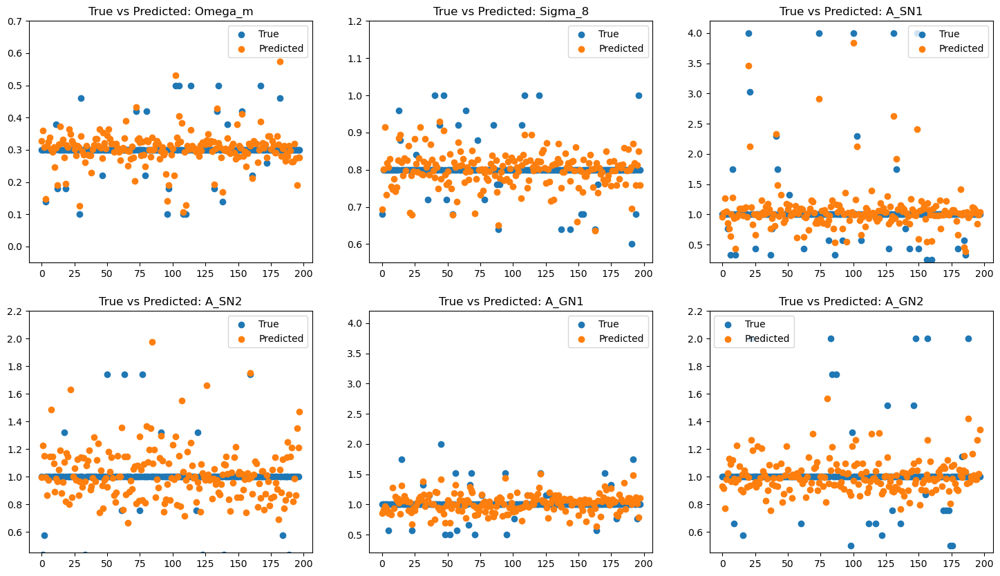

In [307]:
X_train1, X_test1, y_train1, y_test1 = format_data(grids = GasMap ,parameters = params, smooth = False, sigma_smooth = 0, noise = False, 
                sigma_noise = 0, normalise = True, test_size = 0.20)

history1 = compile_fit_model(tuned_model_GasMap,X_train1, y_train1, validation_split = 594, epochs = 20,
                            verbose = True, batch_size = 10, weight_param = 0.0115)

# Getting and plotting the predictions
predictions1 = predict(tuned_model_GasMap,X_train1[594:])
plot_predictions(predictions1, y_train1[594:], figure_save = False,image_name = 'tuned model single MgasMap4')

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step 


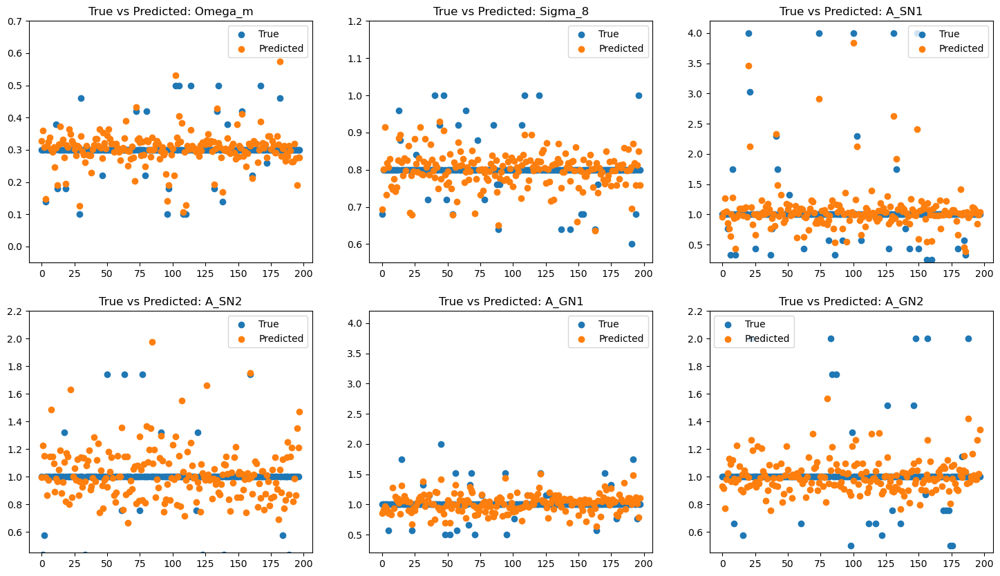

In [310]:
# Getting and plotting the predictions
test_predictions1 = predict(tuned_model_GasMap,X_train1[594:])
plot_predictions(test_predictions1, y_train1[594:], figure_save = False,image_name = 'tuned model single MgasMap4')

## TEST 3: Predicting from all maps

### Running the hyperparmeter training

In [312]:
# Define the Optuna objective function
def objective3(trial):

    # Define hyperparameter search space
    filters_1 = trial.suggest_categorical('filters_1', [16, 32, 64])
    filters_2 = trial.suggest_categorical('filters_2', [32, 64, 128])
    filters_3 = trial.suggest_categorical('filters_3', [64, 128, 256])
    filters_4 = trial.suggest_categorical('filters_4', [64,128,256])
    
    strides = trial.suggest_categorical('strides', [1, 2])
    
    batch_size = trial.suggest_int('batch_size',1,16)
    dense_units = trial.suggest_int('dense_units', 4, 32)
    weight_param = trial.suggest_float('weight_param', 0.01,0.015)
    relu_param = trial.suggest_float('relu_param', 0.01,0.05)
    
    
    # Model Architecture
    model = keras.Sequential([
        keras.layers.Input(shape=(256, 256, 11)),
        keras.layers.Conv2D(filters_1, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),
        
        keras.layers.Conv2D(filters_2, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Conv2D(filters_3, 3, padding='valid', strides=strides),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Conv2D(filters_4, 3, padding='valid', strides=strides),
        keras.layers.LeakyReLU(relu_param),

        keras.layers.Flatten(),
        keras.layers.Dense(dense_units),
        keras.layers.Dense(6, activation='softplus')
    ])


        # Getting the mean and standard deviation for each parameter
    param_means = np.mean(params, axis=0)
    param_std = np.std(params, axis=0)  

    # Define weights as inverse of standard deviation (rarer values get higher weight)
    weights = weight_param / (param_std + 1e-6)  # Avoid division by zero

    print("Computed Weights:", weights)  # Check the computed values
    
    # Define loss function using computed weights
    def dynamic_weighted_mse(y_true, y_pred):
        weights_tensor = tf.constant(weights, dtype=tf.float32)
        error = tf.square(y_true - y_pred)
        weighted_error = weights_tensor * error
        return tf.reduce_mean(weighted_error)

    model.compile(optimizer='adam', loss=dynamic_weighted_mse, metrics = ['mae', 'mse'])
    
    callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=4 ,restore_best_weights=True)
    lr_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)

    X_train, X_test, y_train, y_test = format_data(combined_array,params, smooth = False, sigma_smooth = 0, noise = False,
                                                sigma_noise = 0, normalise = True, test_size = 0.20)

    validation_split = 594

    history = model.fit(x=X_train[:validation_split], y=y_train[:validation_split], epochs = 15, validation_data = (
            X_train[validation_split:], y_train[validation_split:]), verbose = False, 
                        callbacks=[callback,lr_callback], batch_size = batch_size)

    # Return validation loss
    return min(history.history['val_mse'])




study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=20)  

# Print best hyperparameters
print("Best trial:", study.best_trial.params)


[I 2025-04-02 22:55:50,952] A new study created in memory with name: no-name-a953a276-e8d1-451a-ad7d-28c28e304bc9


Computed Weights: [0.21516306 0.21516306 0.02209443 0.02209443 0.05659627 0.05659627]


[I 2025-04-02 22:56:21,435] Trial 0 finished with value: 0.07080405950546265 and parameters: {'filters_1': 64, 'filters_2': 32, 'filters_3': 128, 'filters_4': 64, 'strides': 2, 'batch_size': 11, 'dense_units': 7, 'weight_param': 0.011111187783893837, 'relu_param': 0.021599461270202576}. Best is trial 0 with value: 0.07080405950546265.


Computed Weights: [0.21259727 0.21259727 0.02183095 0.02183095 0.05592137 0.05592137]


[I 2025-04-02 22:58:48,799] Trial 1 finished with value: 0.10952302813529968 and parameters: {'filters_1': 64, 'filters_2': 32, 'filters_3': 128, 'filters_4': 128, 'strides': 1, 'batch_size': 16, 'dense_units': 14, 'weight_param': 0.010978688516923598, 'relu_param': 0.04668496793481252}. Best is trial 0 with value: 0.07080405950546265.


Computed Weights: [0.19625397 0.19625397 0.02015271 0.02015271 0.05162244 0.05162244]


[I 2025-04-02 23:05:43,768] Trial 2 finished with value: 0.07616612315177917 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 256, 'strides': 1, 'batch_size': 8, 'dense_units': 26, 'weight_param': 0.010134707908744989, 'relu_param': 0.017588620122214012}. Best is trial 0 with value: 0.07080405950546265.


Computed Weights: [0.26390264 0.26390264 0.02709934 0.02709934 0.06941668 0.06941668]


[I 2025-04-02 23:13:05,130] Trial 3 finished with value: 0.056153640151023865 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 256, 'filters_4': 128, 'strides': 1, 'batch_size': 2, 'dense_units': 27, 'weight_param': 0.013628137614720724, 'relu_param': 0.025257370715491535}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.22957904 0.22957904 0.02357476 0.02357476 0.06038823 0.06038823]


[I 2025-04-02 23:14:16,753] Trial 4 finished with value: 0.08520369231700897 and parameters: {'filters_1': 32, 'filters_2': 128, 'filters_3': 256, 'filters_4': 256, 'strides': 2, 'batch_size': 1, 'dense_units': 26, 'weight_param': 0.011855640085164395, 'relu_param': 0.014953331177434857}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.23274674 0.23274674 0.02390004 0.02390004 0.06122146 0.06122146]


[I 2025-04-02 23:19:13,961] Trial 5 finished with value: 0.06762940436601639 and parameters: {'filters_1': 64, 'filters_2': 32, 'filters_3': 128, 'filters_4': 128, 'strides': 1, 'batch_size': 2, 'dense_units': 18, 'weight_param': 0.012019222640212011, 'relu_param': 0.02604037708115861}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.21505466 0.21505466 0.0220833  0.0220833  0.05656776 0.05656776]


[I 2025-04-02 23:20:36,221] Trial 6 finished with value: 0.7435094118118286 and parameters: {'filters_1': 16, 'filters_2': 128, 'filters_3': 64, 'filters_4': 256, 'strides': 1, 'batch_size': 15, 'dense_units': 30, 'weight_param': 0.011105590145691993, 'relu_param': 0.02369357530978144}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.25468779 0.25468779 0.0261531  0.0261531  0.06699281 0.06699281]


[I 2025-04-02 23:27:17,656] Trial 7 finished with value: 0.7530787587165833 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 256, 'filters_4': 256, 'strides': 1, 'batch_size': 15, 'dense_units': 12, 'weight_param': 0.01315227565545143, 'relu_param': 0.04092480087477235}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.23213905 0.23213905 0.02383764 0.02383764 0.06106161 0.06106161]


[I 2025-04-02 23:27:53,433] Trial 8 finished with value: 0.05891536921262741 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 256, 'filters_4': 256, 'strides': 2, 'batch_size': 4, 'dense_units': 25, 'weight_param': 0.011987840894012867, 'relu_param': 0.03210345153187664}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.21978964 0.21978964 0.02256952 0.02256952 0.05781324 0.05781324]


[I 2025-04-02 23:28:12,824] Trial 9 finished with value: 0.08486393094062805 and parameters: {'filters_1': 16, 'filters_2': 32, 'filters_3': 128, 'filters_4': 64, 'strides': 2, 'batch_size': 15, 'dense_units': 19, 'weight_param': 0.011350108238036123, 'relu_param': 0.0220689700238564}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.29022828 0.29022828 0.02980264 0.02980264 0.07634135 0.07634135]


[I 2025-04-02 23:39:59,994] Trial 10 finished with value: 0.08201158791780472 and parameters: {'filters_1': 64, 'filters_2': 64, 'filters_3': 256, 'filters_4': 128, 'strides': 1, 'batch_size': 6, 'dense_units': 32, 'weight_param': 0.014987614333268458, 'relu_param': 0.034662497332351785}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.25759114 0.25759114 0.02645124 0.02645124 0.06775651 0.06775651]


[I 2025-04-02 23:40:32,989] Trial 11 finished with value: 0.09809280186891556 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 256, 'filters_4': 128, 'strides': 2, 'batch_size': 4, 'dense_units': 24, 'weight_param': 0.013302207005091111, 'relu_param': 0.032749757068412995}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.27535986 0.27535986 0.02827585 0.02827585 0.07243037 0.07243037]


[I 2025-04-02 23:41:19,094] Trial 12 finished with value: 0.05908665060997009 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 256, 'filters_4': 256, 'strides': 2, 'batch_size': 5, 'dense_units': 22, 'weight_param': 0.014219797452947137, 'relu_param': 0.010212532764740219}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.25424947 0.25424947 0.02610809 0.02610809 0.06687752 0.06687752]


[I 2025-04-02 23:42:04,016] Trial 13 finished with value: 0.09036175906658173 and parameters: {'filters_1': 16, 'filters_2': 64, 'filters_3': 256, 'filters_4': 128, 'strides': 2, 'batch_size': 2, 'dense_units': 29, 'weight_param': 0.013129640325335262, 'relu_param': 0.03724677099068367}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.2711155  0.2711155  0.02784001 0.02784001 0.07131394 0.07131394]


[I 2025-04-02 23:49:01,734] Trial 14 finished with value: 0.05650490149855614 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 256, 'filters_4': 64, 'strides': 1, 'batch_size': 8, 'dense_units': 21, 'weight_param': 0.014000615142977473, 'relu_param': 0.02868872334244523}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.27334736 0.27334736 0.02806919 0.02806919 0.07190101 0.07190101]


[I 2025-04-02 23:57:09,544] Trial 15 finished with value: 0.08614784479141235 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 256, 'filters_4': 64, 'strides': 1, 'batch_size': 9, 'dense_units': 20, 'weight_param': 0.01411587031414246, 'relu_param': 0.027668619702519534}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.2710796  0.2710796  0.02783632 0.02783632 0.0713045  0.0713045 ]


[I 2025-04-03 00:02:11,334] Trial 16 finished with value: 0.07034606486558914 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 64, 'filters_4': 64, 'strides': 1, 'batch_size': 12, 'dense_units': 15, 'weight_param': 0.013998761265500818, 'relu_param': 0.03950112926644362}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.28798192 0.28798192 0.02957197 0.02957197 0.07575046 0.07575046]


[I 2025-04-03 00:10:08,277] Trial 17 finished with value: 0.09627102315425873 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 256, 'filters_4': 64, 'strides': 1, 'batch_size': 7, 'dense_units': 4, 'weight_param': 0.014871610365502224, 'relu_param': 0.029025425927605535}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.26420364 0.26420364 0.02713025 0.02713025 0.06949585 0.06949585]


[I 2025-04-03 00:19:00,760] Trial 18 finished with value: 0.06360763311386108 and parameters: {'filters_1': 32, 'filters_2': 64, 'filters_3': 256, 'filters_4': 128, 'strides': 1, 'batch_size': 10, 'dense_units': 22, 'weight_param': 0.013643681656491333, 'relu_param': 0.018089402485523733}. Best is trial 3 with value: 0.056153640151023865.


Computed Weights: [0.24895268 0.24895268 0.02556418 0.02556418 0.06548425 0.06548425]


[I 2025-04-03 00:31:18,283] Trial 19 finished with value: 0.10163749009370804 and parameters: {'filters_1': 64, 'filters_2': 128, 'filters_3': 64, 'filters_4': 64, 'strides': 1, 'batch_size': 13, 'dense_units': 29, 'weight_param': 0.01285610992938189, 'relu_param': 0.044646968325308296}. Best is trial 3 with value: 0.056153640151023865.


Best trial: {'filters_1': 64, 'filters_2': 64, 'filters_3': 256, 'filters_4': 128, 'strides': 1, 'batch_size': 2, 'dense_units': 27, 'weight_param': 0.013628137614720724, 'relu_param': 0.025257370715491535}


### Running the tuned model

In [315]:
def create_tuned_model_allmaps(input_shape):
    
    model = keras.Sequential([
        keras.layers.Input(shape=input_shape),
        keras.layers.Conv2D(64, 3, padding='valid', strides=1),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.025),
        
        keras.layers.Conv2D(64, 3, padding='valid', strides=1),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.025),

        keras.layers.Conv2D(256, 3, padding='valid', strides=1),
        keras.layers.MaxPooling2D(),
        keras.layers.LeakyReLU(0.025),

        keras.layers.Conv2D(128, 3, padding='valid', strides=1),
        keras.layers.LeakyReLU(0.025),

        keras.layers.Flatten(),
        keras.layers.Dense(27),
        keras.layers.Dense(6, activation='softplus')
    ])

    return model

In [317]:
tuned_model_all_maps = create_tuned_model_allmaps(input_shape = (256,256,11))

Computed Weights: [0.22269223 0.22269223 0.02286757 0.02286757 0.05857673 0.05857673]
Epoch 1/20
297/297 ━━━━━━━━━━━━━━━━━━━━ 76s 242ms/step - loss: 0.5039 - mae: 0.5667 - mse: 8.0727 - val_loss: 0.0031 - val_mae: 0.1255 - val_mse: 0.1012 - learning_rate: 0.0010
Epoch 2/20
297/297 ━━━━━━━━━━━━━━━━━━━━ 68s 229ms/step - loss: 0.0027 - mae: 0.1200 - mse: 0.0893 - val_loss: 0.0028 - val_mae: 0.1142 - val_mse: 0.0921 - learning_rate: 0.0010
Epoch 3/20
297/297 ━━━━━━━━━━━━━━━━━━━━ 67s 226ms/step - loss: 0.0025 - mae: 0.1182 - mse: 0.0799 - val_loss: 0.0026 - val_mae: 0.1252 - val_mse: 0.0806 - learning_rate: 0.0010
Epoch 4/20
297/297 ━━━━━━━━━━━━━━━━━━━━ 68s 228ms/step - loss: 0.0022 - mae: 0.1169 - mse: 0.0716 - val_loss: 0.0026 - val_mae: 0.1369 - val_mse: 0.0853 - learning_rate: 0.0010
Epoch 5/20
297/297 ━━━━━━━━━━━━━━━━━━━━ 69s 231ms/step - loss: 0.0019 - mae: 0.1166 - mse: 0.0603 - val_loss: 0.0024 - val_mae: 0.1184 - val_mse: 0.0782 - learning_rate: 0.0010
Epoch 6/20
297/297 ━━━━━━━━━━

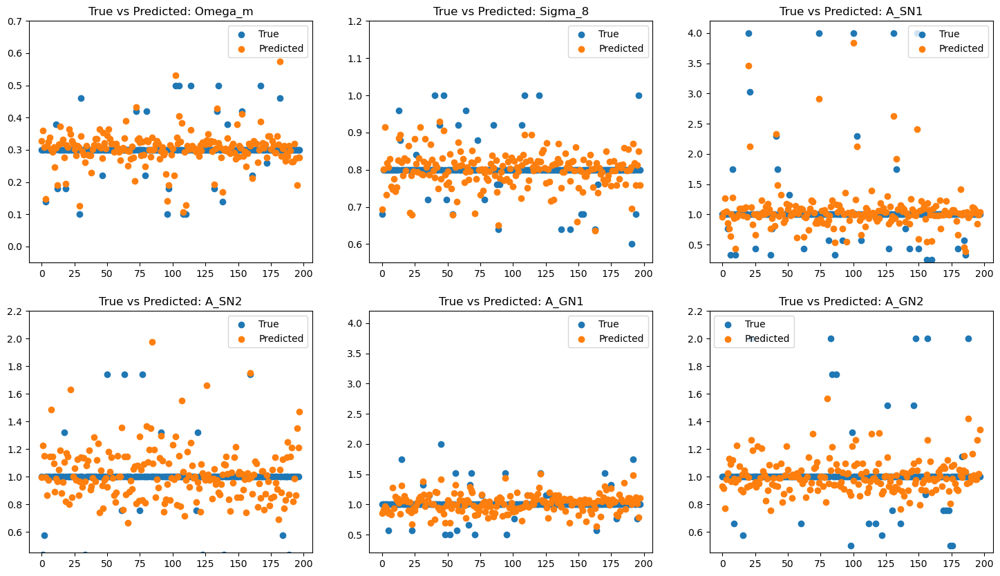

In [318]:
X_train3, X_test3, y_train3, y_test3 = format_data(grids = combined_array ,parameters = params, smooth = False, sigma_smooth = 0, noise = False, 
                sigma_noise = 0, normalise = True, test_size = 0.20)

history1 = compile_fit_model(tuned_model_all_maps,X_train3, y_train3, validation_split = 594, epochs = 20,
                            verbose = True, batch_size = 2, weight_param = 0.0115)

# Getting and plotting the predictions
predictions1 = predict(tuned_model_GasMap,X_train1[594:])
plot_predictions(predictions1, y_train1[594:], figure_save = False,image_name = 'tuned model single MgasMap4')

7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 793ms/step


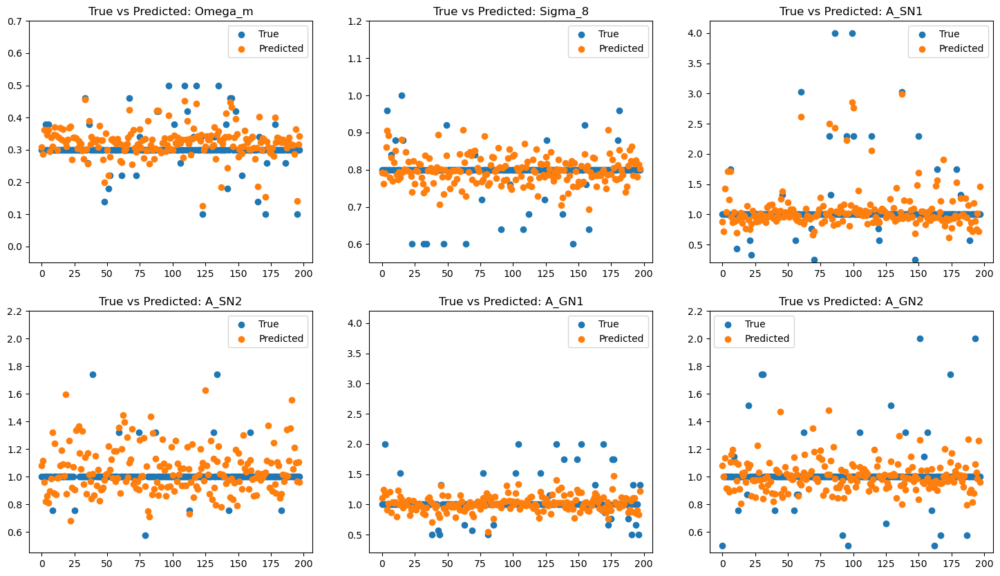

In [320]:
predictions3 = predict(tuned_model_all_maps,X_train3[594:])
plot_predictions(predictions3, y_train3[594:], figure_save = False,image_name = 'tuned model single MgasMap4')

In [328]:
loss = tuned_model_all_maps.evaluate(X_test3,y_test3)

7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 807ms/step - loss: 0.0027 - mae: 0.1229 - mse: 0.0896


In [329]:
loss

[0.002522137714549899, 0.08369821310043335, 0.12445846945047379]

7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 809ms/step


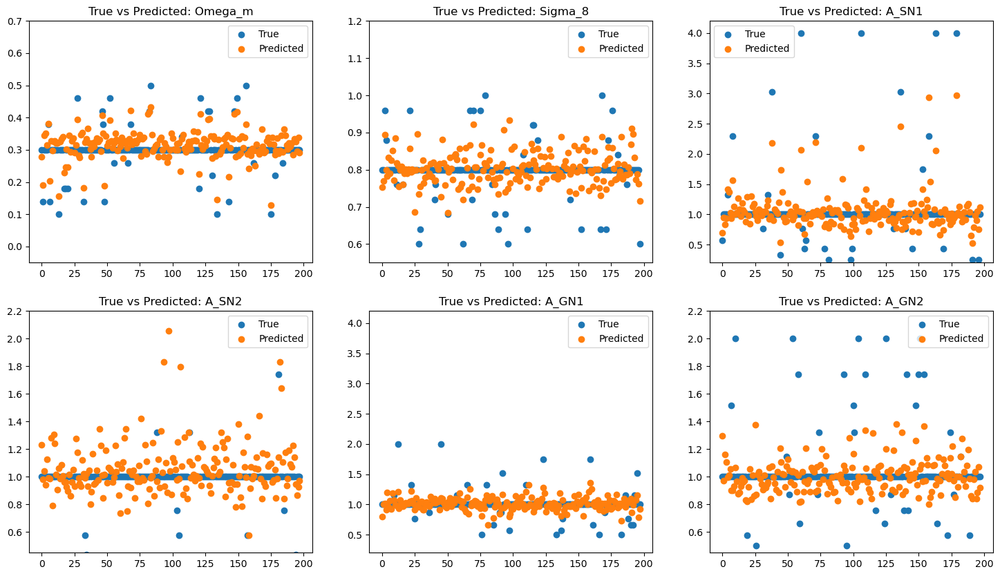

In [327]:
test_predictions3 = predict(tuned_model_all_maps,X_test3)
plot_predictions(test_predictions3, y_test3, figure_save = True,image_name = 'test predictions all maps')

# 6. NOT IN REPORT (SHAP values and importance of each field on predicting each parameter)

In [44]:
import shap

Let's train our model, and then use SHAP values to look at the importance of each feature. 

In [101]:
model = create_modelA(input_shape = (256,256,11))

X_train, X_test, y_train, y_test = format_data(grids = combined_array,parameters = params, smooth = False, sigma_smooth = 0, noise = False,
                                                sigma_noise = 0, normalise = True, test_size = 0.2)

history = compile_fit_model(model,X_train = X_train, y_train = y_train,validation_split = 594, epochs = 15, verbose = True)


Computed Weights: [0.19364542 0.19364542 0.01988485 0.01988485 0.05093629 0.05093629]
Epoch 1/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 11s 16ms/step - loss: 0.0038 - val_loss: 0.0022 - learning_rate: 0.0010
Epoch 2/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 0.0033 - val_loss: 0.0020 - learning_rate: 0.0010
Epoch 3/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 0.0032 - val_loss: 0.0021 - learning_rate: 0.0010
Epoch 4/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 14ms/step - loss: 0.0021 - val_loss: 0.0020 - learning_rate: 0.0010
Epoch 5/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 0.0014 - val_loss: 0.0017 - learning_rate: 5.0000e-04
Epoch 6/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - loss: 5.9670e-04 - val_loss: 0.0020 - learning_rate: 5.0000e-04
Epoch 7/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - loss: 5.1463e-04 - val_loss: 0.0019 - learning_rate: 5.0000e-04
Epoch 8/15
594/594 ━━━━━━━━━━━━━━━━━━━━ 8s 13ms/step - loss: 3.5433e-04 - val_loss: 0.0017 - learning_rate: 2.5000e-

In [102]:
model.evaluate(X_test,y_test)

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.0015 


0.0014284439384937286

In [103]:
n_background = 200  # Use 100 images for SHAP background data
background_indices = np.random.choice(X_train.shape[0], n_background, replace=False)
background_data = X_train[background_indices]  # Shape: (100, 256, 256, 11)

# Select test images to explain
n_test = 100 # Use 50 images for SHAP analysis
test_indices = np.random.choice(X_test.shape[0], n_test, replace=False)
test_data = X_test[test_indices]  # Shape: (50, 256, 256, 11)

print(background_data.shape)
print(test_data.shape)

(200, 256, 256, 11)
(100, 256, 256, 11)


In [104]:
background_data = background_data.astype(np.float32)
test_data = test_data.astype(np.float32)

In [105]:
# Initialize the SHAP Gradient Explainer
explainer = shap.GradientExplainer(model, background_data)

In [106]:
# Compute SHAP values
shap_values = explainer.shap_values(test_data)

/opt/anaconda3/lib/python3.12/site-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: keras_tensor_103
Received: inputs=['Tensor(shape=(100, 256, 256, 11))']
  warnings.warn(msg)
/opt/anaconda3/lib/python3.12/site-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: keras_tensor_103
Received: inputs=['Tensor(shape=(50, 256, 256, 11))']
  warnings.warn(msg)


KeyboardInterrupt: 

In [67]:
shap_values.shape

(50, 256, 256, 11, 6)

In [73]:
param_names = ['$\Omega_m$', '$\sigma_8$', '$A_{SN1}$', '$A_{SN2}$', '$A_{GN1}$', '$A_{GN2}$']

<>:1: SyntaxWarning: invalid escape sequence '\O'
<>:1: SyntaxWarning: invalid escape sequence '\s'
<>:1: SyntaxWarning: invalid escape sequence '\O'
<>:1: SyntaxWarning: invalid escape sequence '\s'
/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/3430380061.py:1: SyntaxWarning: invalid escape sequence '\O'
  param_names = ['$\Omega_m$', '$\sigma_8$', '$A_{SN1}$', '$A_{SN2}$', '$A_{GN1}$', '$A_{GN2}$']
/var/folders/hd/0vqw7p795j5g26704t5llgqw0000gn/T/ipykernel_5181/3430380061.py:1: SyntaxWarning: invalid escape sequence '\s'
  param_names = ['$\Omega_m$', '$\sigma_8$', '$A_{SN1}$', '$A_{SN2}$', '$A_{GN1}$', '$A_{GN2}$']


In [96]:
# Aggregate SHAP values per field
field_importance = np.abs(shap_values).mean(axis=(0, 1, 2))  # Shape: (11, 6)
print(field_importance.shape)

(11, 6)


In [99]:
# Normalize across fields for each parameter
total_importance = field_importance.sum(axis=0, keepdims=True)  # Shape: (1, 6)
field_importance /= total_importance

# Print results
import pandas as pd  
df = pd.DataFrame(field_importance, index=map_names, columns=param_names)
print(df)


                          $\Omega_m$  $\sigma_8$  $A_{SN1}$  $A_{SN2}$  \
Magnetic Fields             0.047702    0.046158   0.045356   0.045517   
Neutral Hydrogen Density    0.040986    0.039929   0.038799   0.040274   
Dark Matter Density         0.085799    0.085147   0.084527   0.084712   
Gas Density                 0.103209    0.103579   0.102329   0.103403   
Magnesium over Iron         0.148003    0.155587   0.160602   0.159841   
Total Matter Density        0.089864    0.089665   0.088244   0.089559   
Electron Number Density     0.099733    0.100012   0.099370   0.100208   
Gas Temperature             0.089276    0.086808   0.085732   0.085887   
Dark Matter Velocity        0.103090    0.103397   0.103821   0.103072   
Gas Velocity                0.108516    0.109337   0.110858   0.109158   
Gas Metallicity             0.083822    0.080381   0.080364   0.078370   

                          $A_{GN1}$  $A_{GN2}$  
Magnetic Fields            0.046186   0.046485  
Neutral Hydro

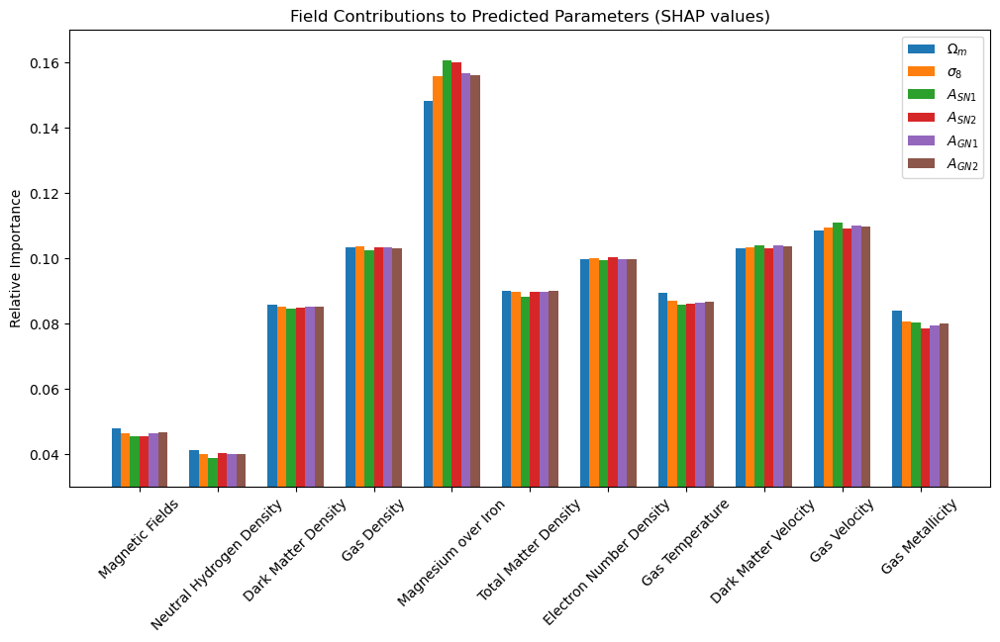

In [100]:
import matplotlib.pyplot as plt

bar_width = 0.12  
x = np.arange(len(map_names))  # Positions for each field

plt.figure(figsize=(12, 6))

# Loop through each parameter and plot bars side by side
for i in range(6):  
    plt.bar(x + i * bar_width, field_importance[:, i], width=bar_width, label=param_names[i])

# Set labels and title
plt.ylim(0.03, 0.17)
plt.xticks(x + (bar_width * 2.5), map_names, rotation=45)
plt.ylabel("Relative Importance")
plt.title("Field Contributions to Predicted Parameters (SHAP values)")
plt.legend()
plt.show()

We see that although each parameter is almost equally important to each field, there are some fields that are more important to predicting the parameters than others. i.e Magnesium/Iron, and Gas Velocity. This makes sense as 

In [93]:
expected_value = np.mean(model.predict(background_data), axis=0)
shap_values_per_field = np.mean(np.abs(shap_values), axis=(1, 2))  # Shape: (batch, 11, 6)
shap_values_per_field.shape

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step 


(50, 11, 6)

In [90]:
shap_values_per_field[0, :, 0].shape

(11,)